In [1]:
#import warnings
#warnings.filterwarnings("ignore") # to ignore the warnings

In [6]:
# installing the required libraries for the dashboard creation
!pip install hvplot panel




You should consider upgrading via the '/home/devendra/anaconda3/bin/python -m pip install --upgrade pip' command.


In [7]:
# Importing all the necessary packages

import pandas as pd # for dataframe handling

from sklearn.model_selection import train_test_split # to make the split on the dataframs

# Importing the models
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression

# End of models import

import matplotlib.pyplot as plt # for ploting graphs in the notebook
import numpy as np

import dateutil.parser # for handling the conversion of datetime formats
from datetime import timedelta # for operating the datetime objects

import panel as pn # for the dashboard panel
import hvplot.pandas # to make the dashboard responsive to interaction
import holoviews as hv # for dynamic operations in the dashboard

import scipy.stats as stats # used in anomaly test stat calculation
# End of imports

In [8]:
# This function will generate a dataframe out of a time series list

def time_to_df(list1, number_of_attributes = 3):
    '''
    This function will generate a dataframe out of a time series list
    
    :param list1: series to be passed in the form of list to generate the dataframe
    :param number_of_attributes: the number of attributes to be kept in the dataframe genarated
    :return: datafram
    '''
    df = pd.DataFrame(columns=range(number_of_attributes))
    
    for i in range(len(list1)-number_of_attributes+1):
        record = []
        
        for j in range(i,i+number_of_attributes):
            record.append(list1[j])
            
        df.loc[len(df.index)] = record
                
    return df

# This function trains the model using the input data(dataframe)

def train_and_forecast(list1, model_class_object, number_of_forecast = 5, number_of_attributes = 3):
    '''
    This function trains the model using the input data(dataframe)
    
    :param list1: series to be passed in the form of list to generate the dataframe
    :param model_class_object: object of model after initialization to use for forscasting
    :param number_of_forecast: The number of forecaste to be done and returned
    :param number_of_attributes: the number of attributes to be kept in the dataframe genarated
    :return: list of forcasted values and trained model
    '''
    input1 = time_to_df(list1, number_of_attributes)
    
    # We take last column of the features as target and rest are taken as attributes
    featureMat = input1.iloc[:, : len(input1.columns) - 1]
    label = input1[input1.columns[-1]]
    train_features, test_features, train_res, test_res= train_test_split(featureMat,label)
    
    # Here we are using linear regression model
    model = model_class_object
    model.fit(train_features, train_res)
    
    # storing the forcasted values
    forecasted_values = []
    
    for i in range(number_of_forecast):
        
        features_for_forecast = list1[-number_of_attributes+1:]
        forecasted_value = int(model.predict([features_for_forecast])[0]*10)/10
        forecasted_values.append(forecasted_value)
        
        # Every forcasted value will be appended and used as a feature value for next forecast
        list1.append(forecasted_value)
        
    #print("Forcasted values: ", forecasted_values)
    return forecasted_values, model

# This function will perform the back test of the forecasting model on the given time series.

def back_test(list1, trained_model, number_of_attributes):
    '''
    This function will perform the back test of the forecasting model on the given time series.
    
    :param list1: series to be passed in the form of list on which the model will be tested
    :param trained_model: The trained model
    :param number_of_attributes: the number of attributes on which the model is trained
    :return: list of forecasted values for the time series 
    '''
    back_test_preds = []
    
    # Filling the initial value where forecast is not possible by the given values of the series itself
    for k in range(number_of_attributes-1):
        back_test_preds.append(list1[k])
    
    # Forecasting and storing values from the begining of the series using trained model
    for i in range(len(list1)-number_of_attributes+1):
        forecasted_value = int(trained_model.predict([list1[i:i+number_of_attributes-1]])[0]*10)/10
        back_test_preds.append(forecasted_value)
            
    return back_test_preds
    

# This function calculates the test_states for the GESD testing
def calculate_test_stat(y, iteration):
    '''
    This function calculates the test_states for the GESD testing
    
    :param y: Series on which GESD testing is being done.
    :param iteration: State for which iteration the value is being calculated
    :return: maximum deviation, index of point with maximum deviation, the value of that point
    '''
    std_dev = np.std(y) # standard deviation of the series
    avg_y = np.mean(y) # mean of the series
    abs_val_minus_avg = abs(y - avg_y) # Distance of values(in series) from the mean
    max_of_deviations = max(abs_val_minus_avg) # maximum distance
    max_ind = np.argmax(abs_val_minus_avg) # index of the point having maximam deviation
    cal = max_of_deviations/ std_dev # calculation of devaite in terms of std.dev
    
    return cal, max_ind,y[max_ind]

# This function calculates the critical value which needs to be compared with the test state to check hypothesis
def calculate_critical_value(size, alpha, iteration):
    '''
    This function calculates the critical value which needs to be compared with the test state to check hypothesis
    
    :param size: Size of the series
    :param alpha: Significant value 
    :param iteration: State for which iteration the value is being calculated
    :return: critical value
    '''
    t_dist = stats.t.ppf(1 - alpha / (2 * size), size - 2)
    numerator = (size - 1) * np.sqrt(np.square(t_dist))
    denominator = np.sqrt(size) * np.sqrt(size - 2 + np.square(t_dist))
    critical_value = numerator / denominator
    return critical_value

# Calculating Anomaly using GESD testing 
def GESD(attribute, alpha, frame_of_detection):
    '''
    Calculating Anomaly using GESD testing 
    
    :param attribute: the attribute on which the GESD needs to be applied
    :param alpha: Significant value for calculating the critical value of the test
    :param frame_of_detection: the frame in which the extreme outlier or the anomaly needs to be detected
    :return: List of the indices for anomalies
    '''
    input_series = list(attribute)
    stats = []
    critical_vals = []
    anomily_list_index = []
    for iterations in range(1, frame_of_detection + 1):
        stat, max_index, max_index_value = calculate_test_stat(input_series, iterations) # calculating the test state
        critical = calculate_critical_value(len(input_series), alpha, iterations) # calculating the critical value
        input_series = np.delete(input_series, max_index) 
        
        critical_vals.append(critical)
        stats.append(stat)
        
        # testing the hypothesis
        if stat > critical:
            max_i = iterations
            
            anomily_list_index.append(attribute.index(max_index_value)) # appending the extreme outlier as anomaly
        
    
    return anomily_list_index




Working on  PFE.csv  dataset for anomalies.


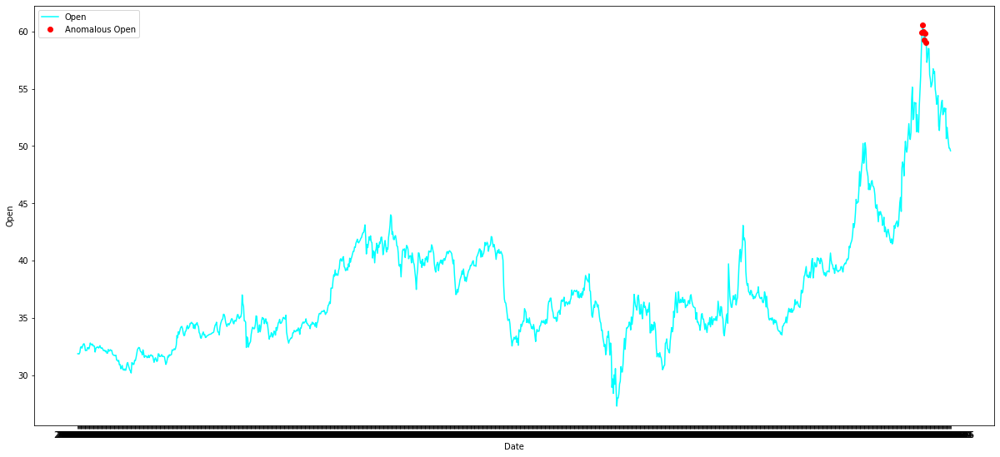

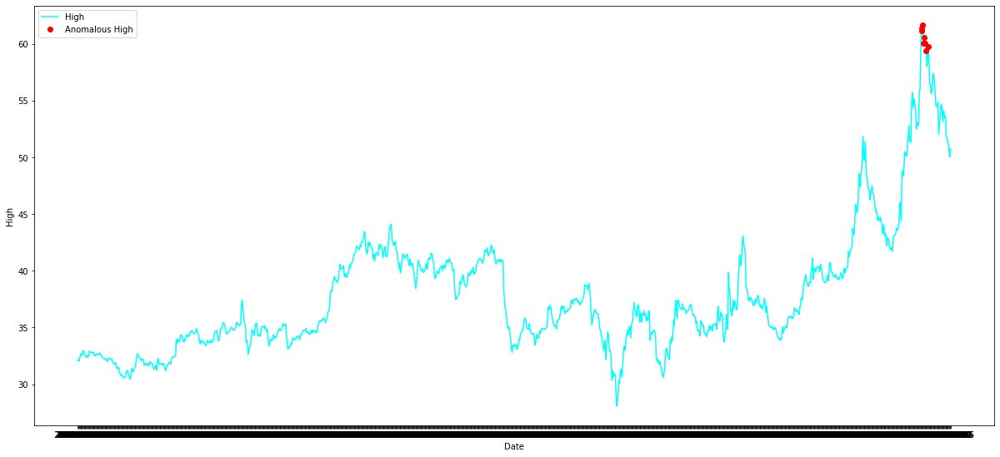

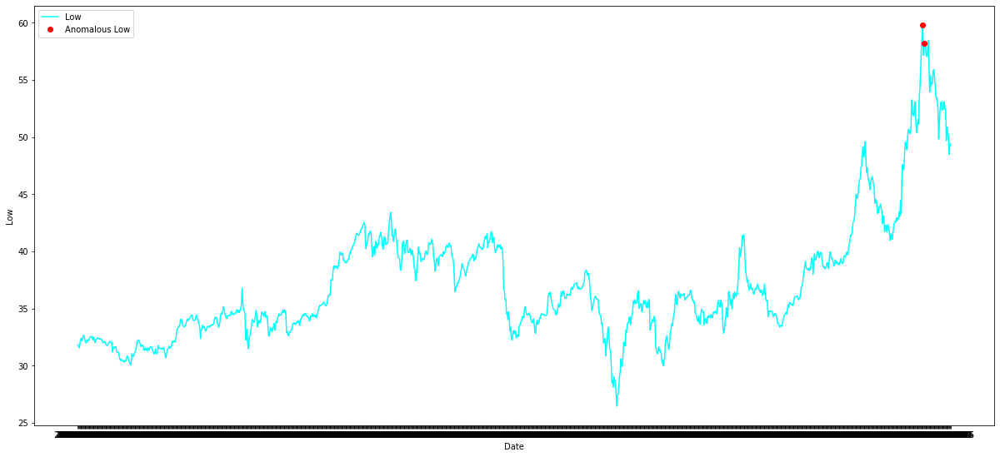

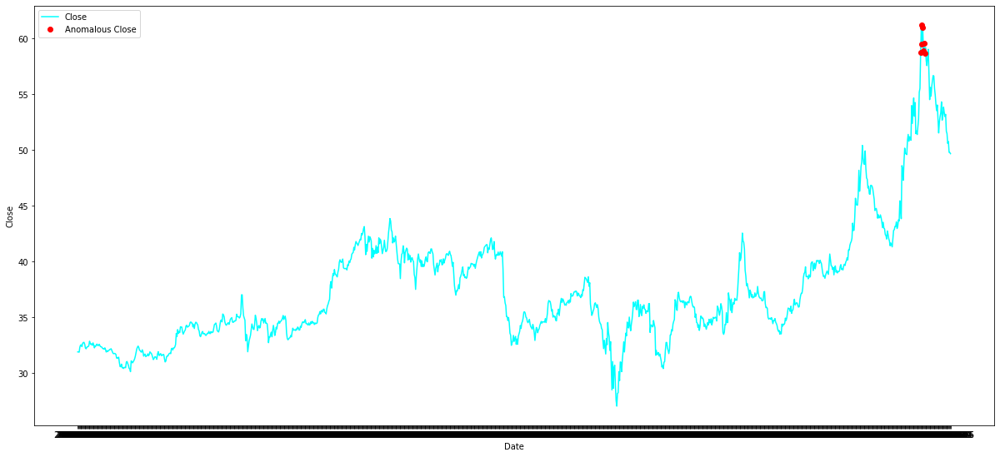

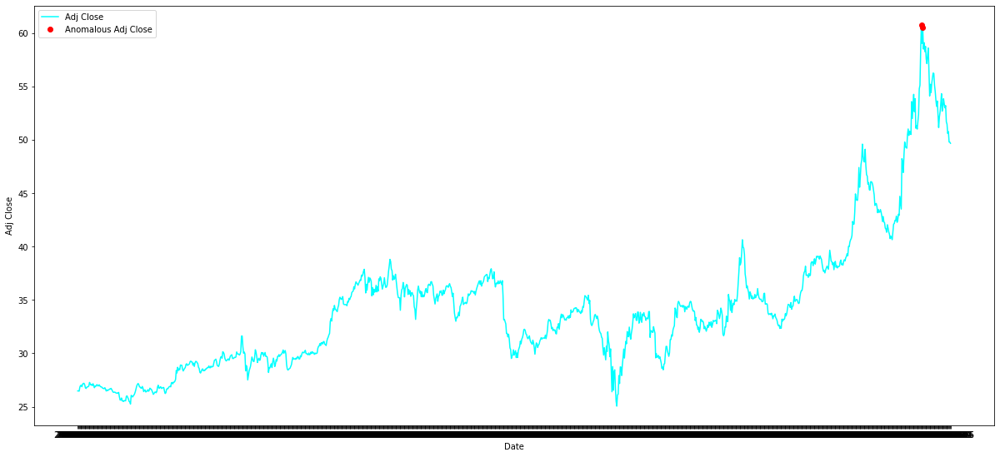

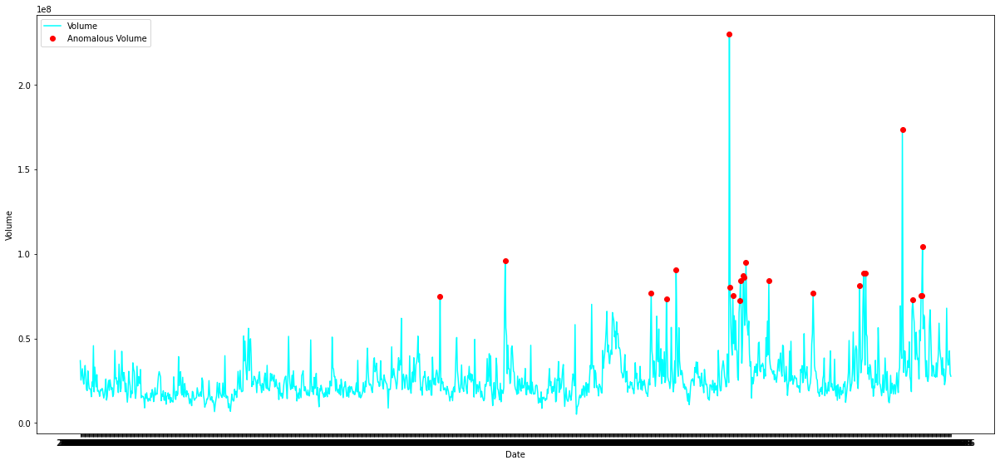

Working on  SPOT.csv  dataset for anomalies.


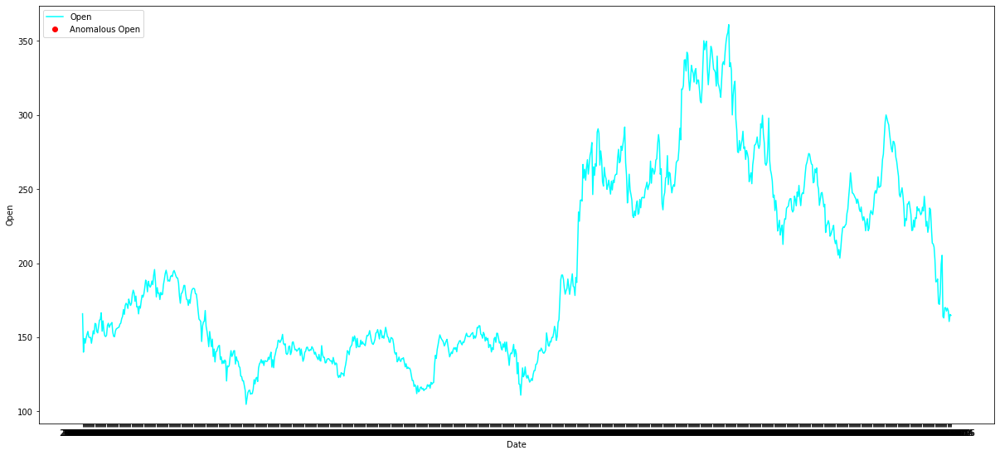

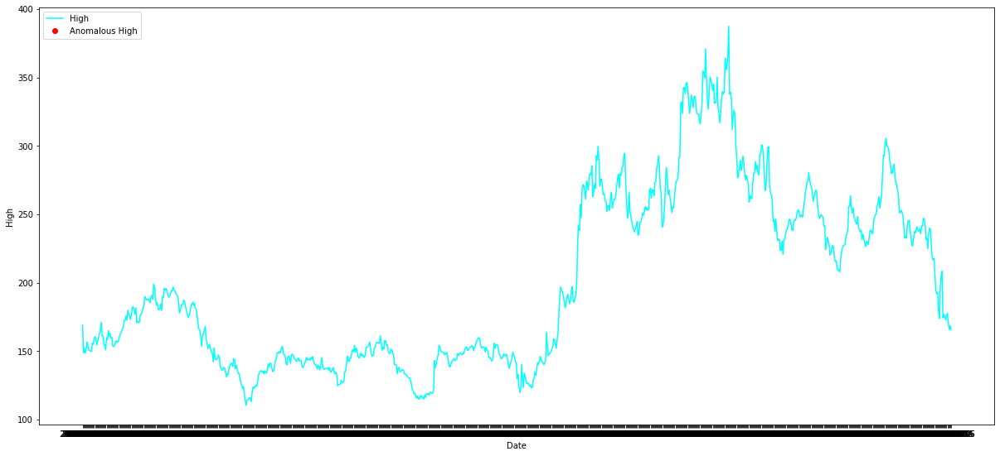

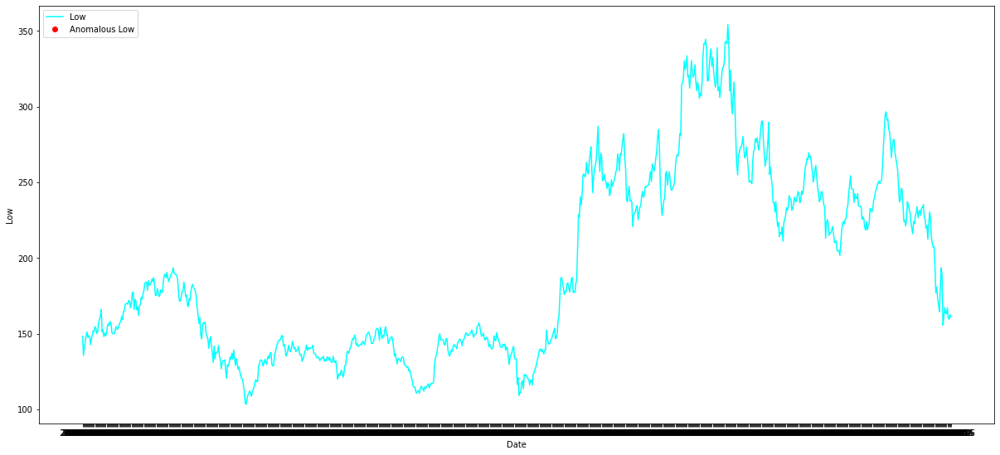

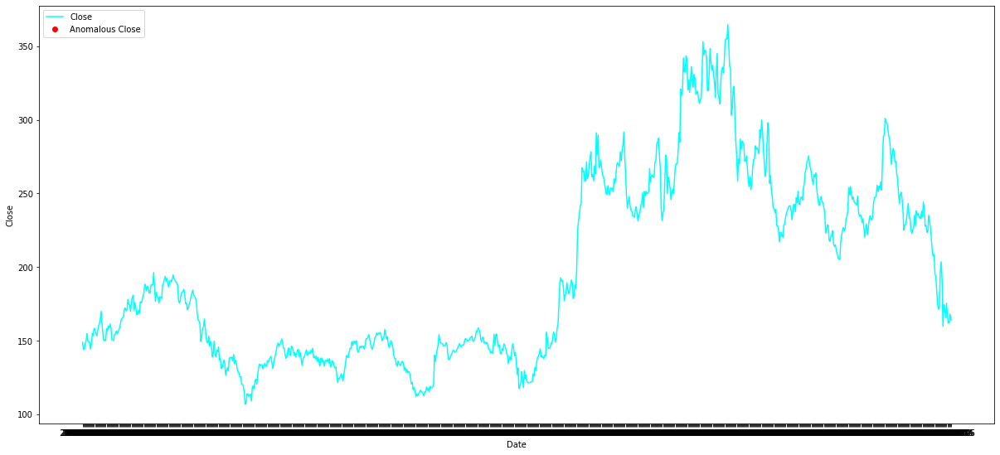

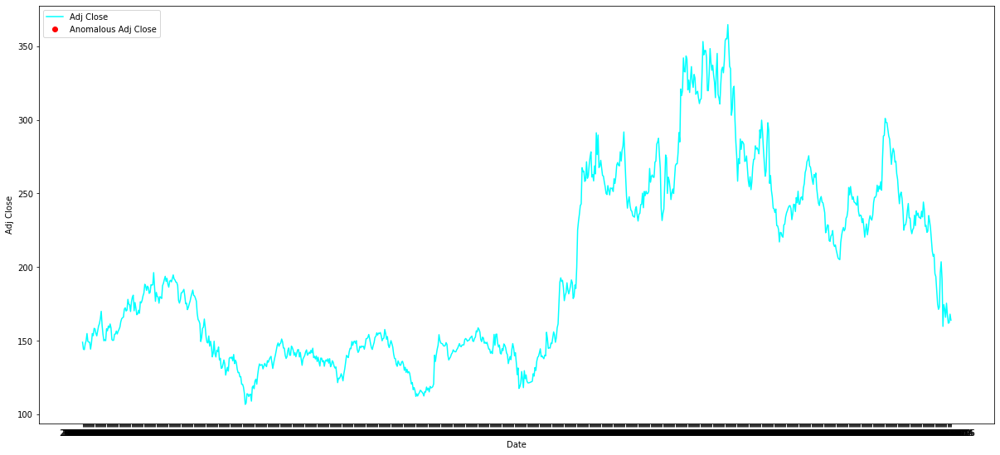

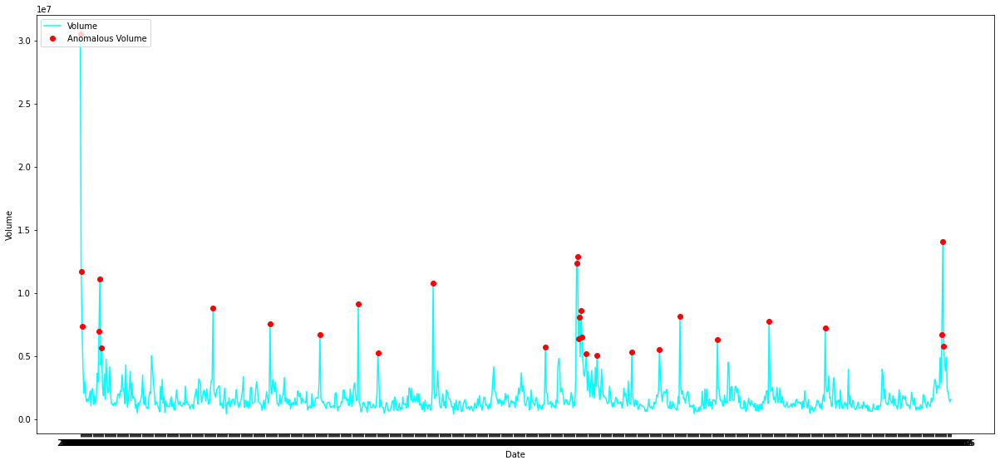

Working on  TSLA.csv  dataset for anomalies.


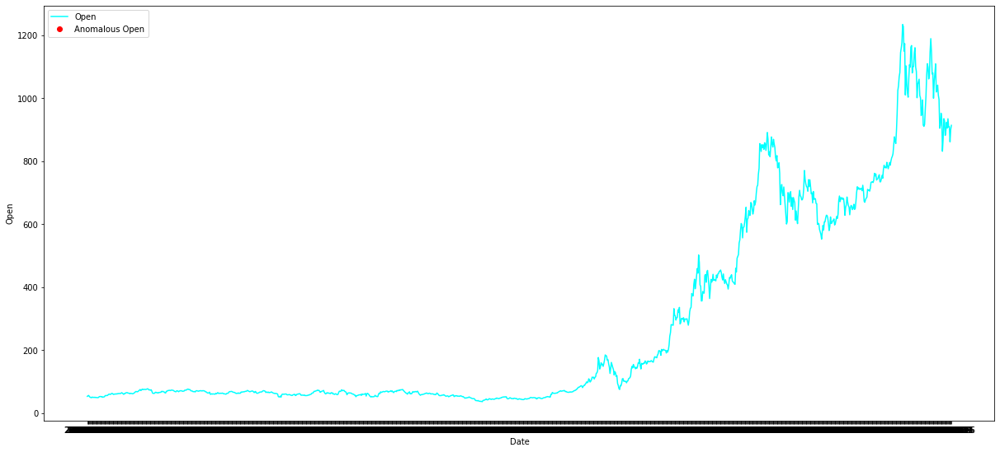

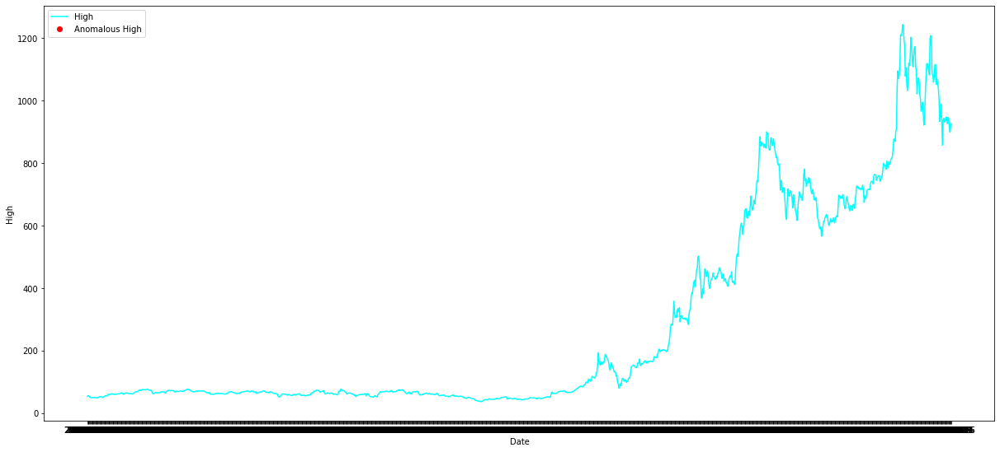

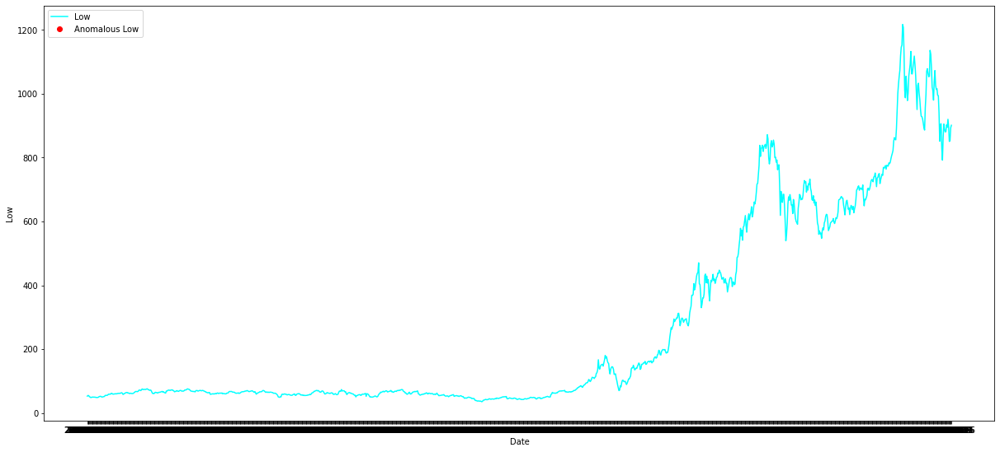

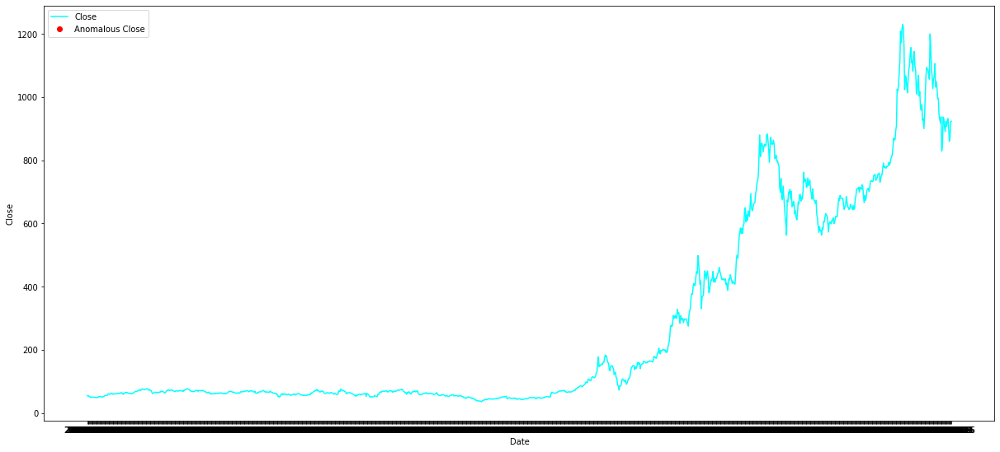

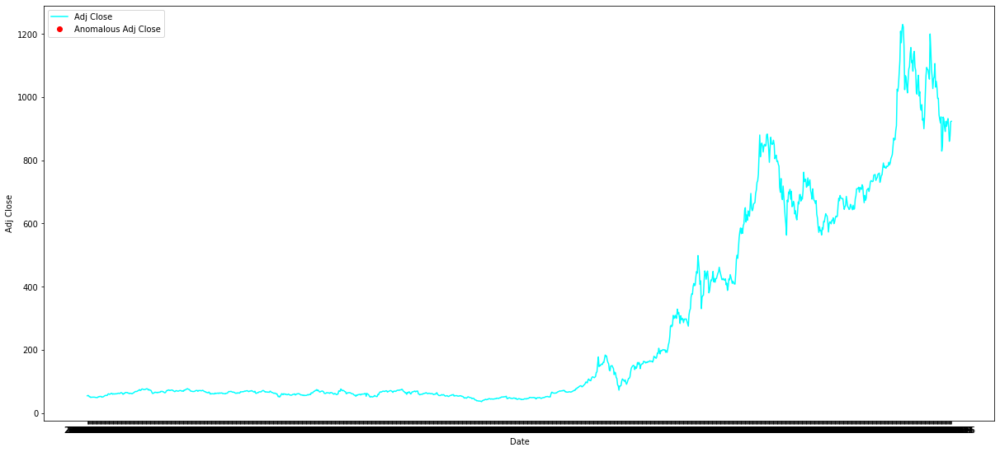

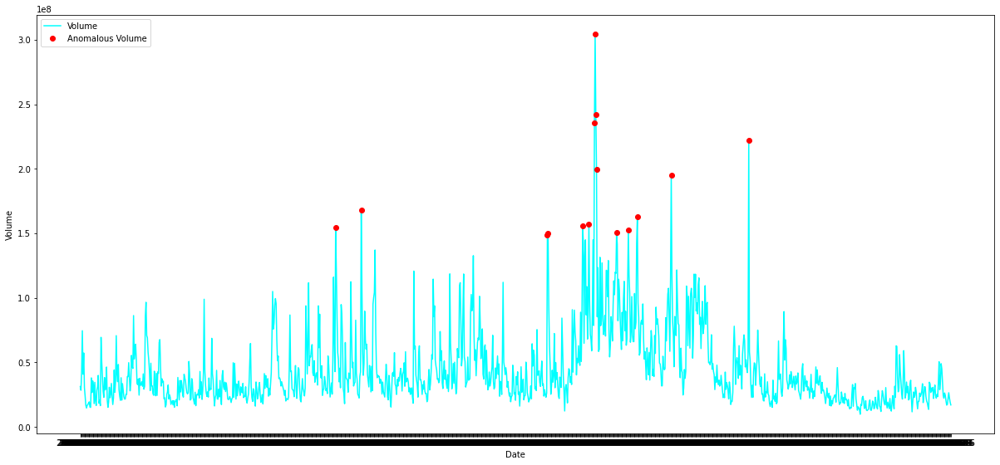

In [9]:
# working on the anomalies detection to look into the behaviour of stock in the frame of 30 days

datafiles = ["PFE.csv","SPOT.csv","TSLA.csv"] # names of the data files along with the address
company_names = ["Pfizer", "Spotify", "Tesla"] # names of the companies corresponding to the data files.

for file in datafiles: # Working of the datafiles one by one
    data = pd.read_csv(file) # reading the file
    print("Working on ",file, " dataset for anomalies.",)

    anomaly ={} # dictionary storing the indices of the the anomalies and attribute name for the data file as key- value pair
    
    for i in data.columns.to_list():
        
        #checking the anomalies column by column
        if i != "Date": # skipping the "Date" attribute
            columns_value = data[i].to_list()
            anom_index_list = GESD(columns_value, alpha = 0.05, frame_of_detection = 30) # running the anomaly test

            if len(anom_index_list)>0: # checking if there is anomaly
                anomaly[i] = anom_index_list
            
            
            # ploting the anomalies on the attributes
            fig = plt.figure(figsize =(16, 7))
            ax = fig.add_axes([0,0,1,1])

            date_list = data["Date"].to_list()
            values_for_attribute = data[i]
            
            anomaly_date_list = data.iloc[anom_index_list]["Date"]
            anomaly_vale_list = data.iloc[anom_index_list][i]
            
            ax.plot(date_list, values_for_attribute,'-',color='cyan', label = i)
            ax.plot(anomaly_date_list, anomaly_vale_list,'o',color='red', label = "Anomalous "+i)
            ax.legend(loc="upper left")

            ax.set_ylabel(i)
            ax.set_xlabel("Date")
            ax.set_xticks(date_list)
            ax.set_xticklabels(date_list)

            plt.show()
            # end of ploting
        

Working on  PFE.csv  dataset
Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


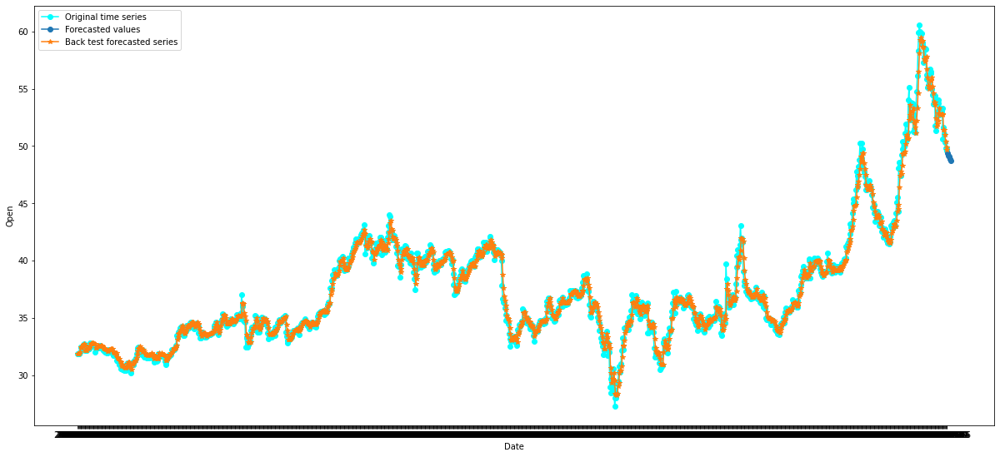

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


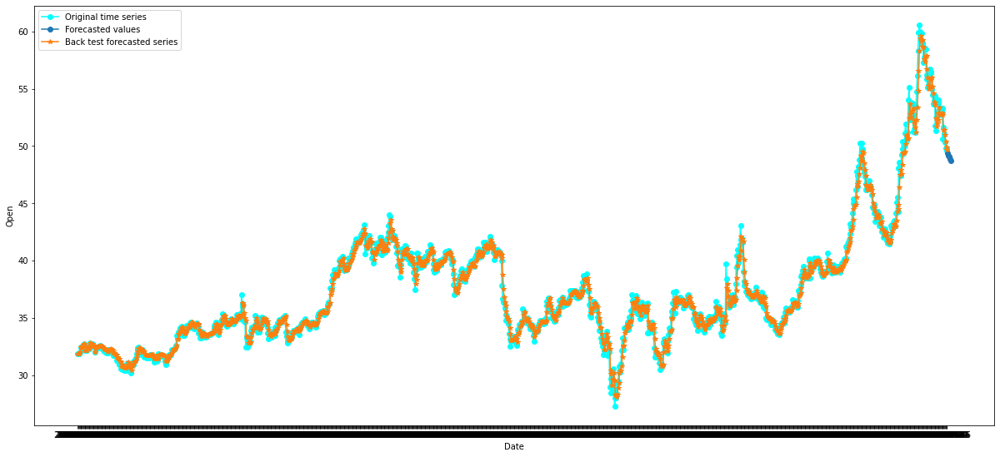

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


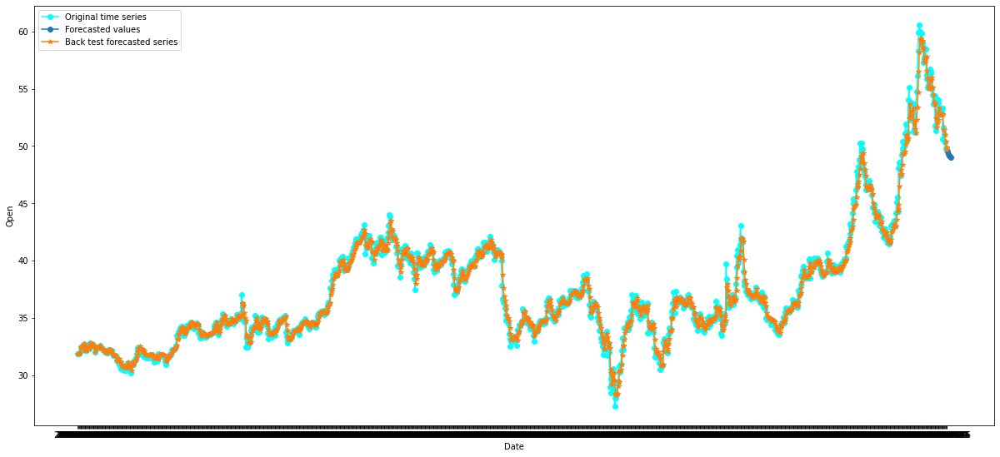

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


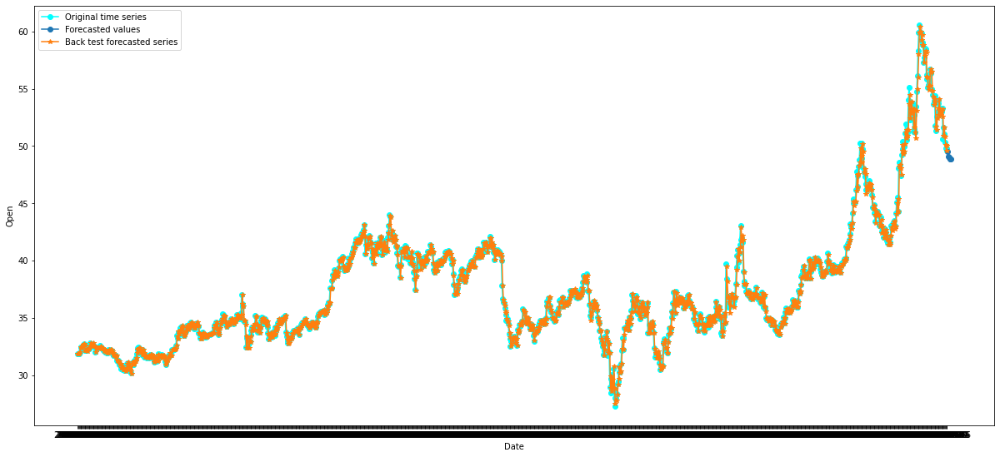

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


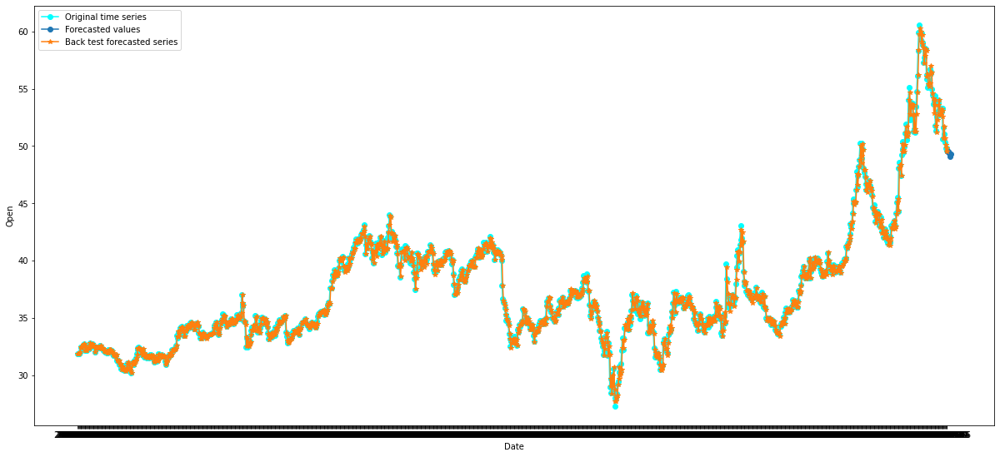

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


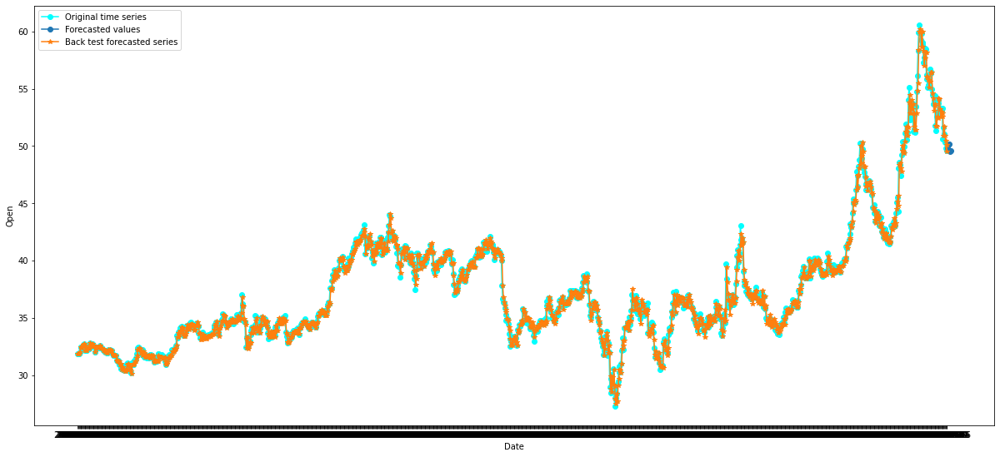

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


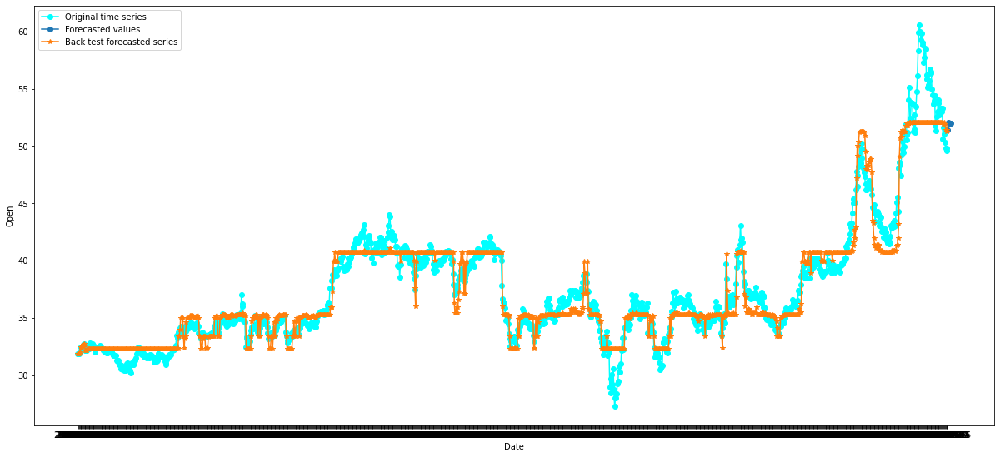

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


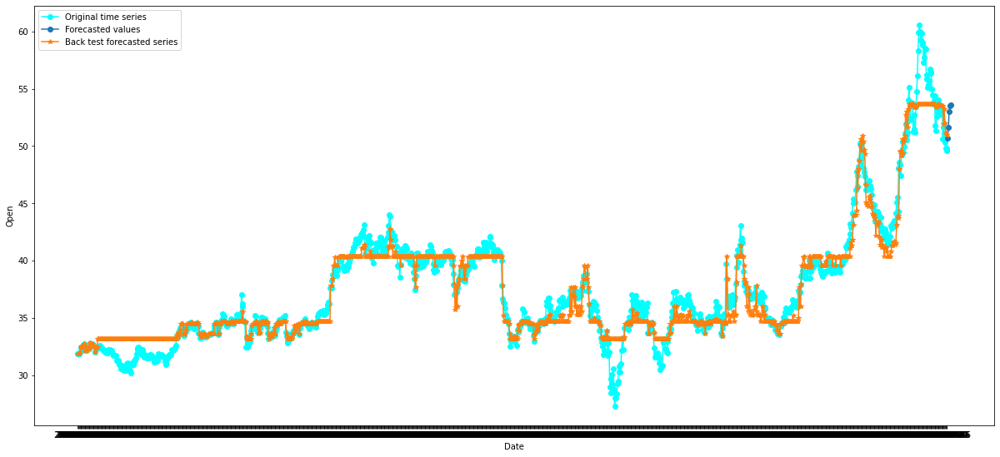

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


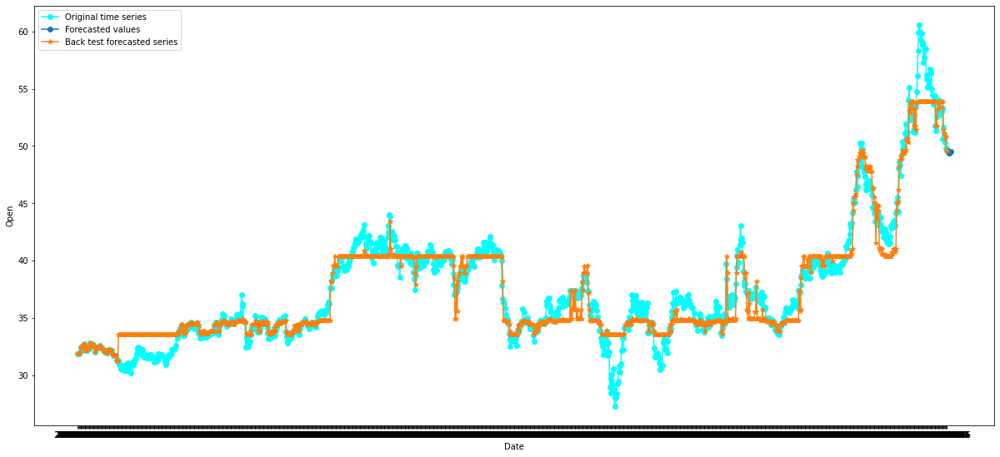

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


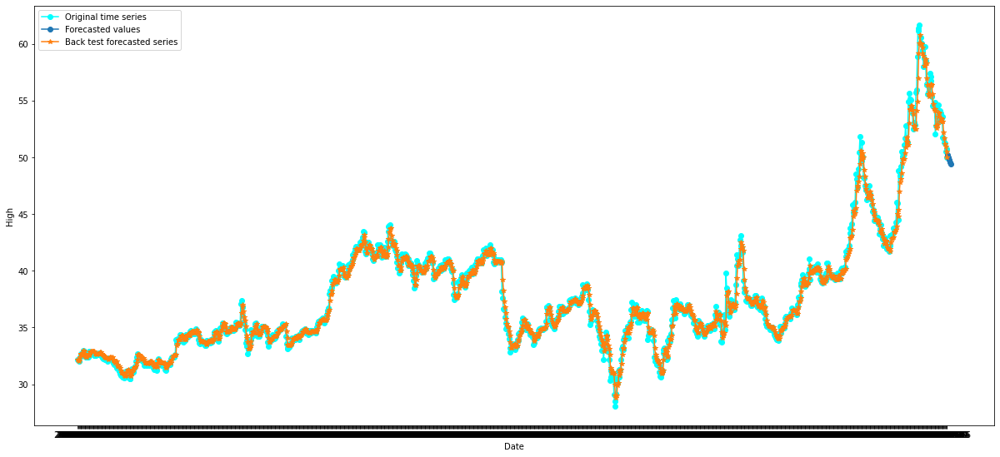

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


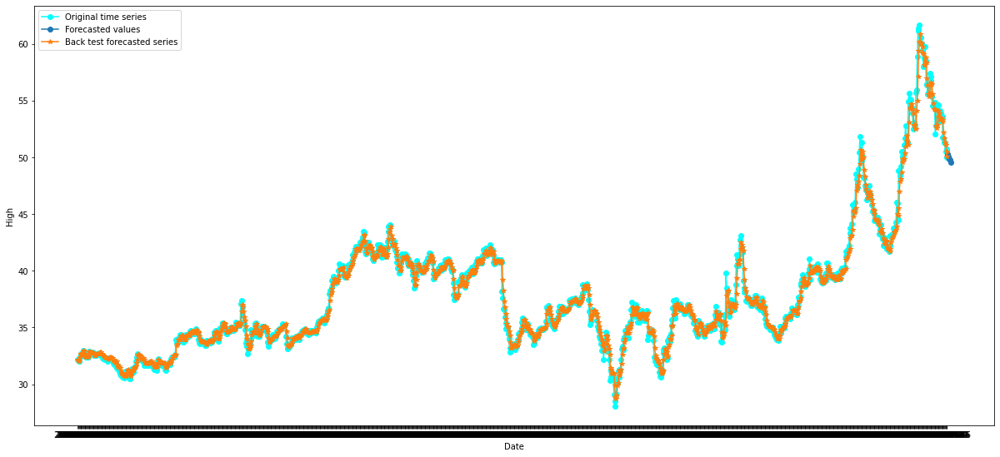

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


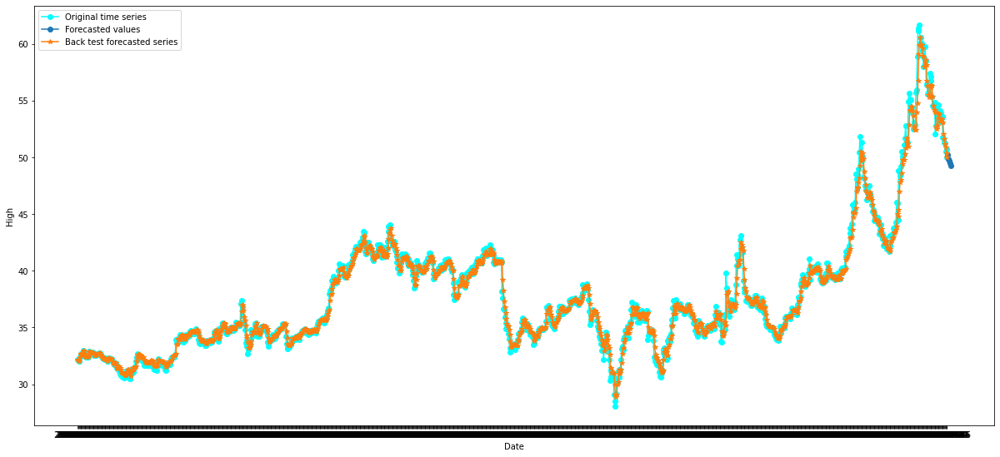

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


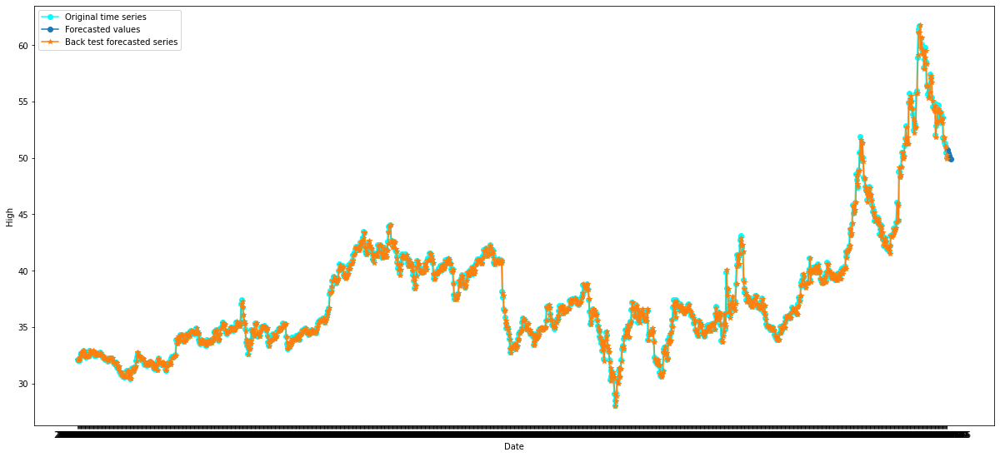

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


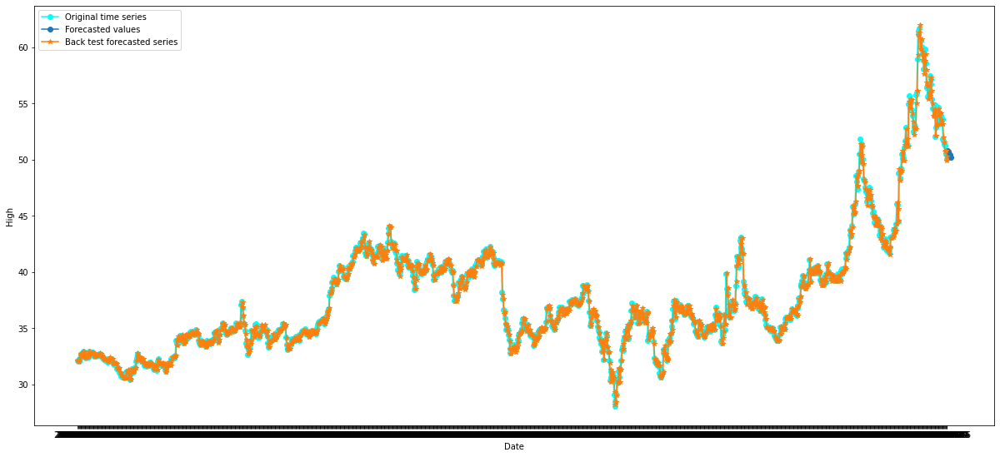

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


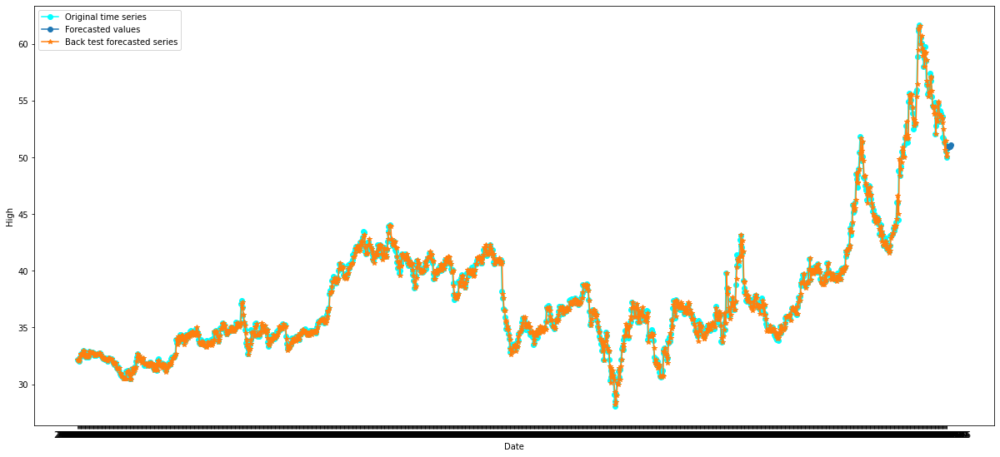

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


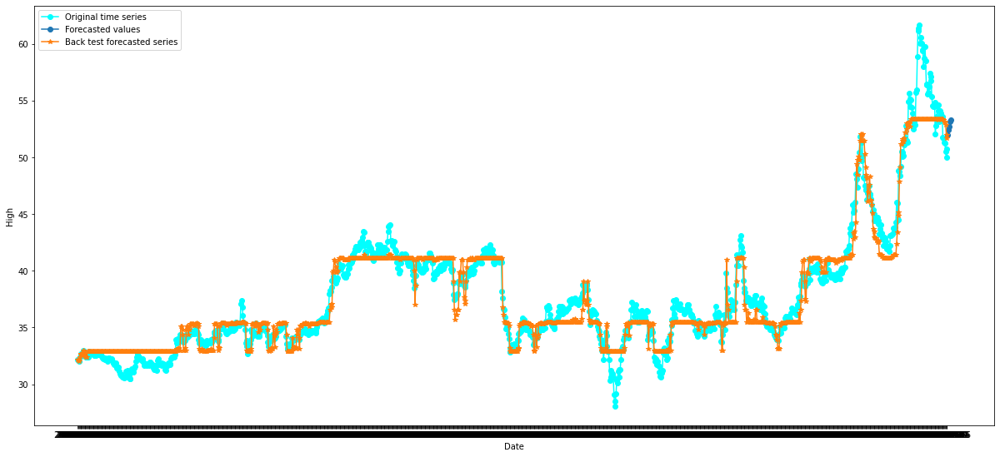

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


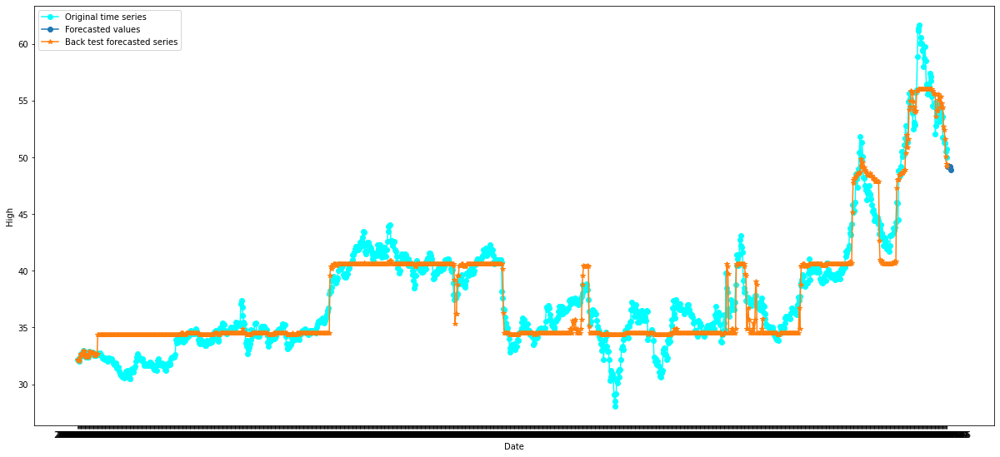

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


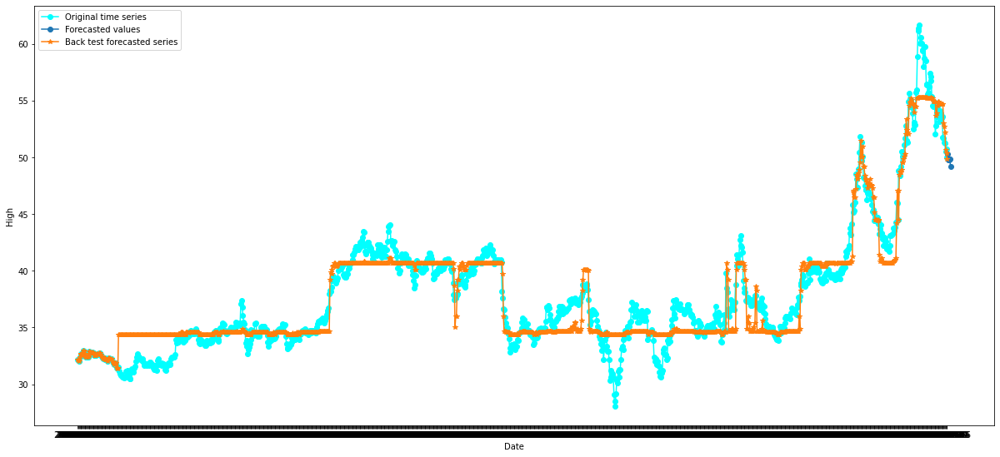

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


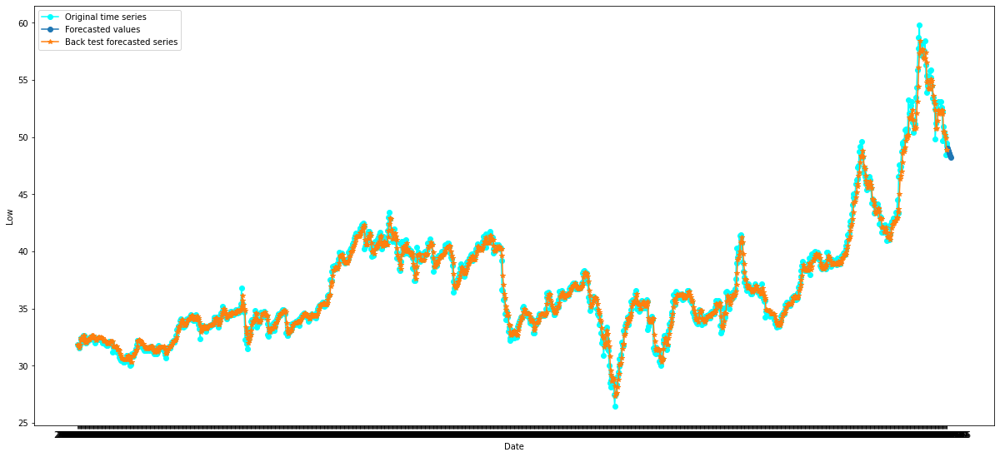

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


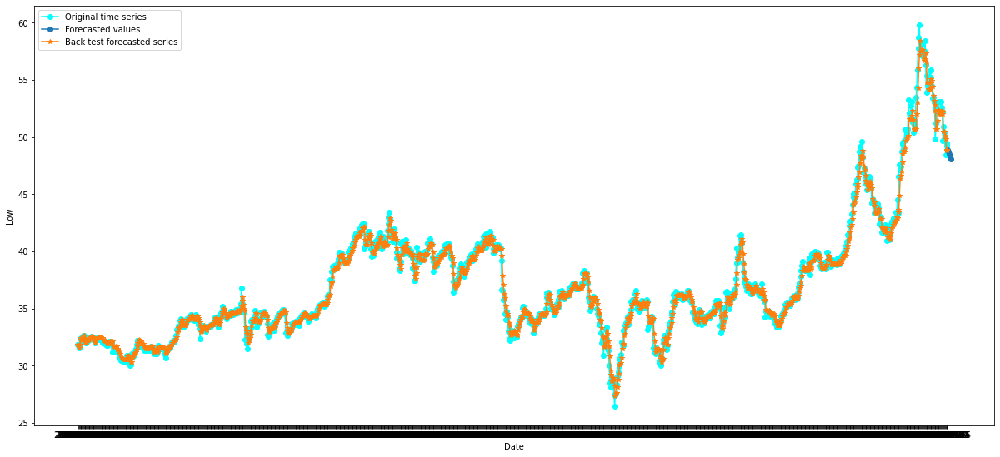

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


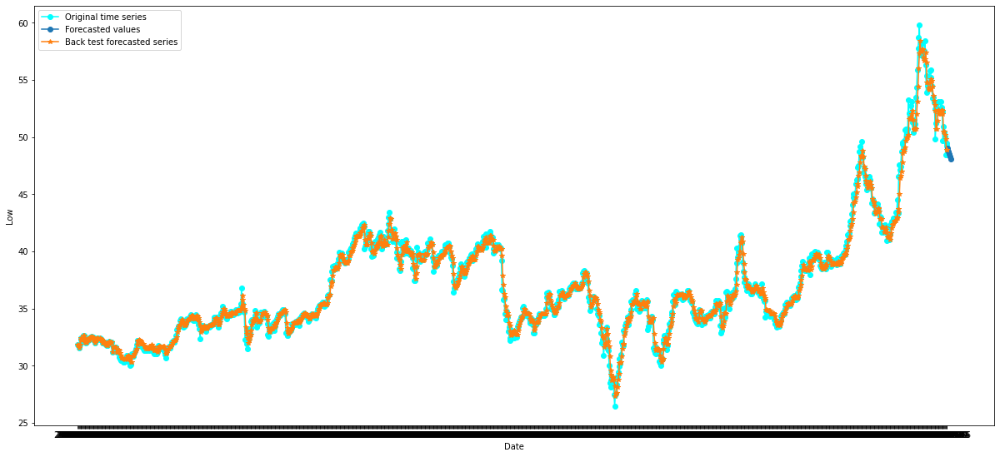

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


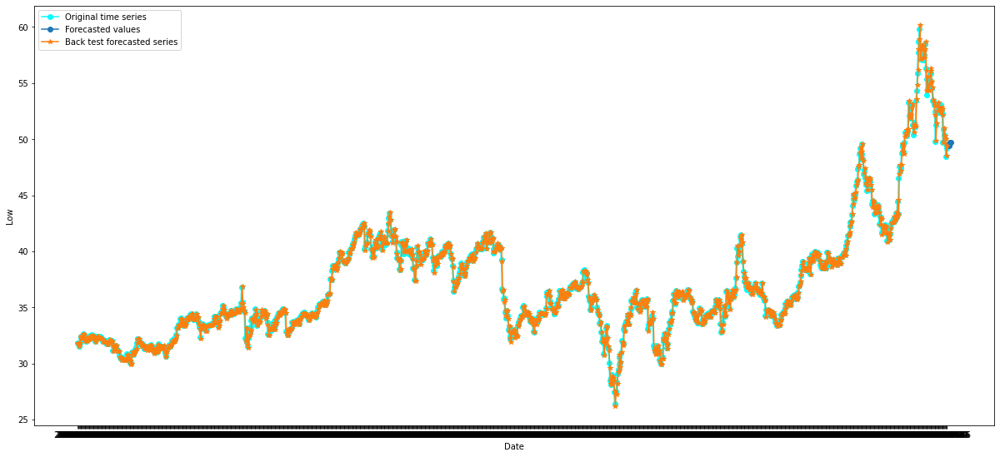

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


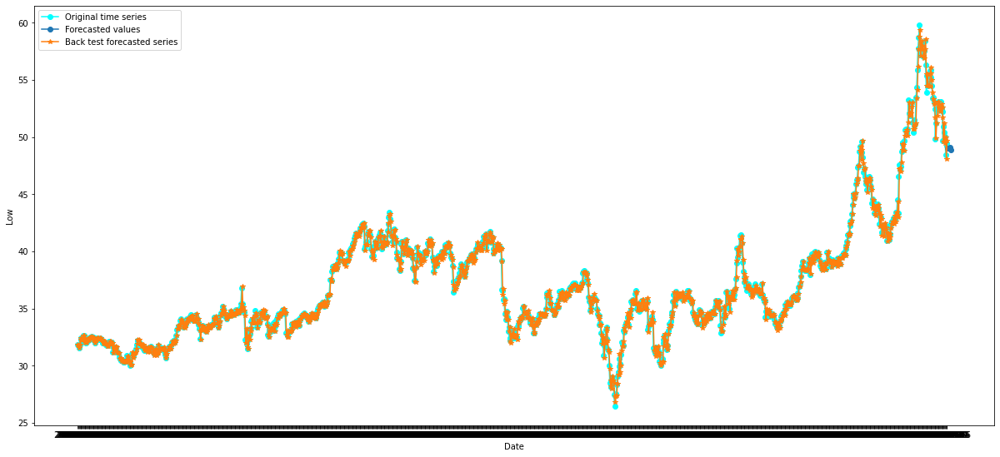

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


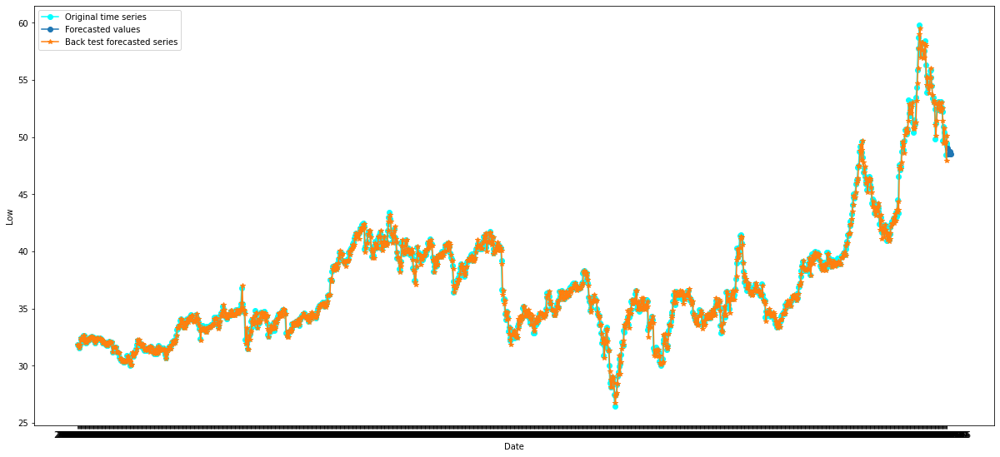

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


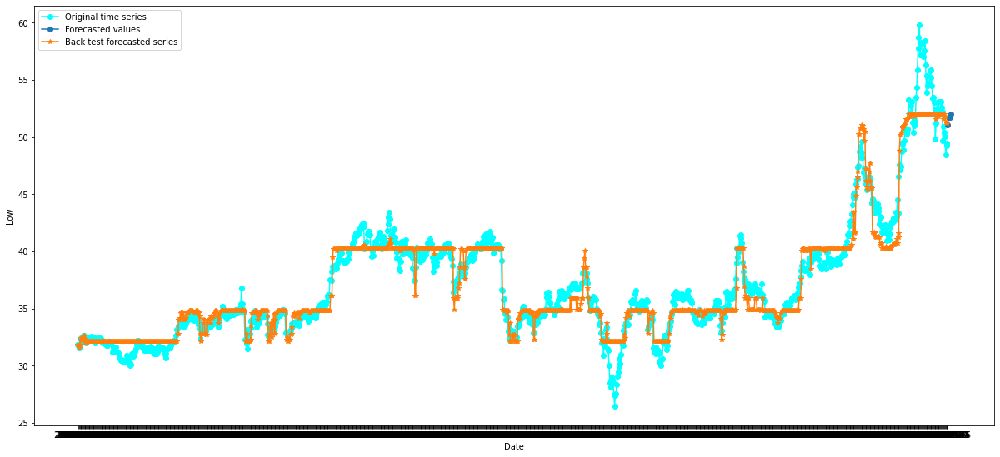

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


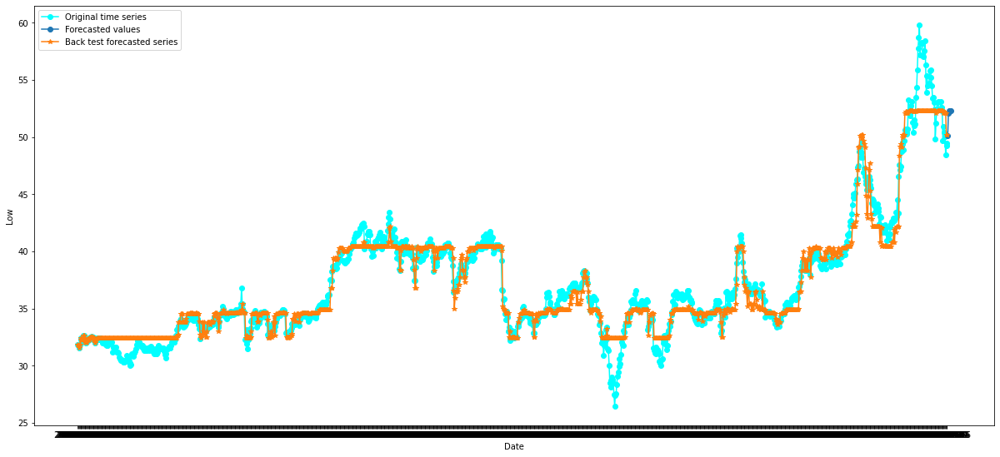

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


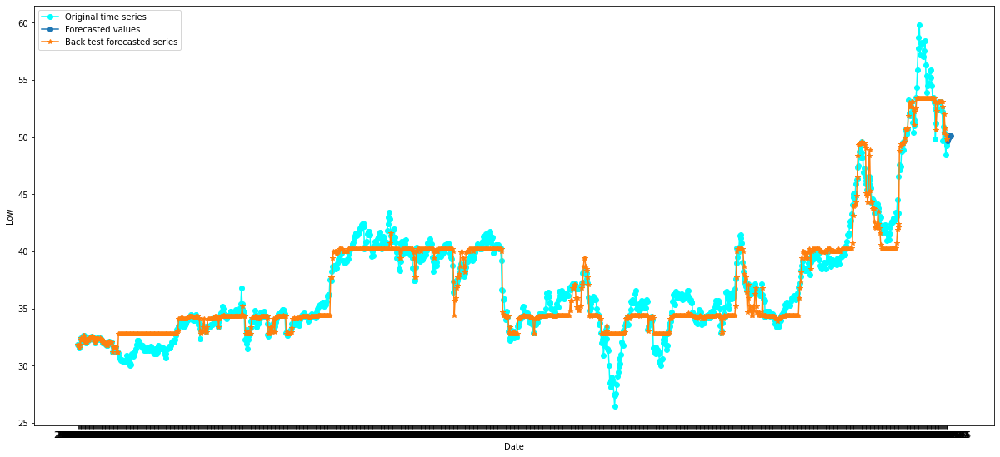

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


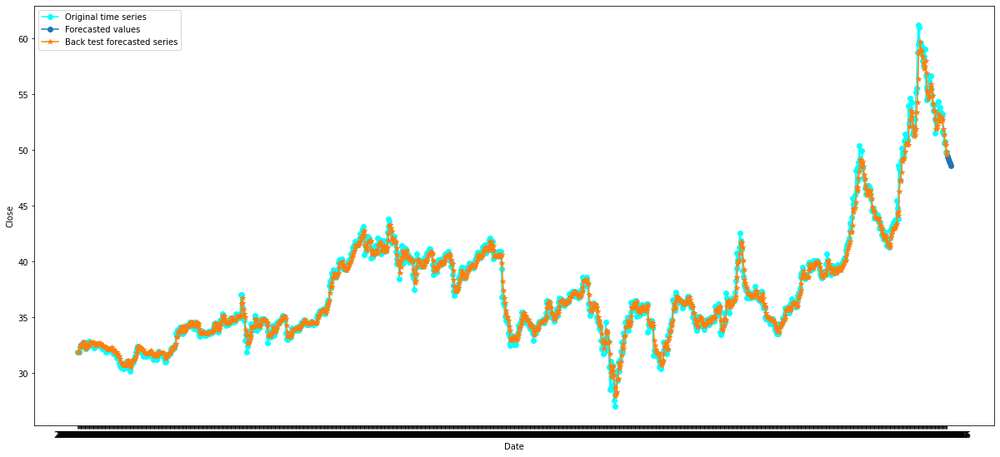

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


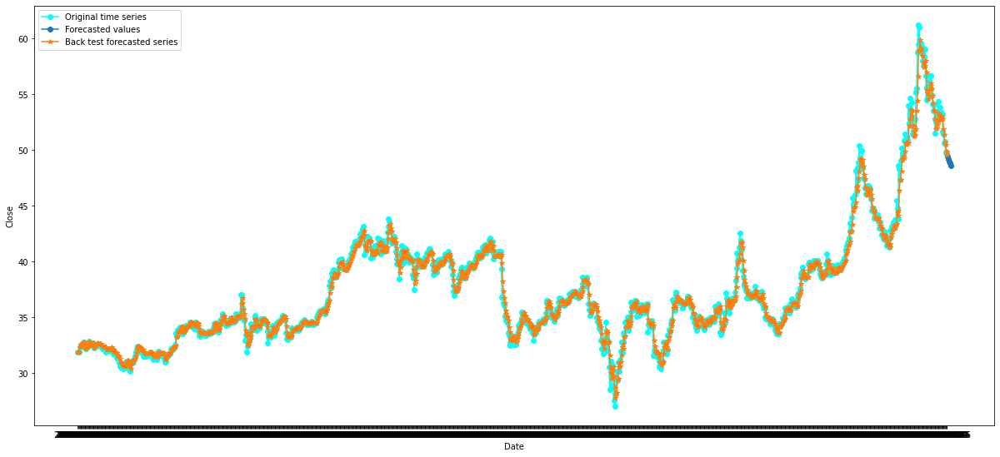

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


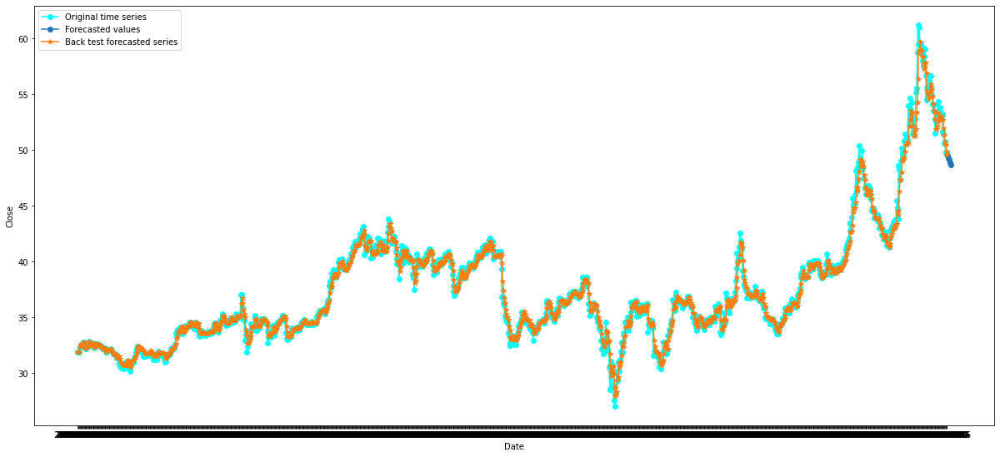

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


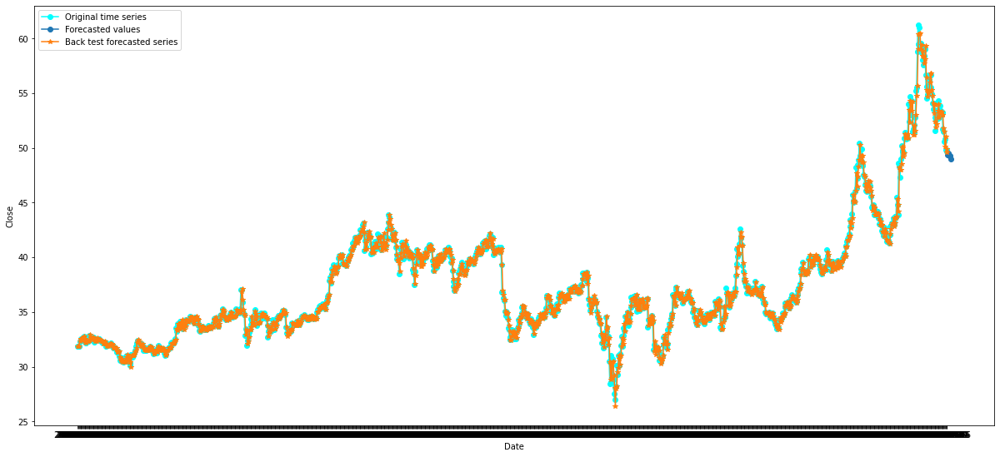

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


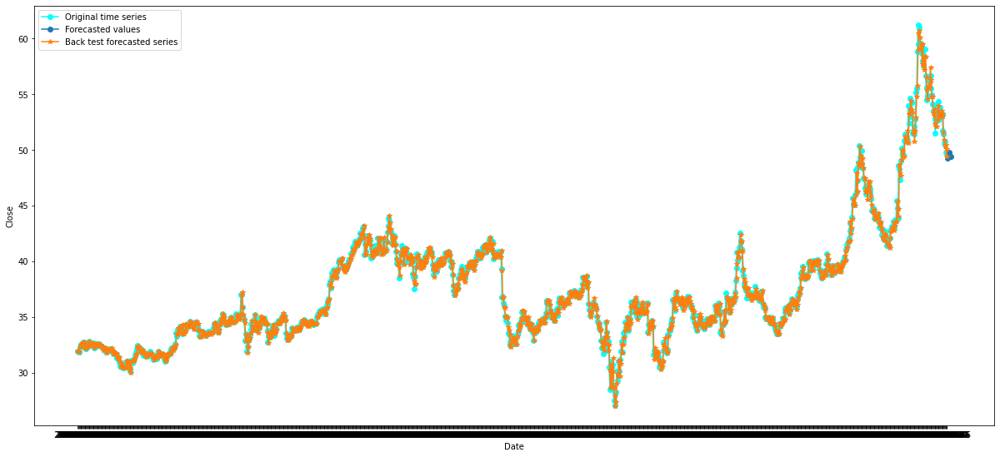

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


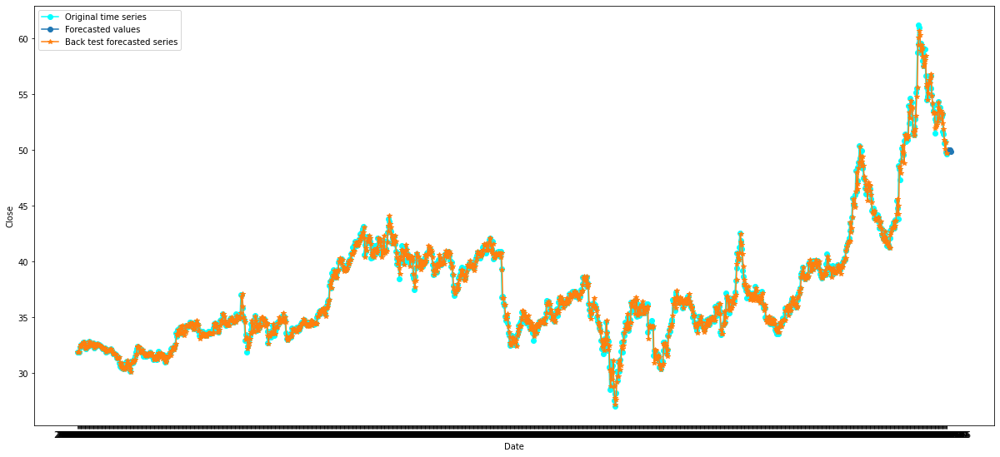

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


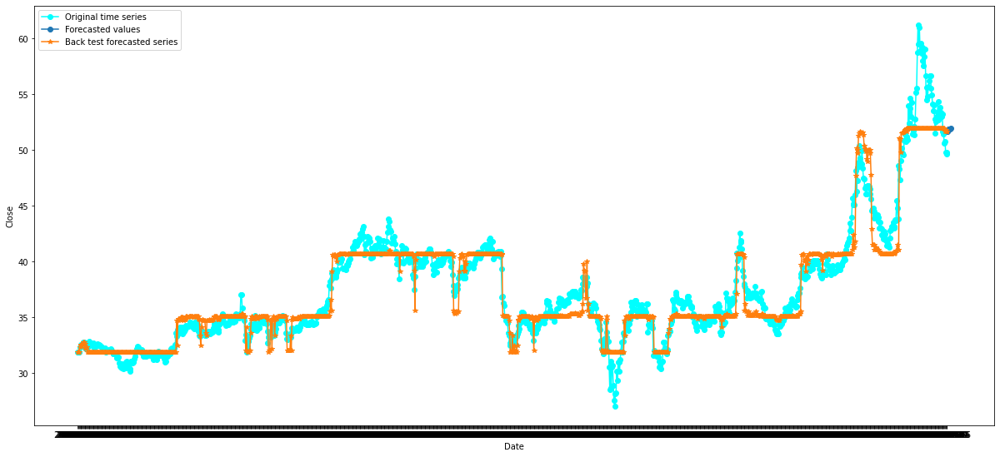

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


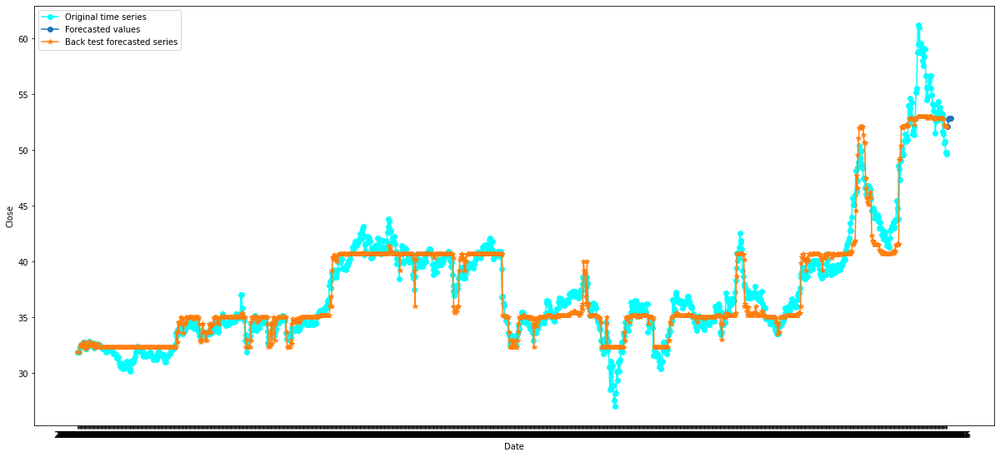

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


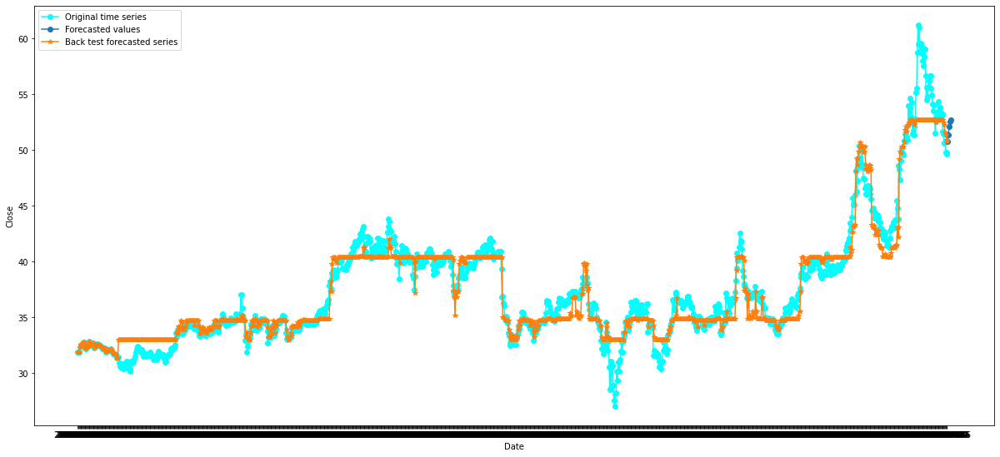

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


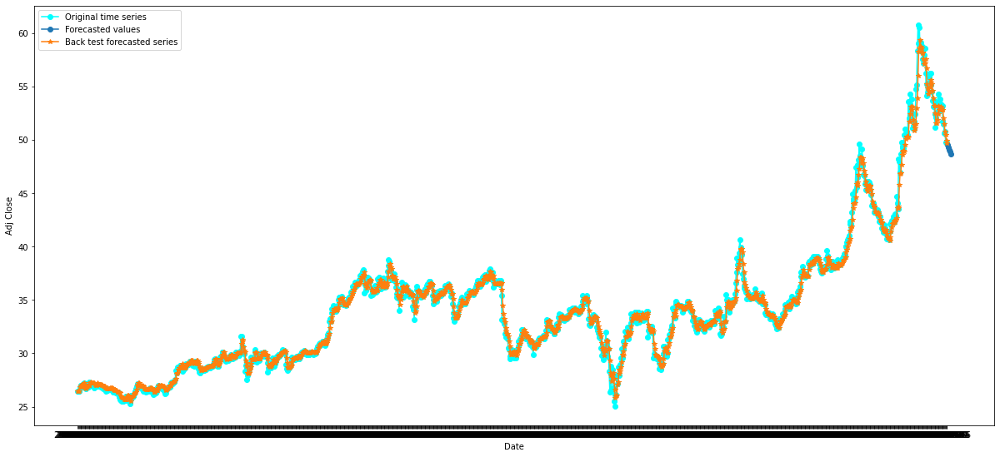

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


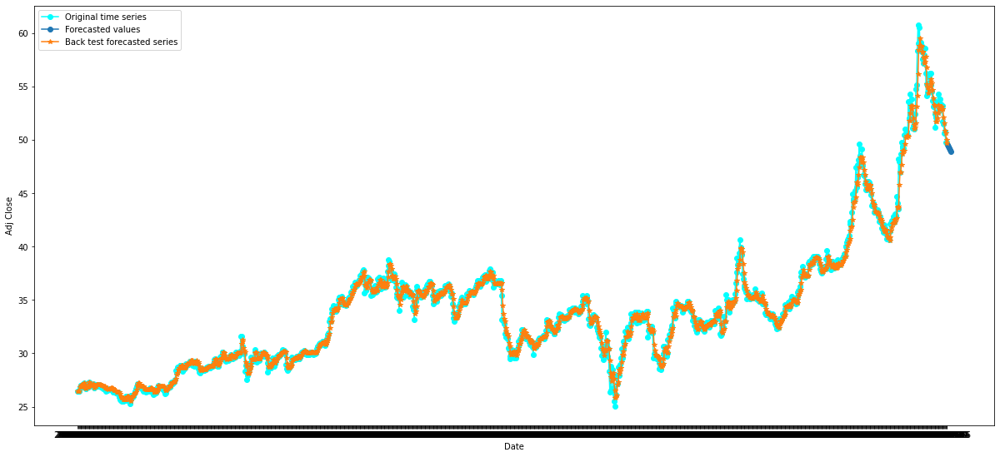

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


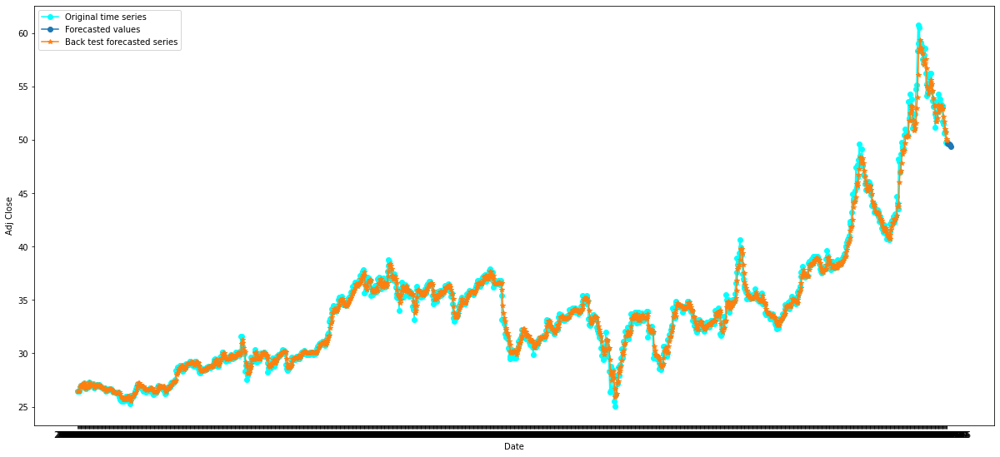

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


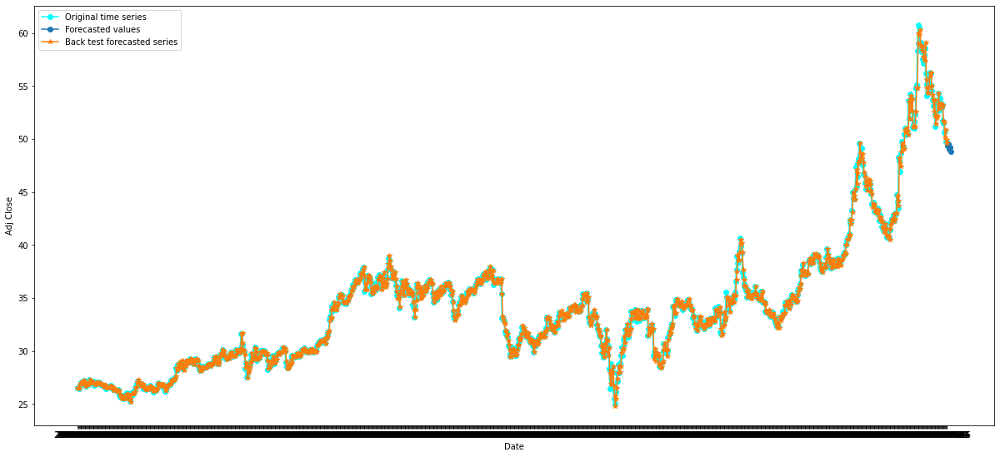

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


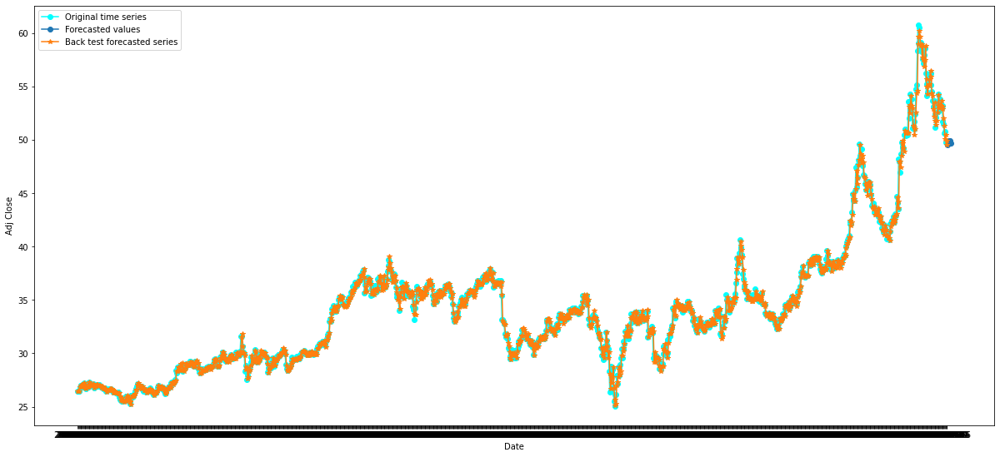

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


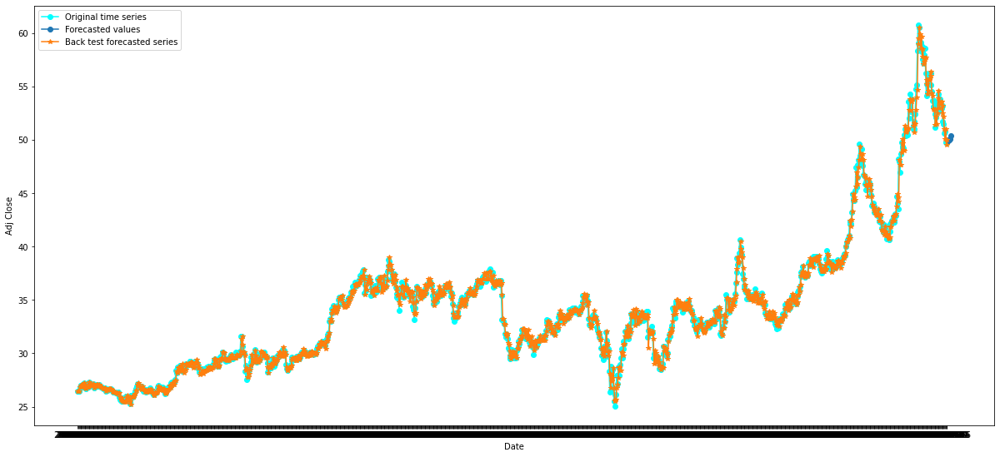

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


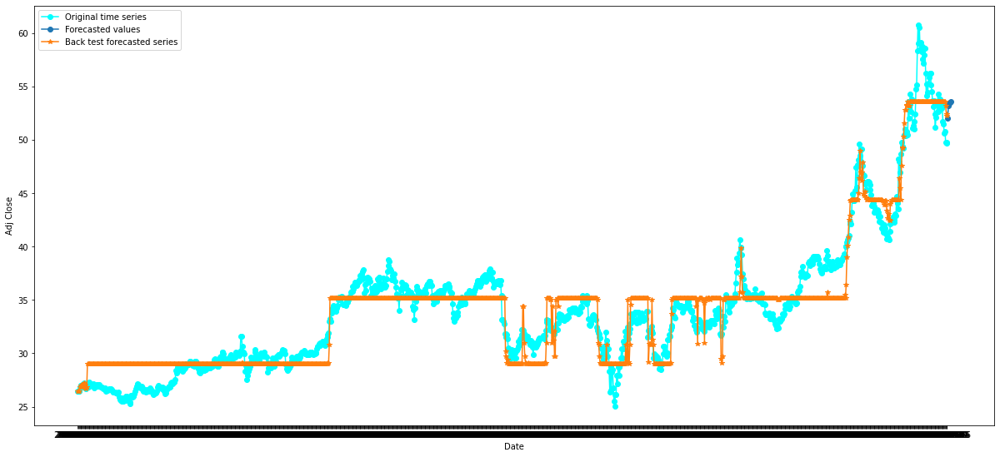

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


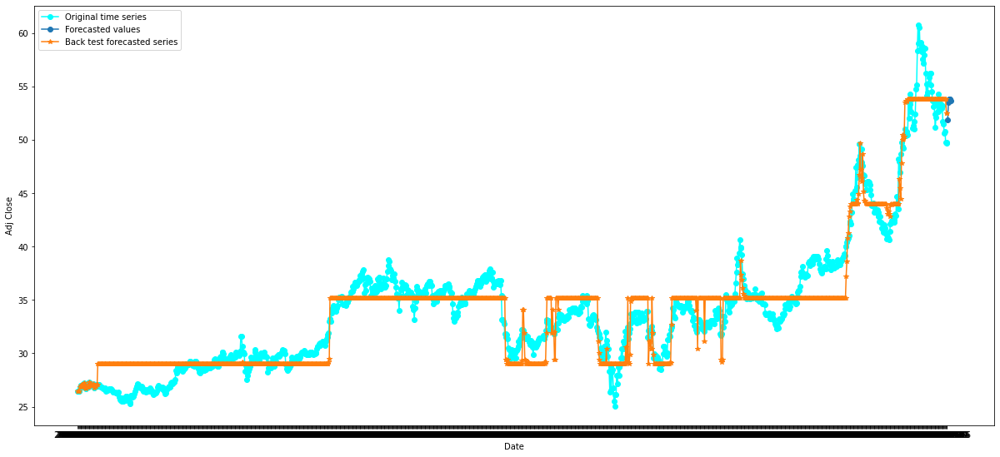

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


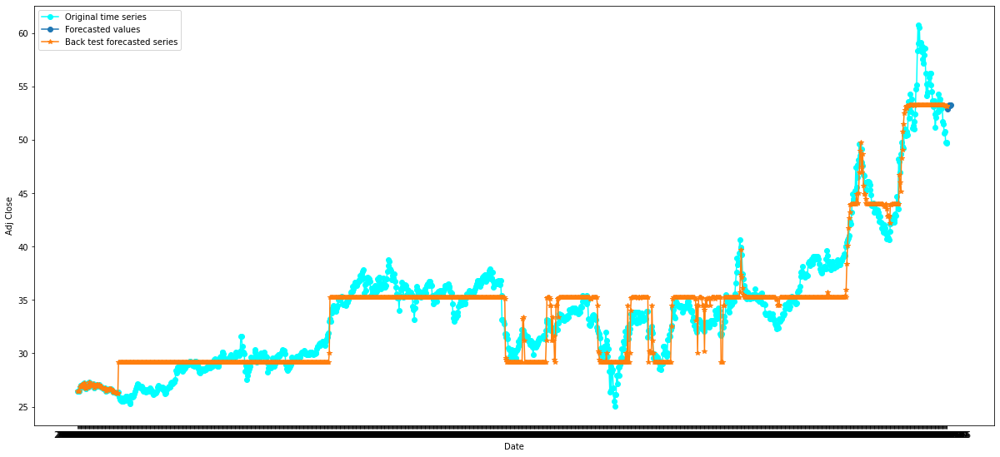

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


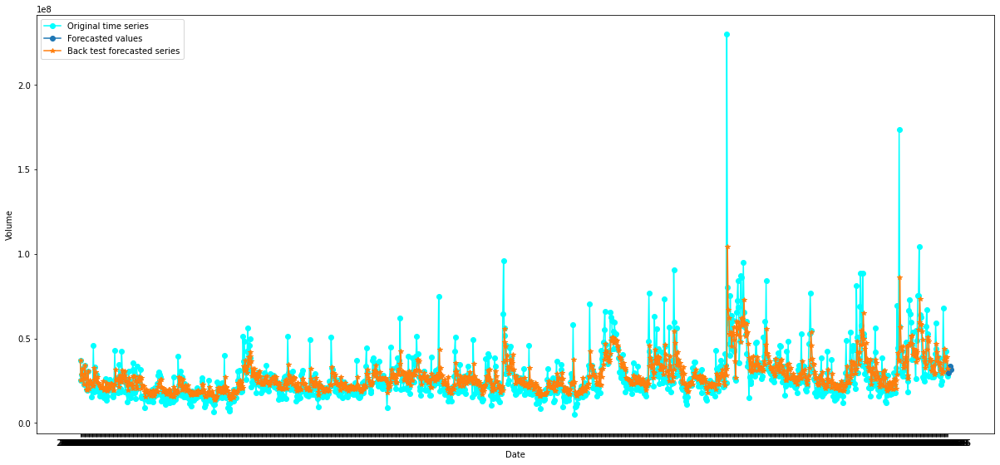

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


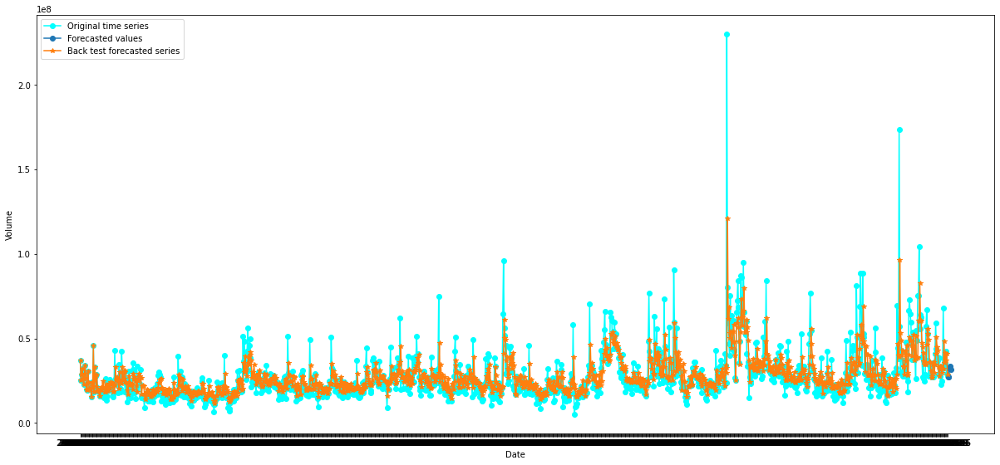

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


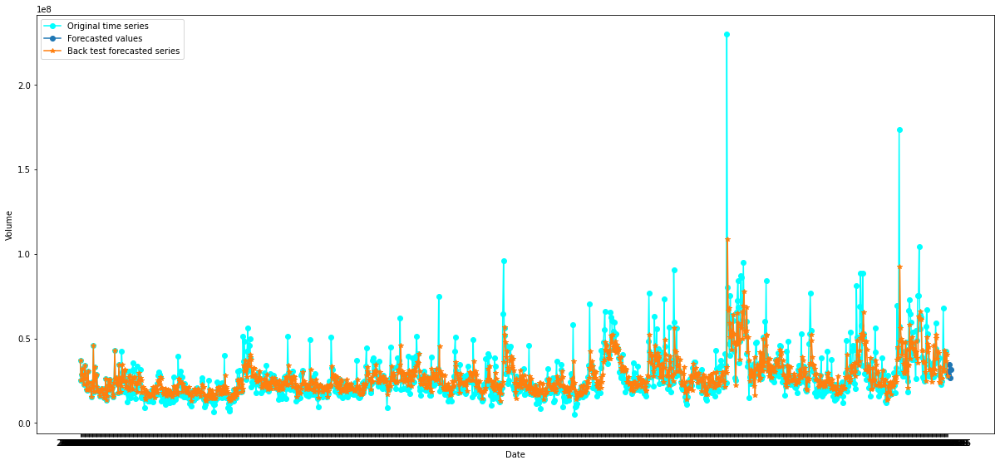

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


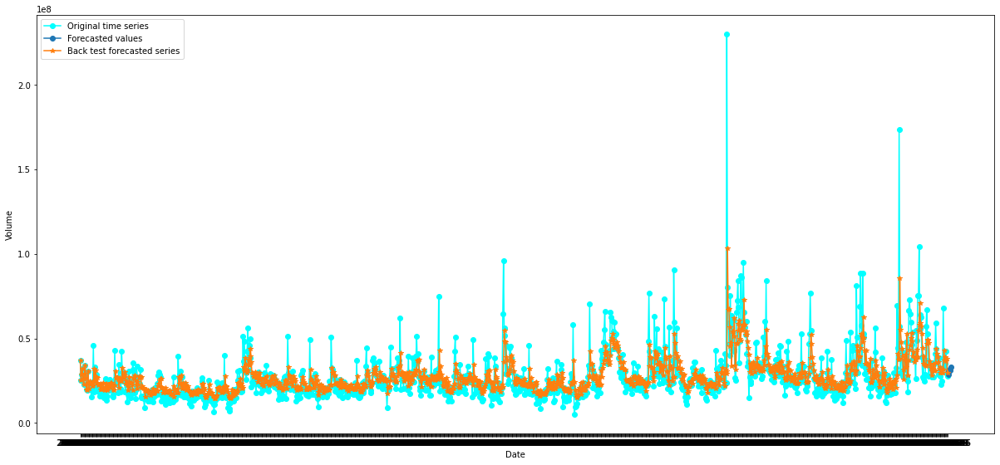

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


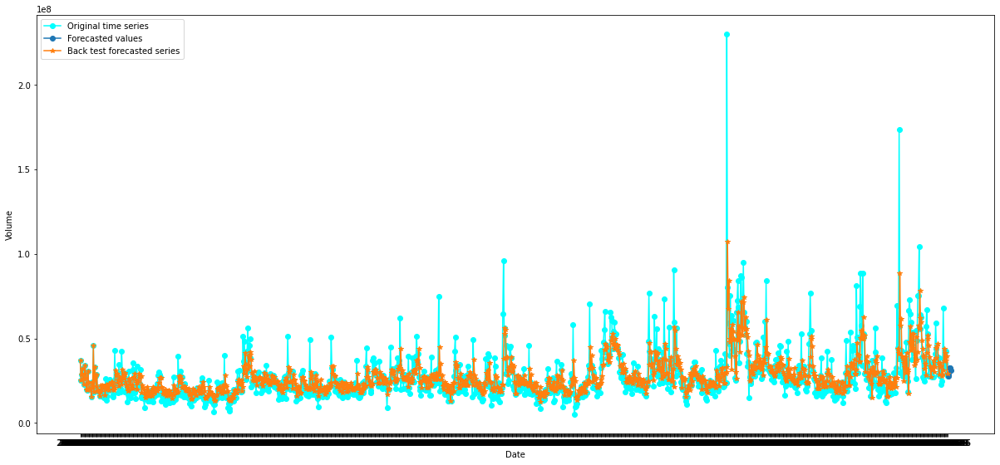

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


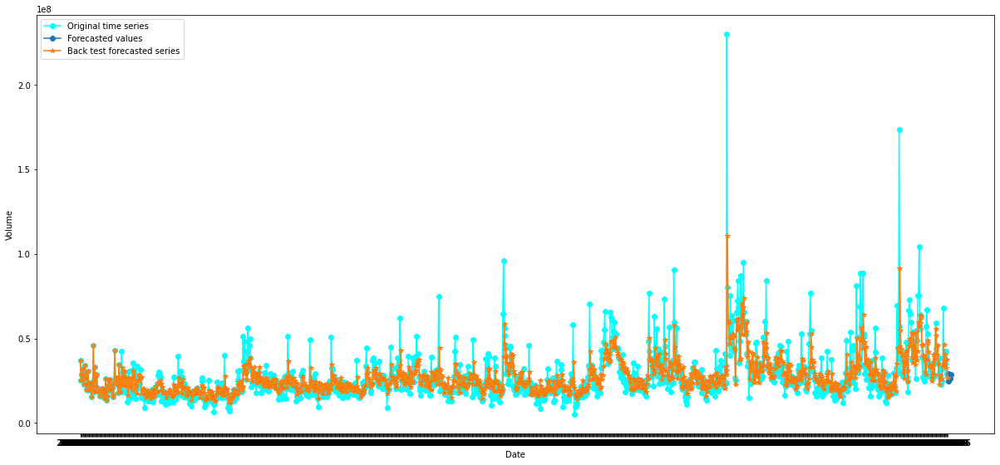

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


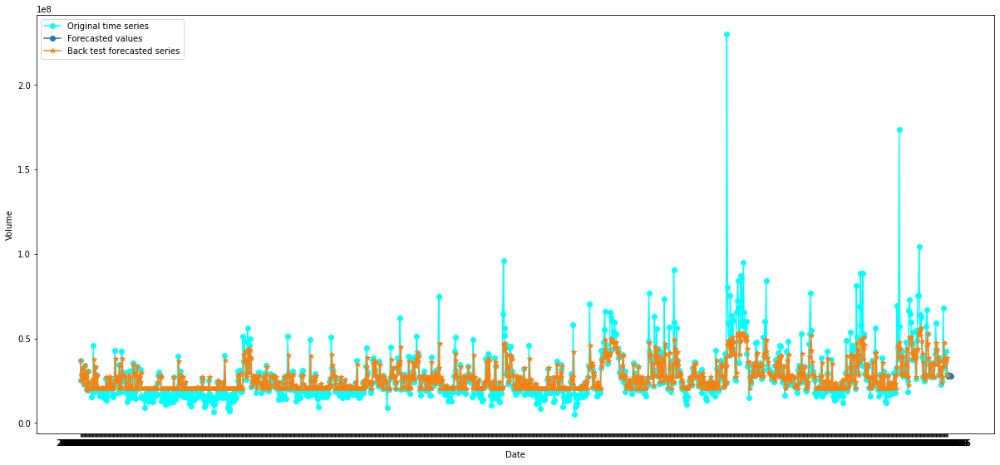

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


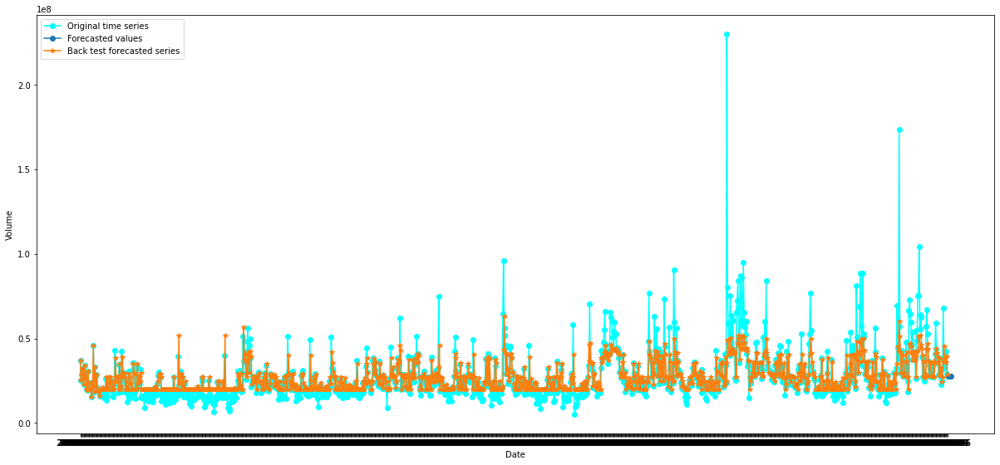

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


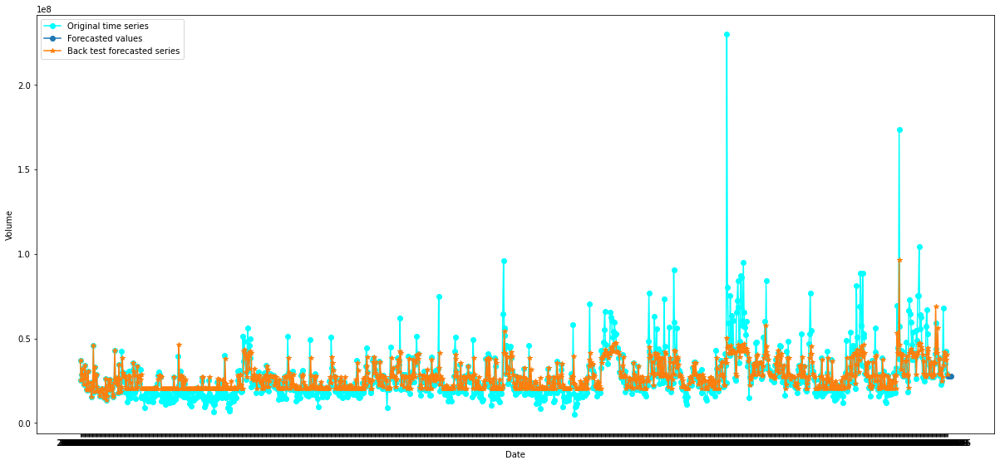

Working on  SPOT.csv  dataset
Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.482e+02, tolerance: 2.875e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


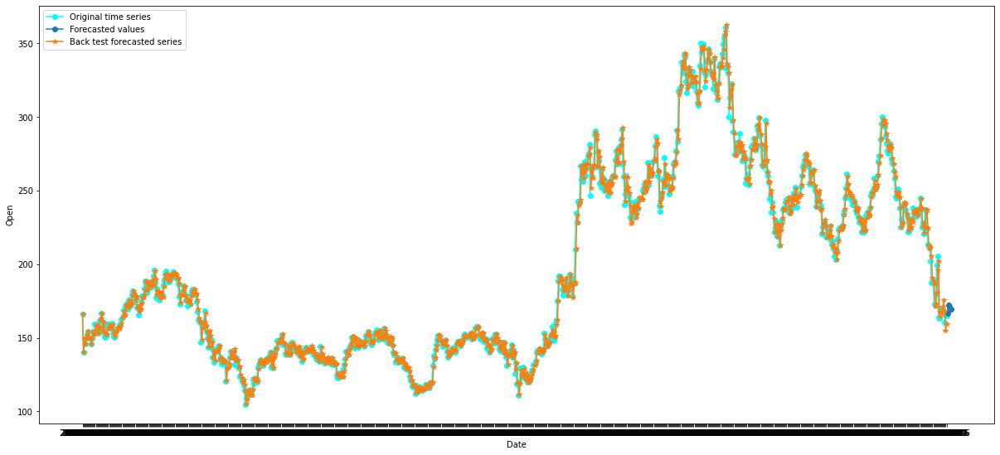

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.276e+03, tolerance: 2.848e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


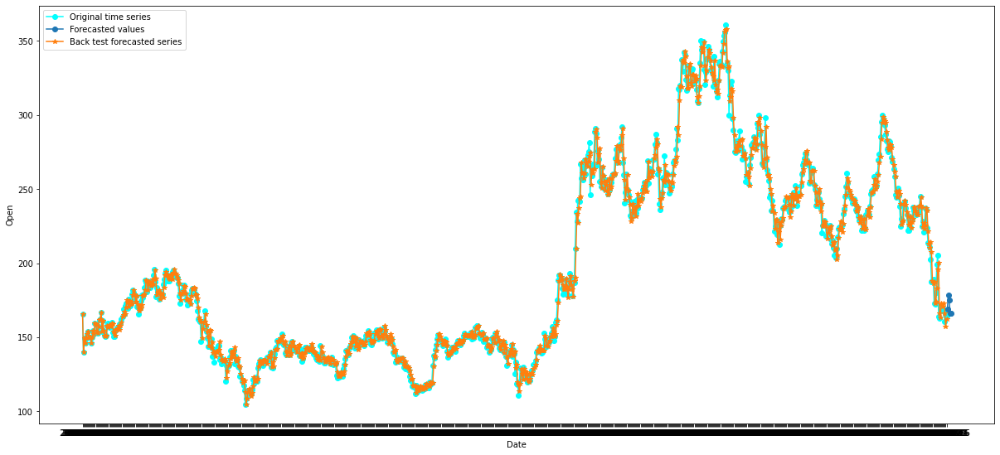

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.382e+02, tolerance: 2.763e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


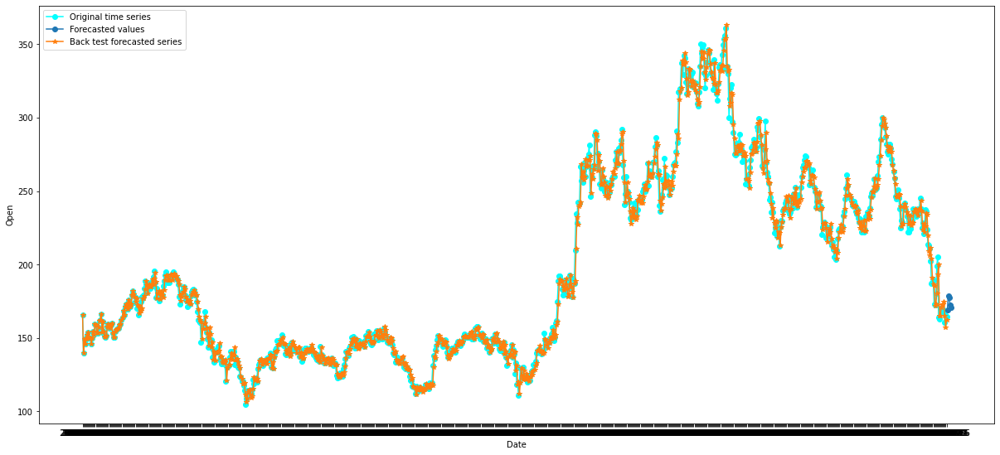

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


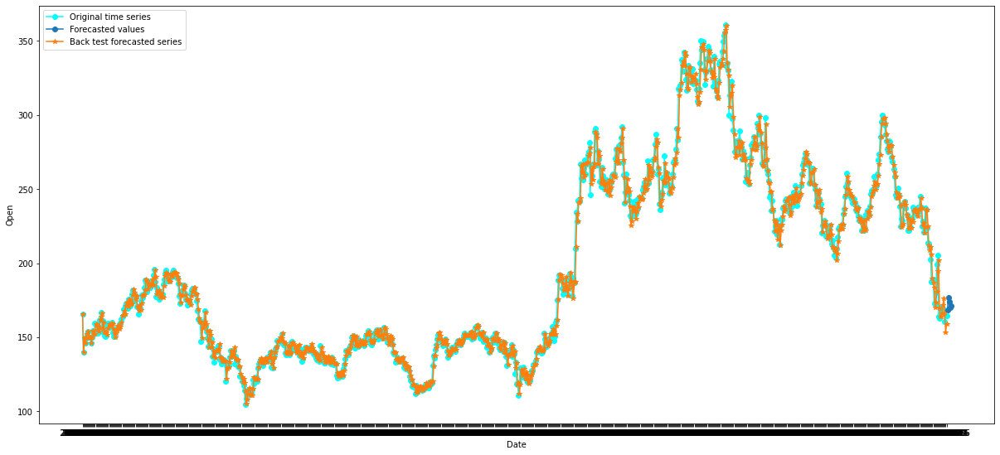

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


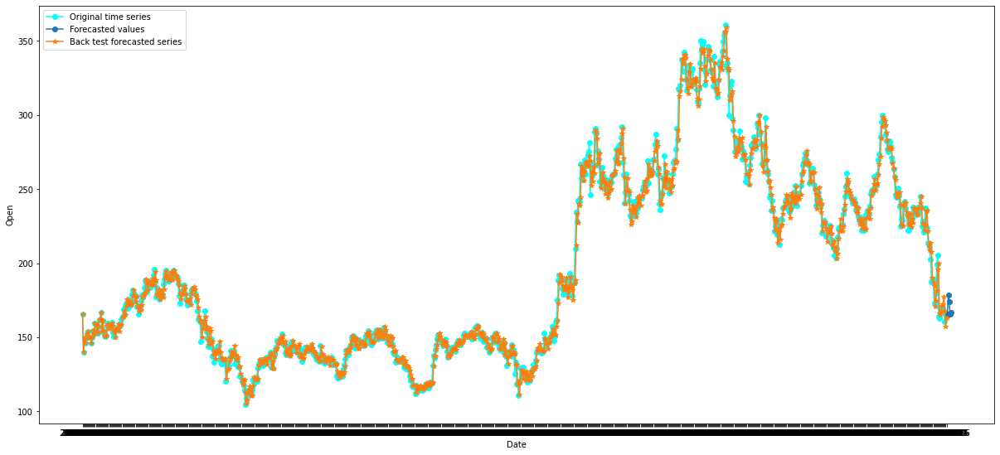

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


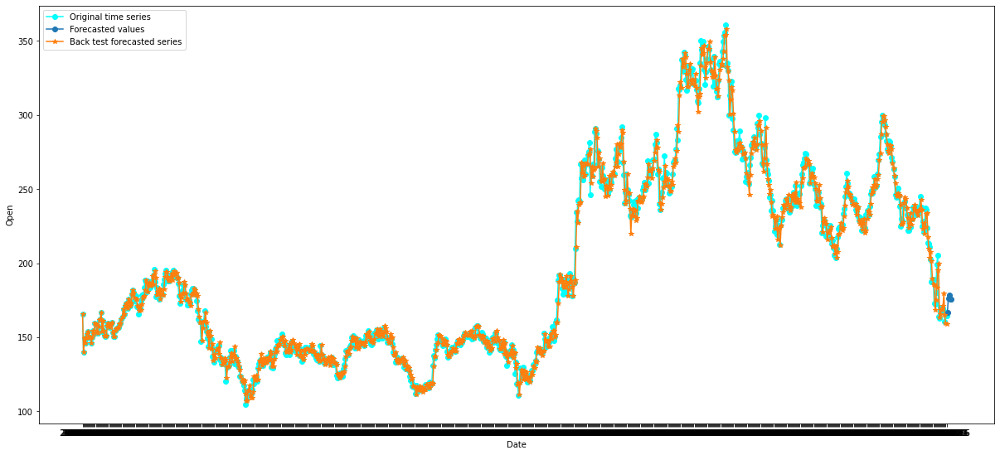

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


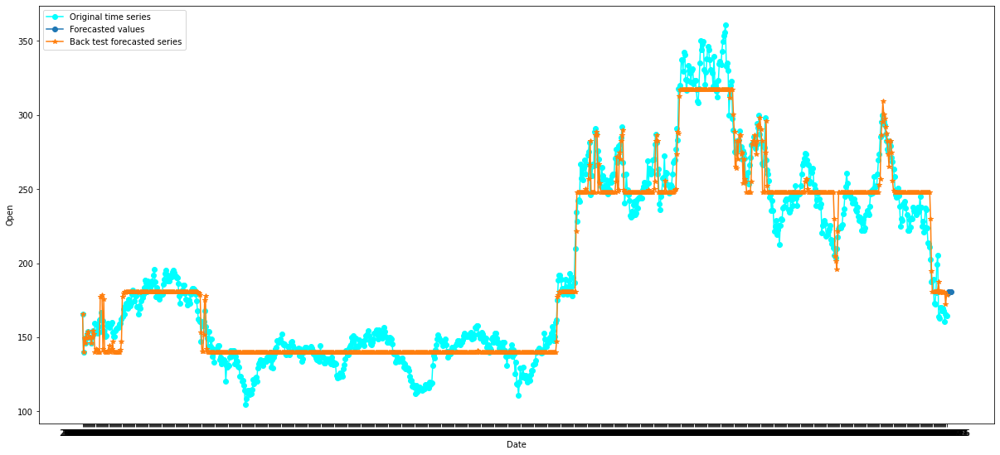

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


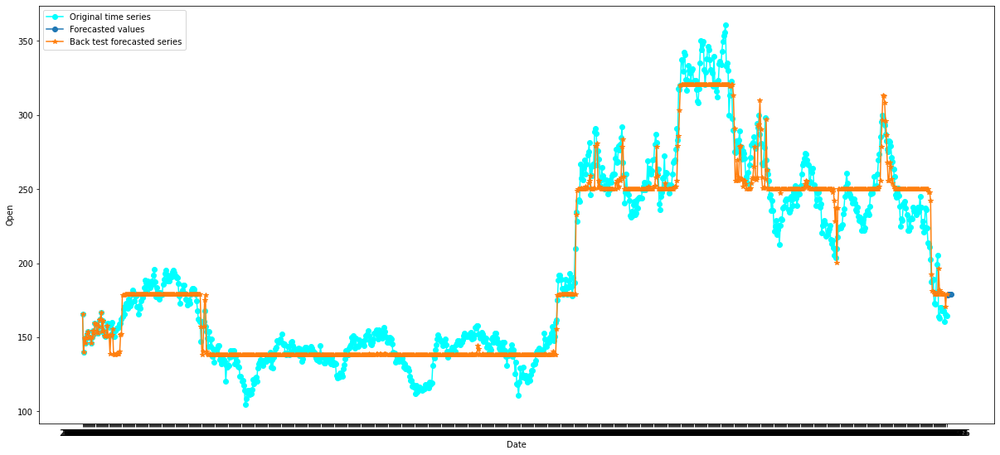

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


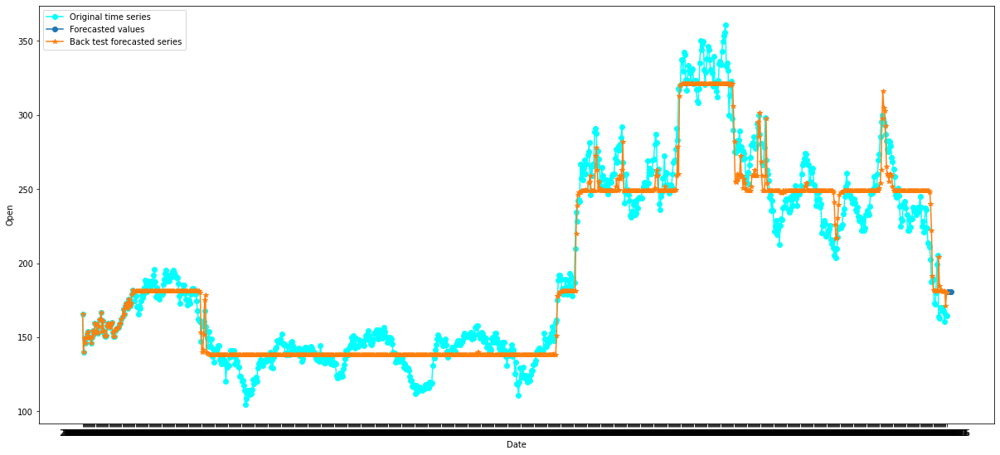

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


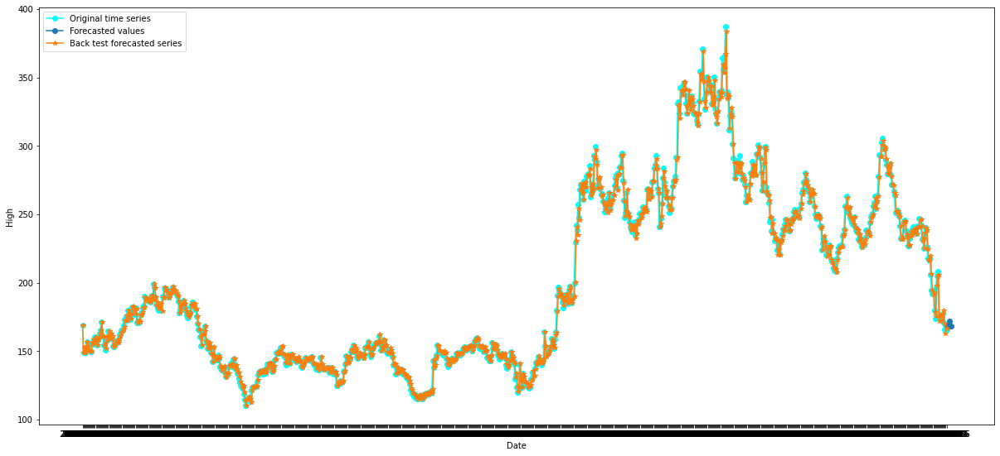

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


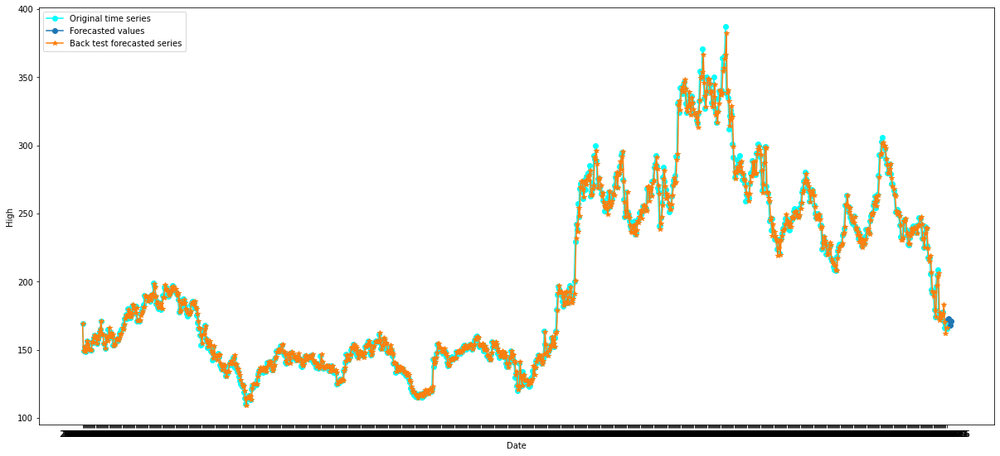

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.058e+02, tolerance: 2.833e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


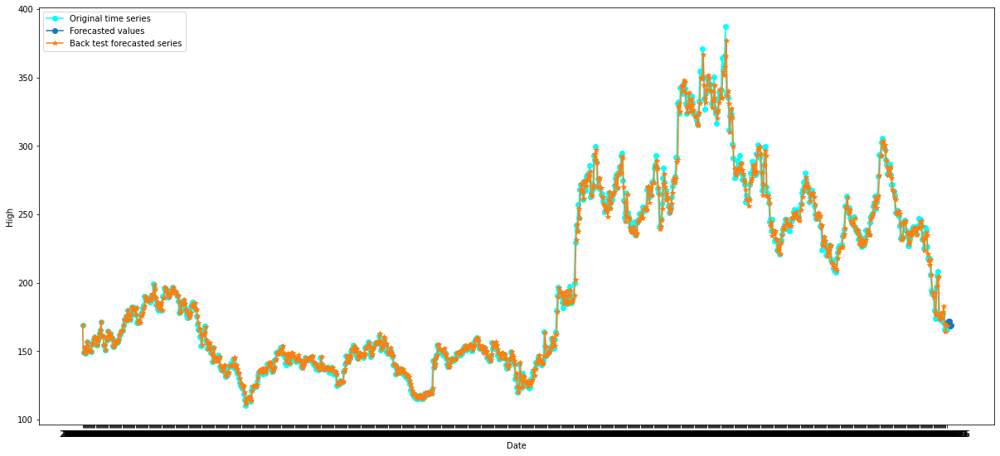

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


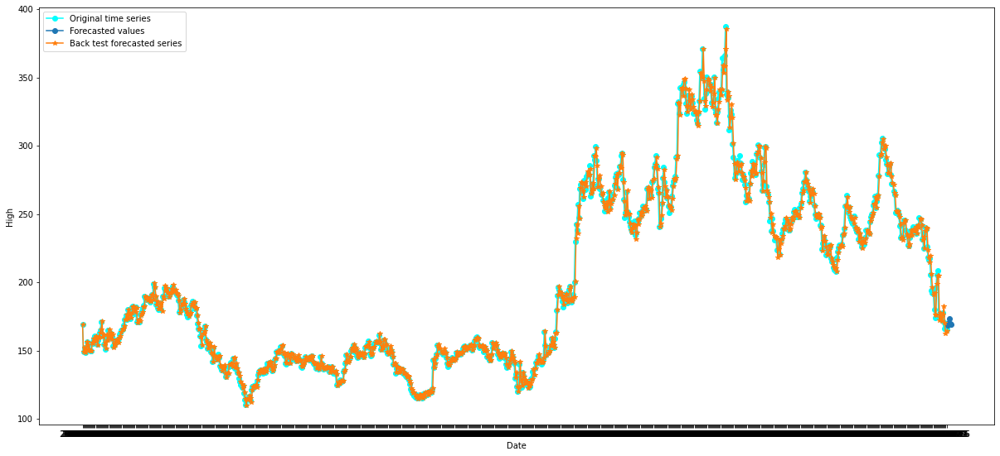

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


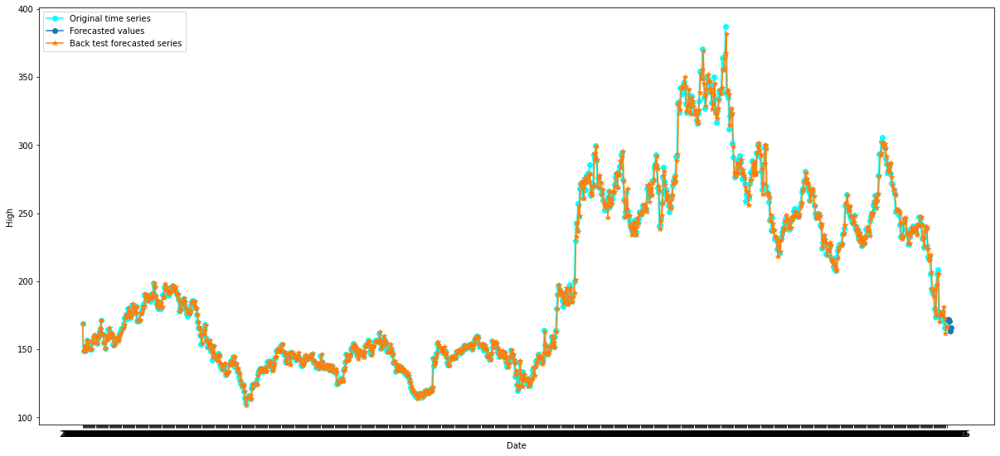

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


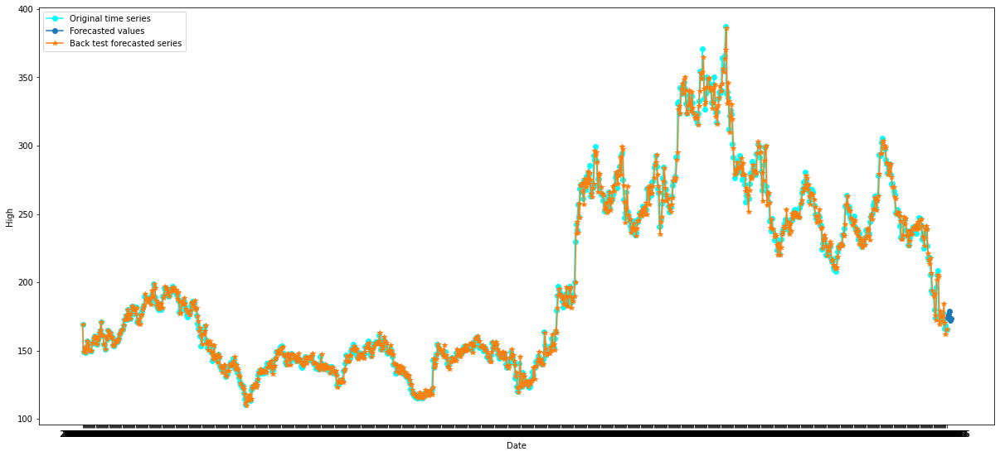

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


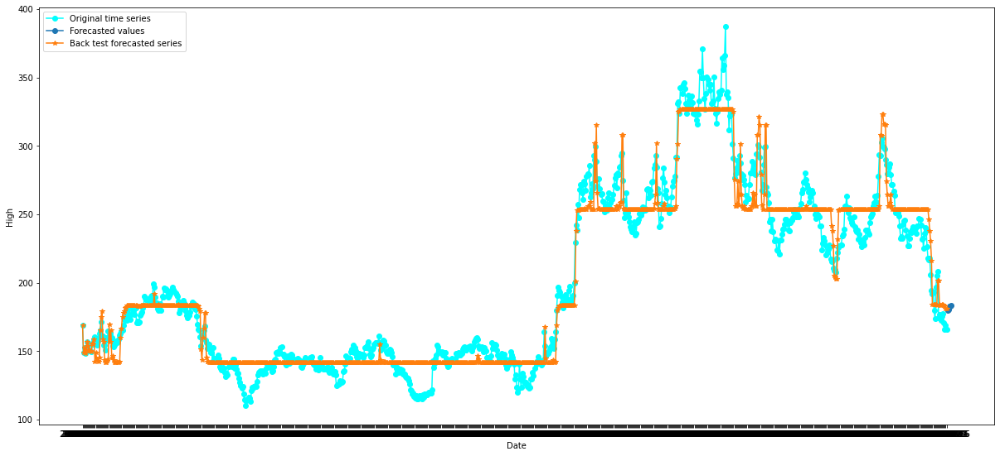

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


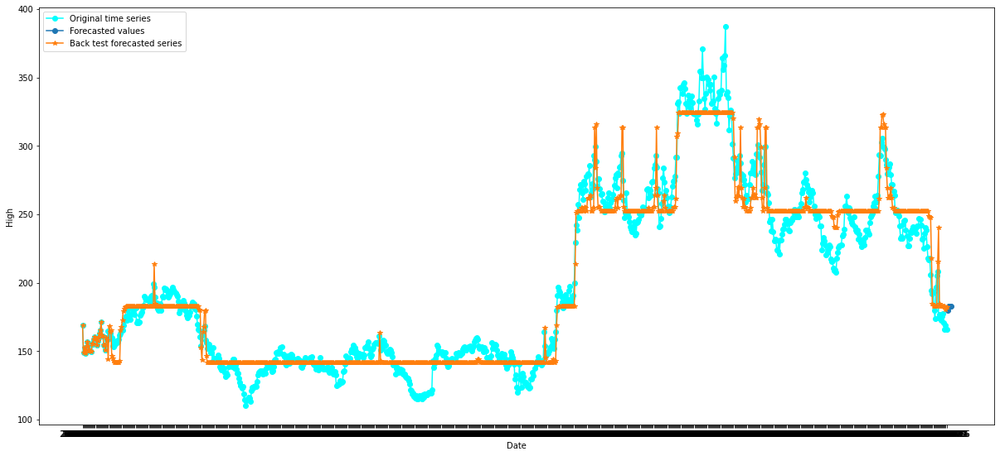

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


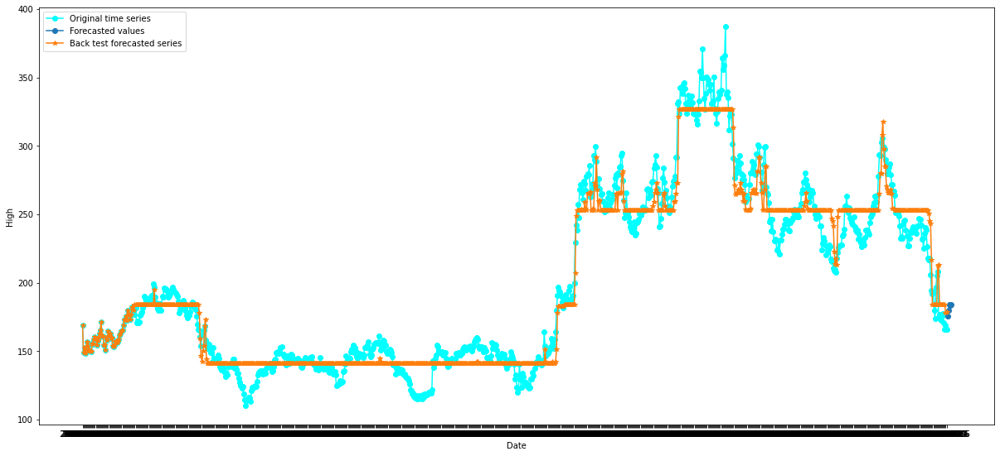

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


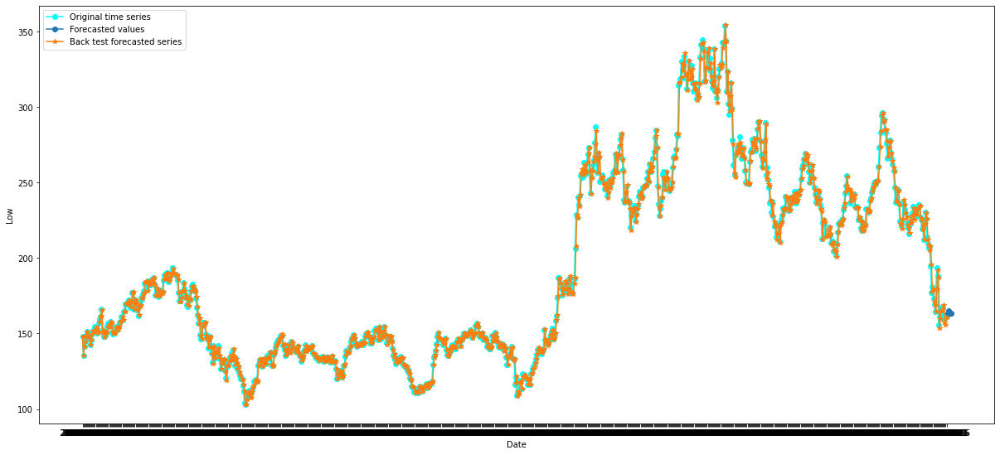

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


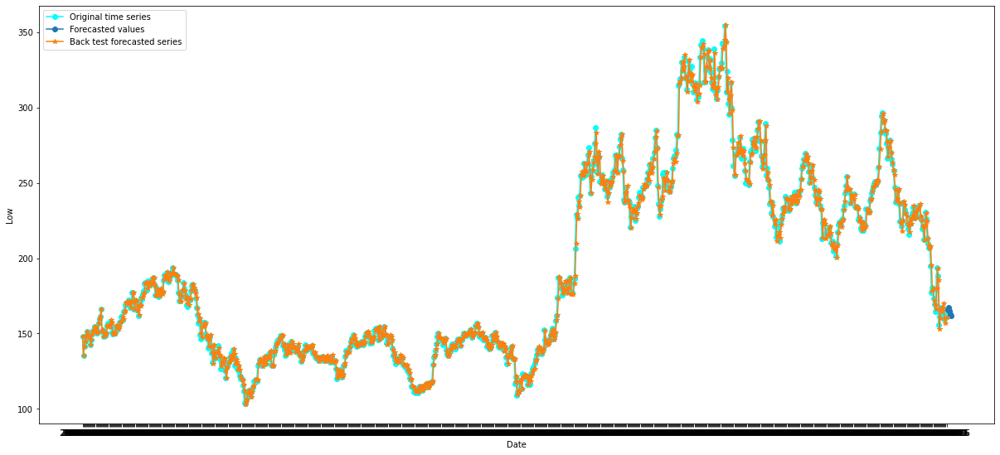

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.441e+02, tolerance: 2.725e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


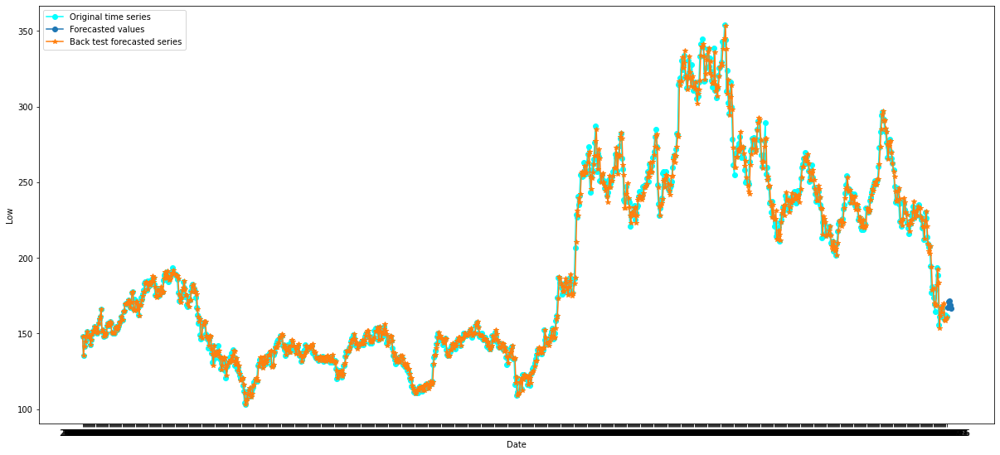

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


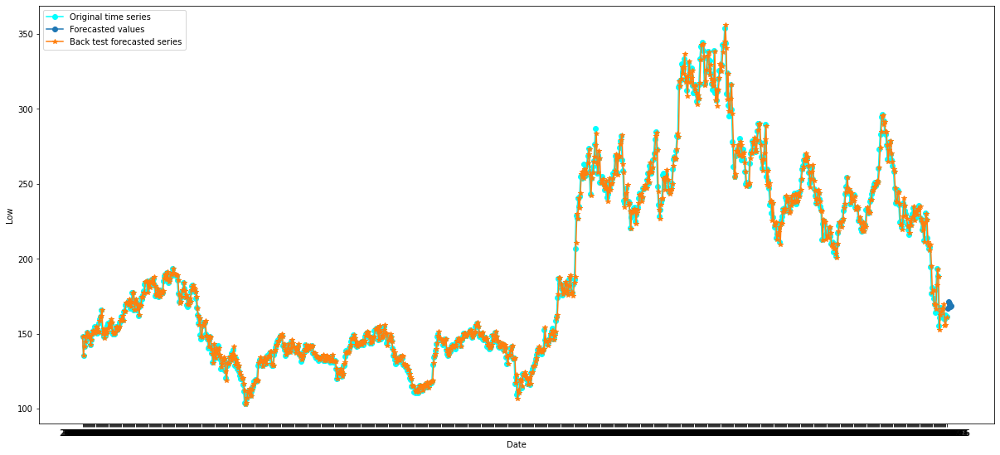

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


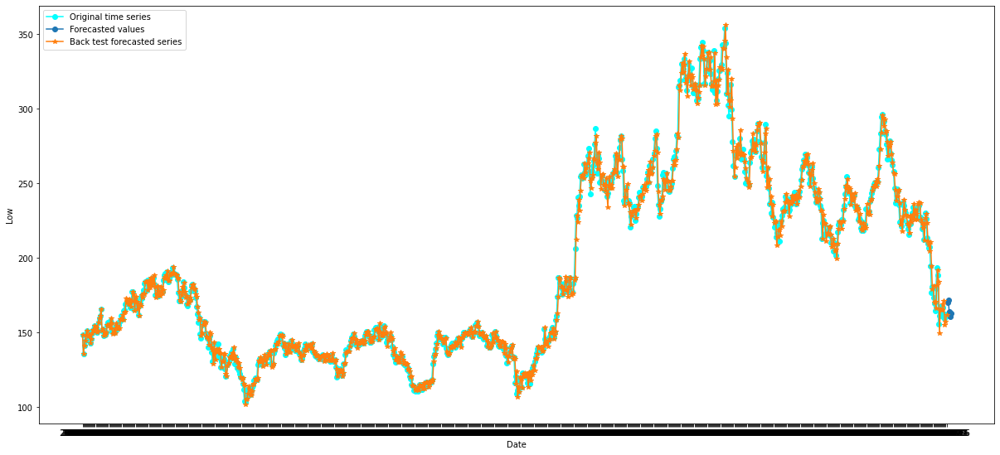

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


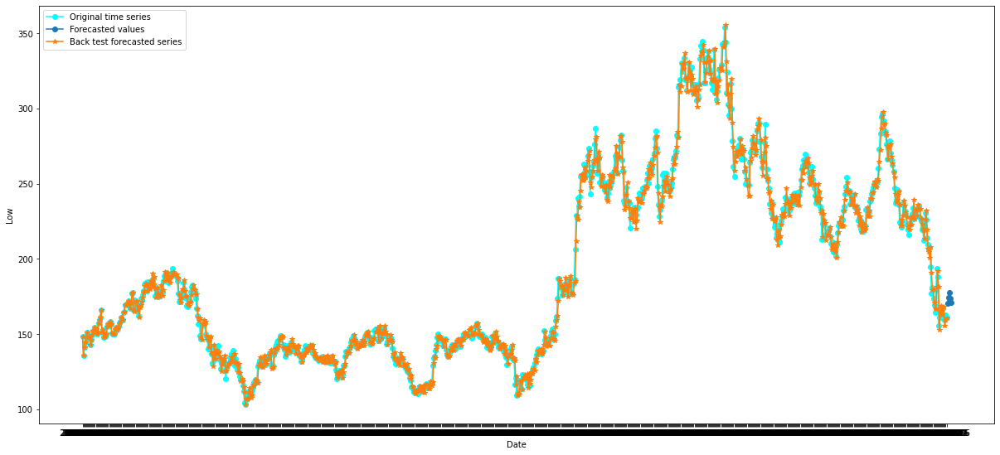

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


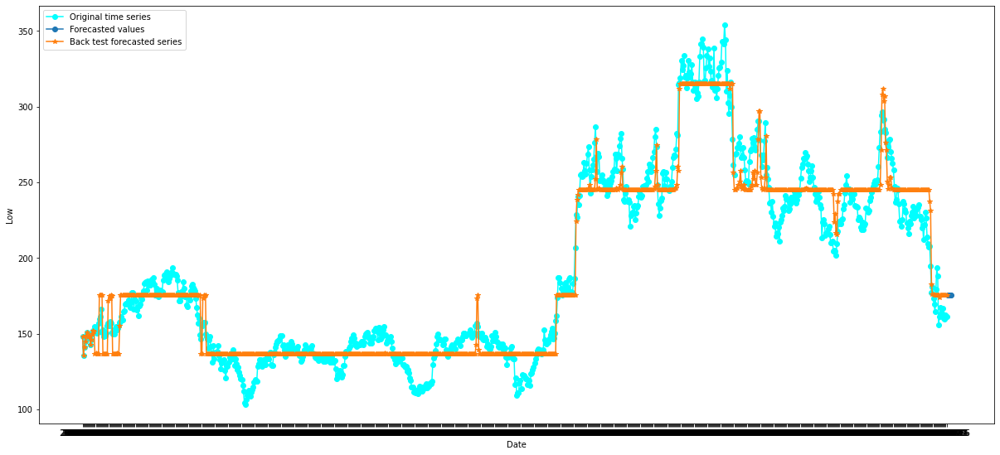

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


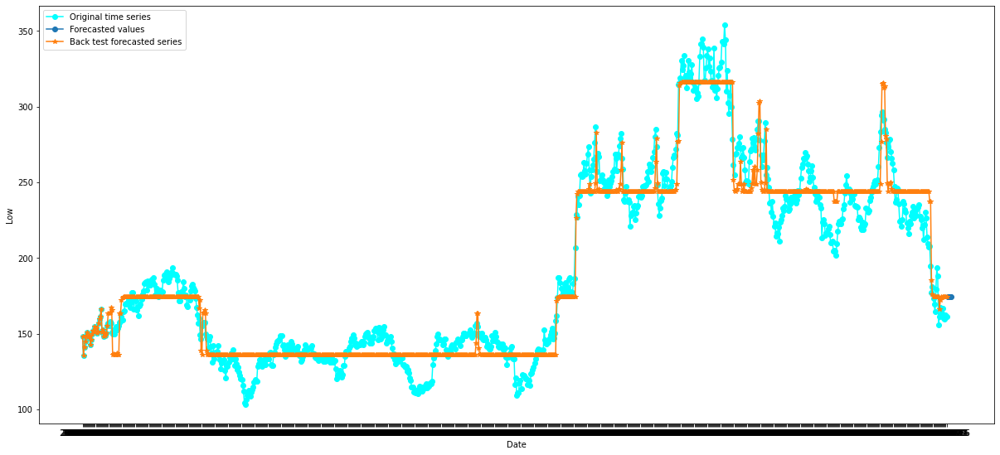

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


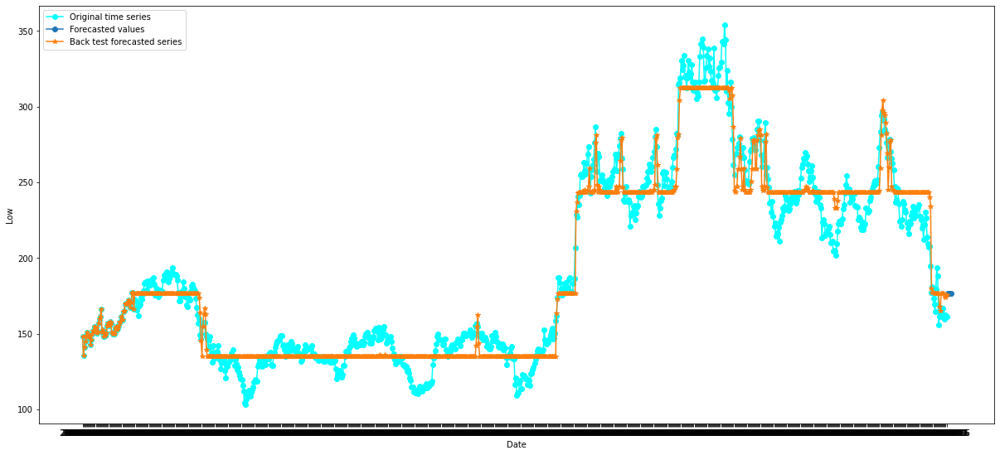

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


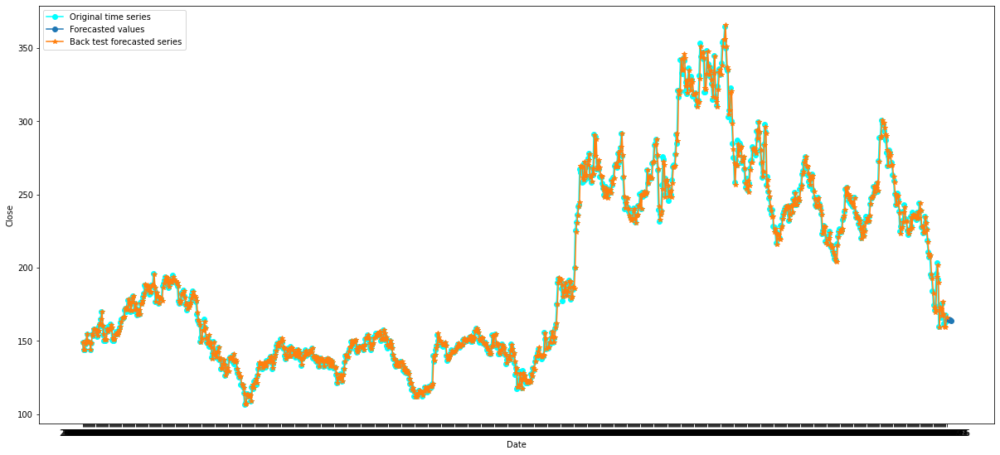

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.296e+02, tolerance: 2.913e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


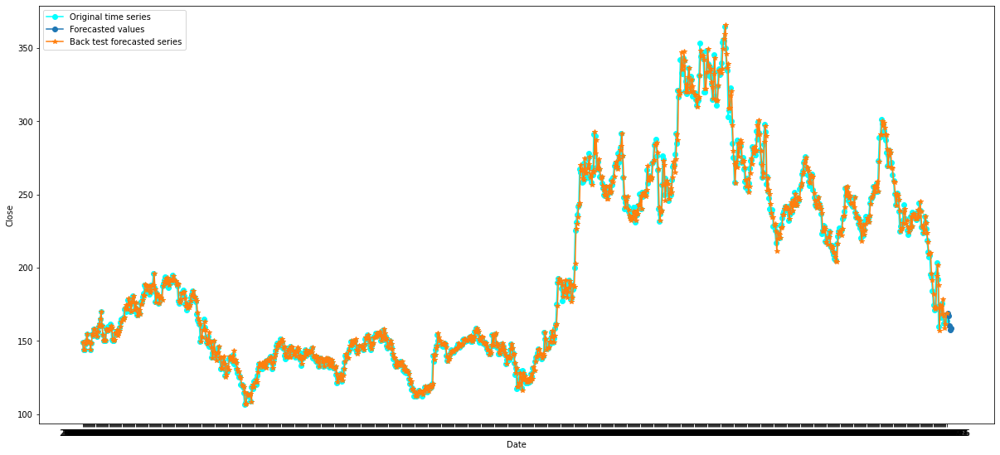

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.322e+02, tolerance: 2.804e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


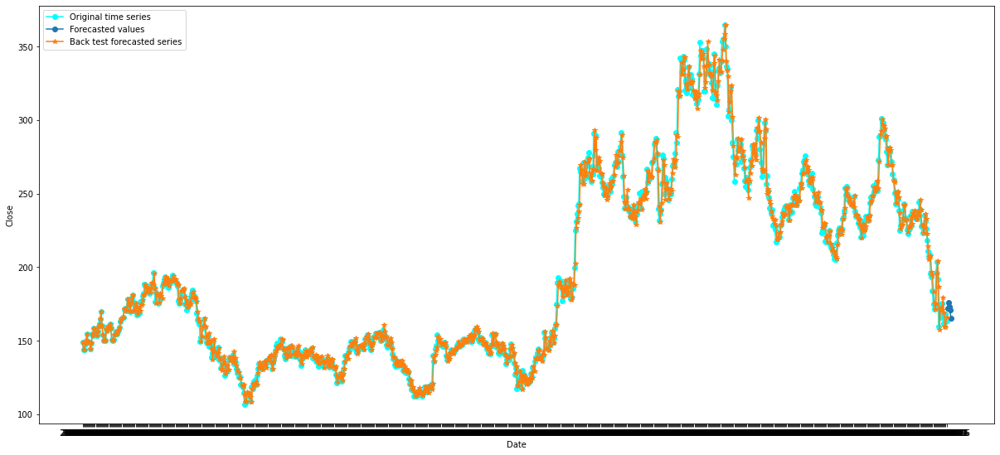

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


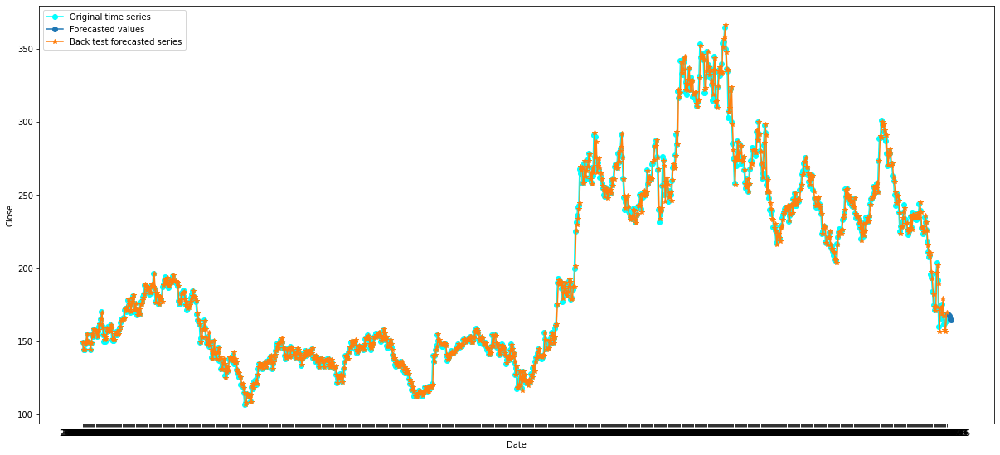

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


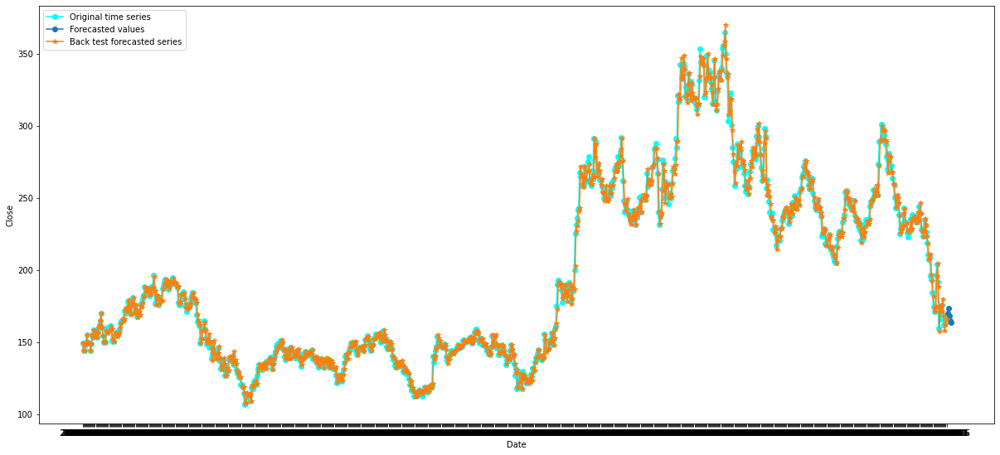

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


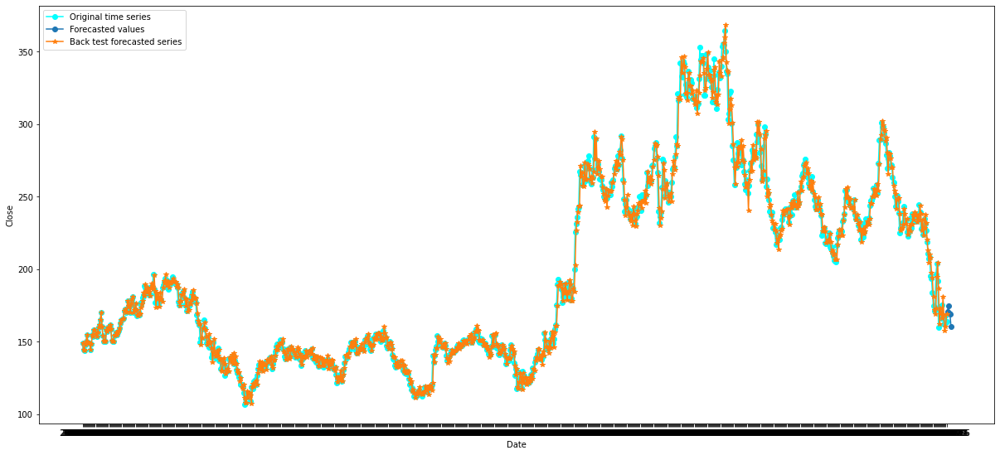

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


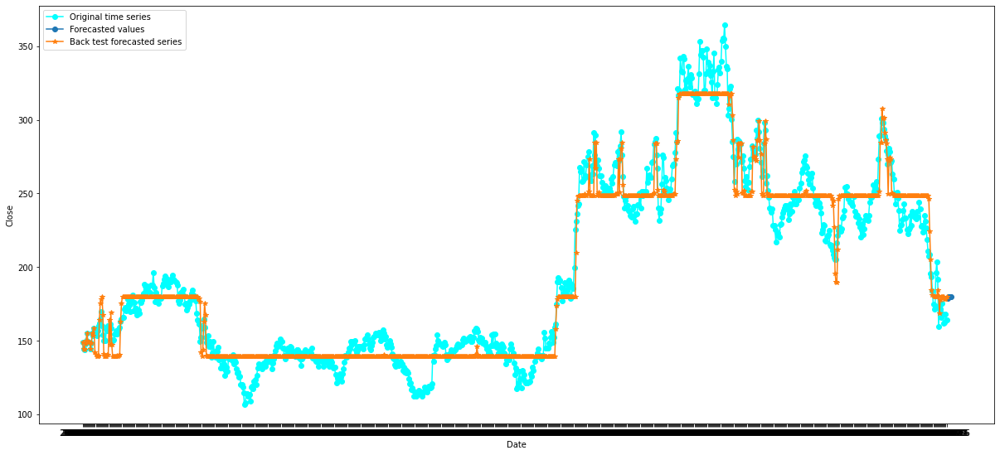

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


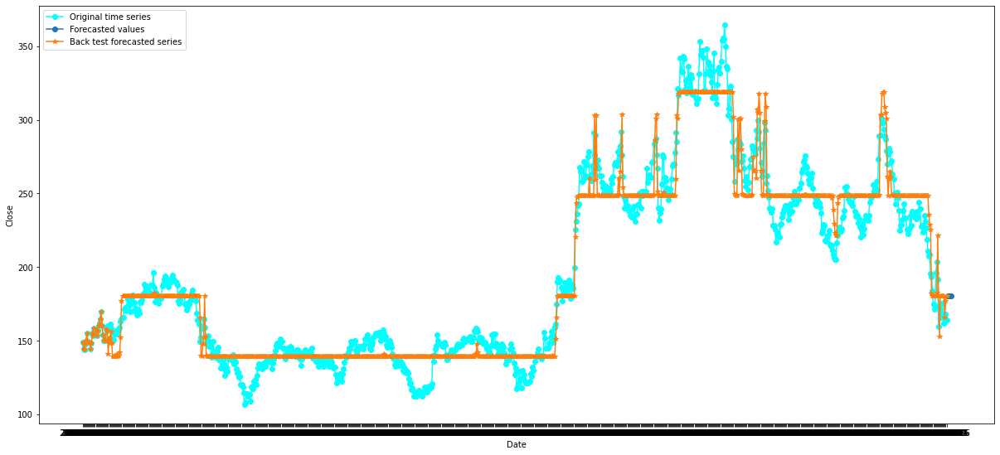

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


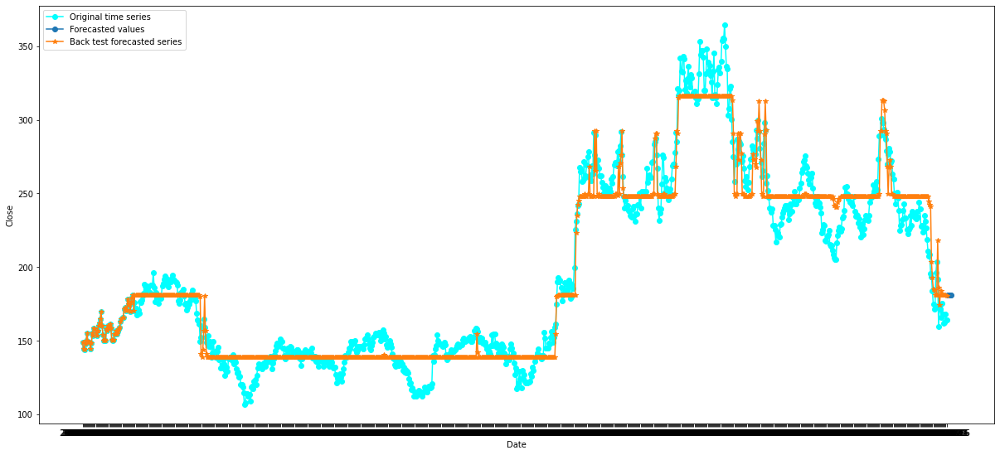

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


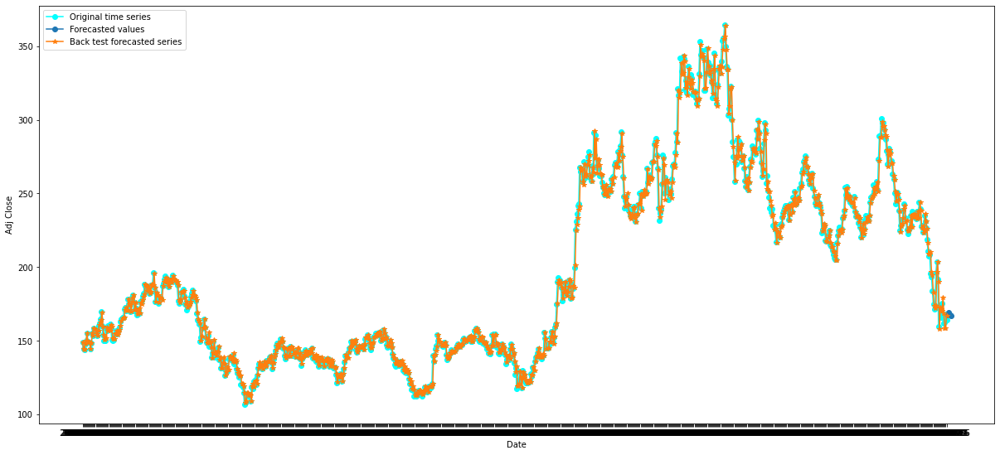

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


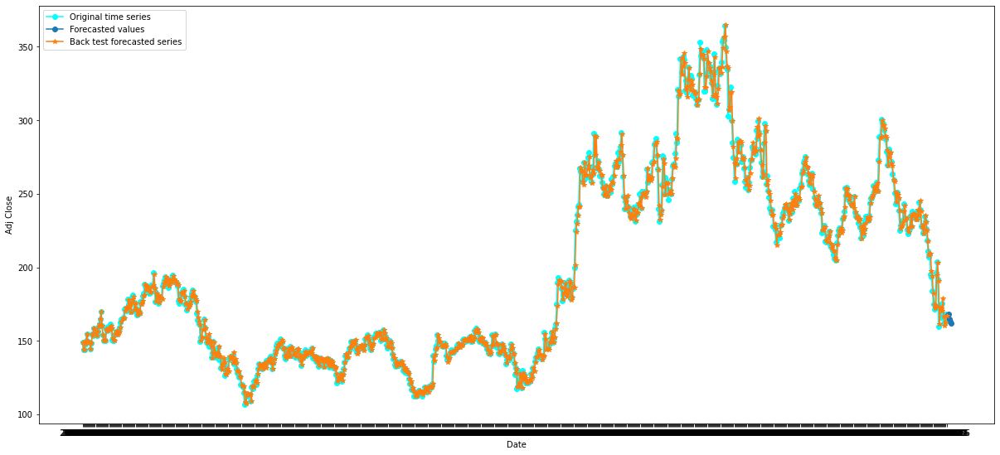

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


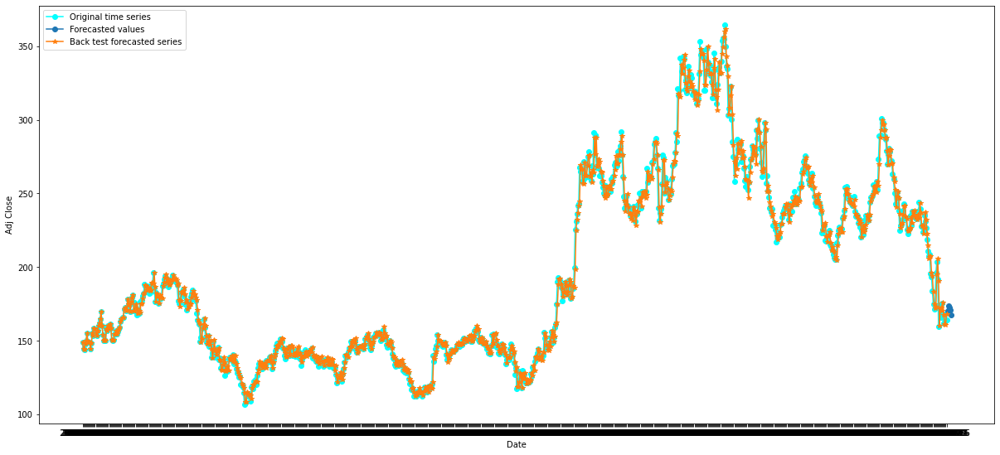

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


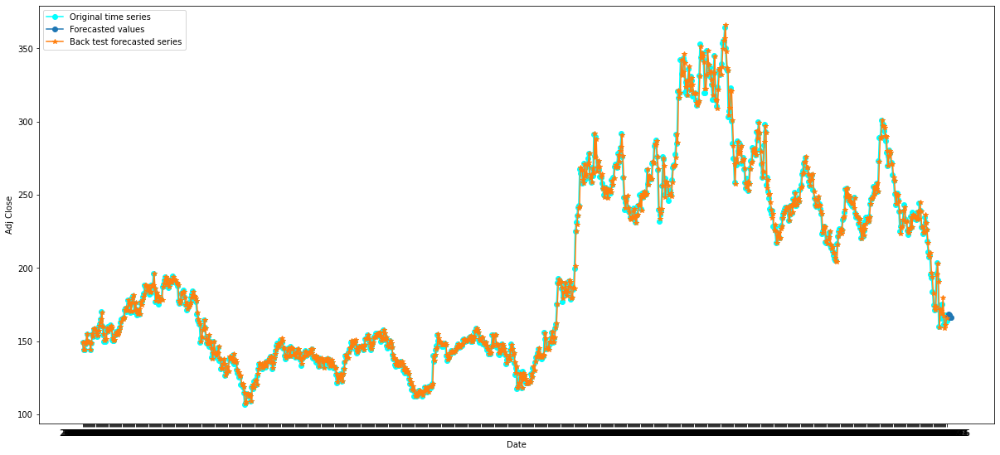

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


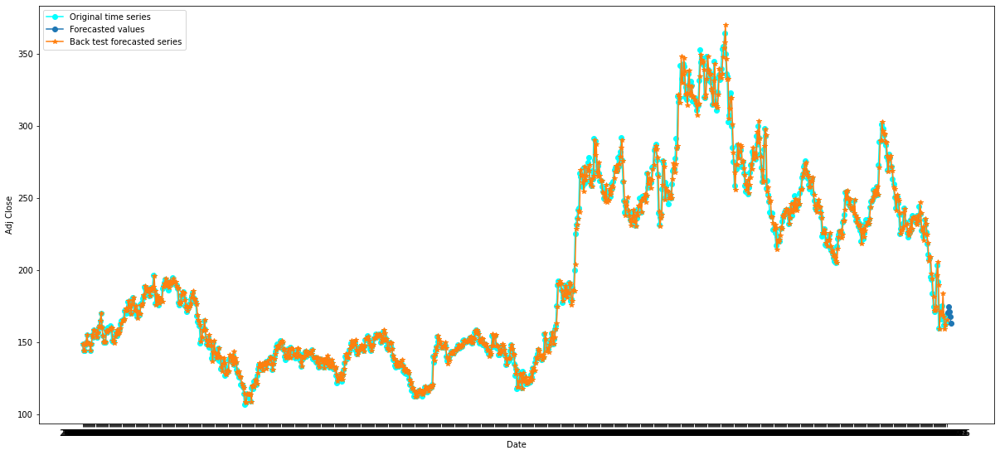

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


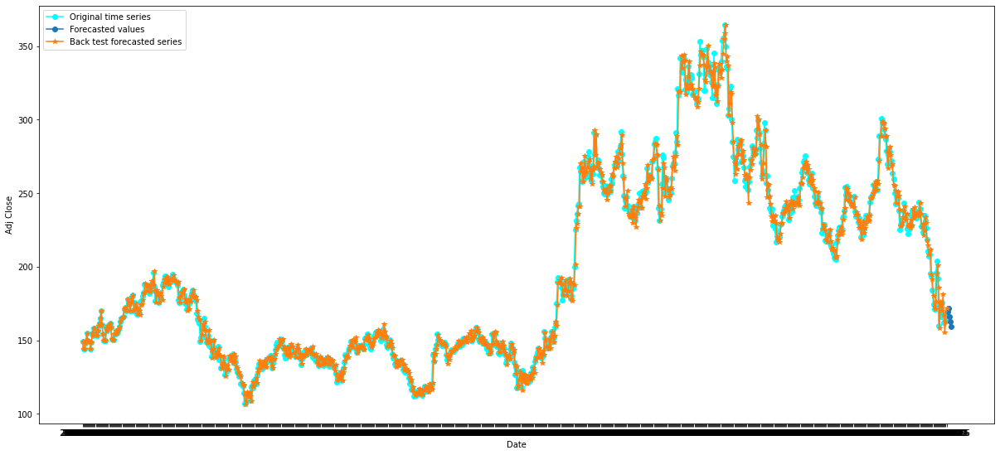

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


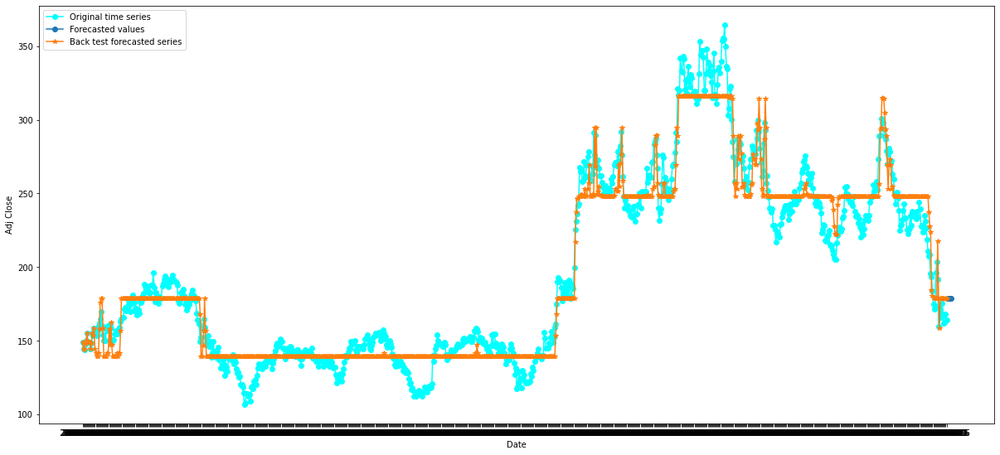

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


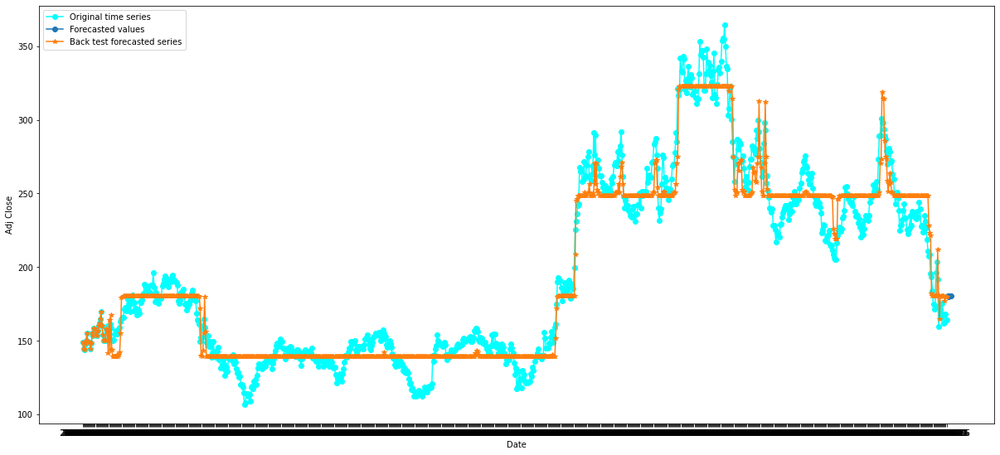

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


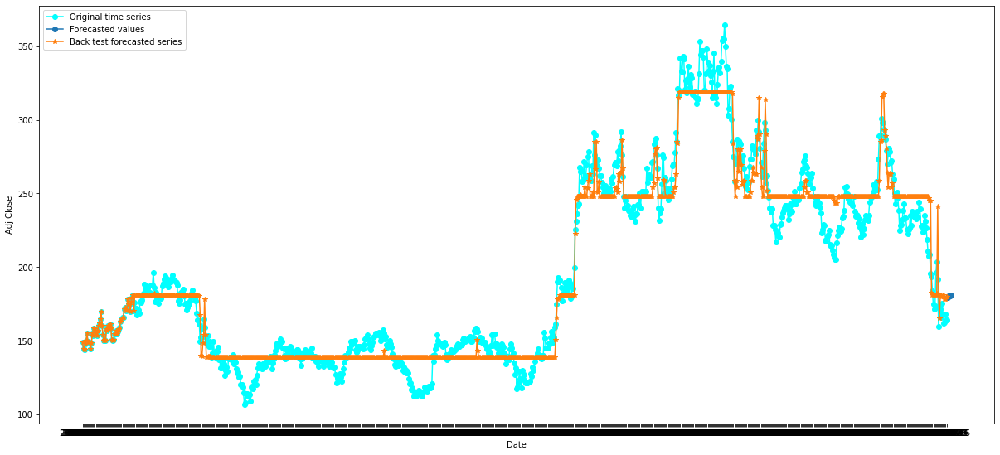

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


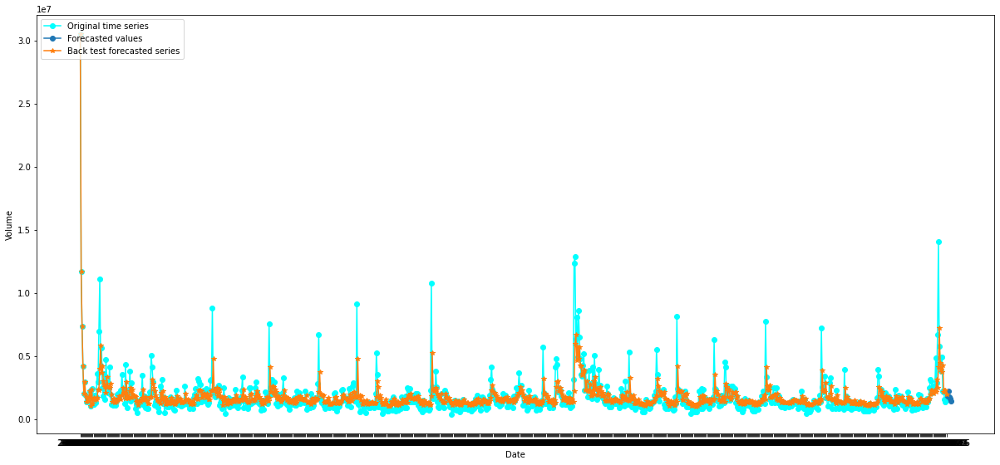

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


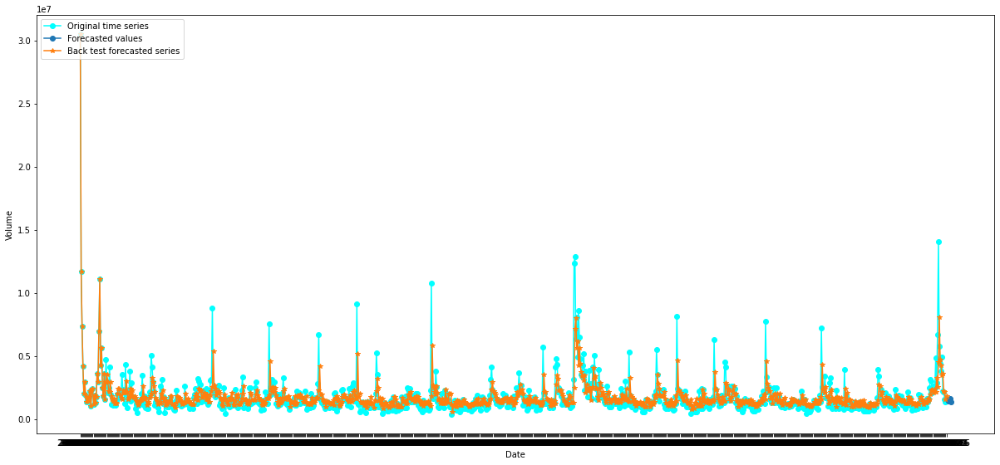

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


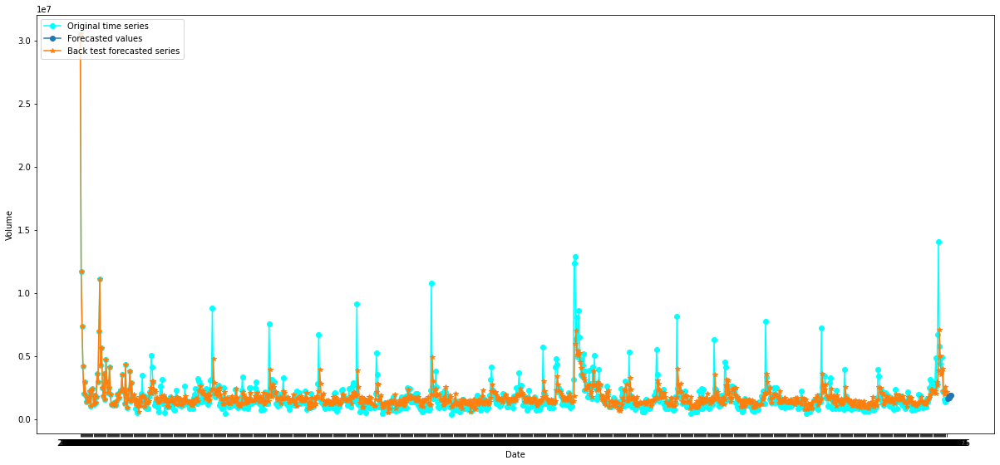

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


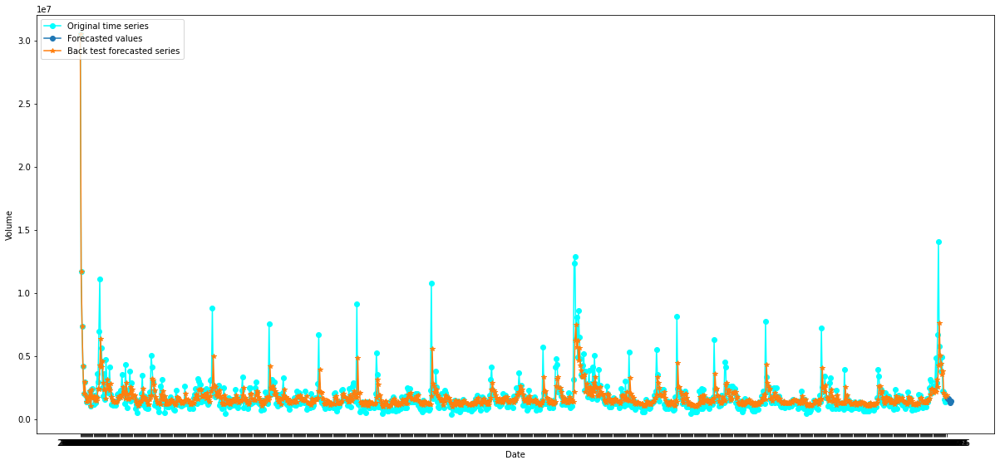

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


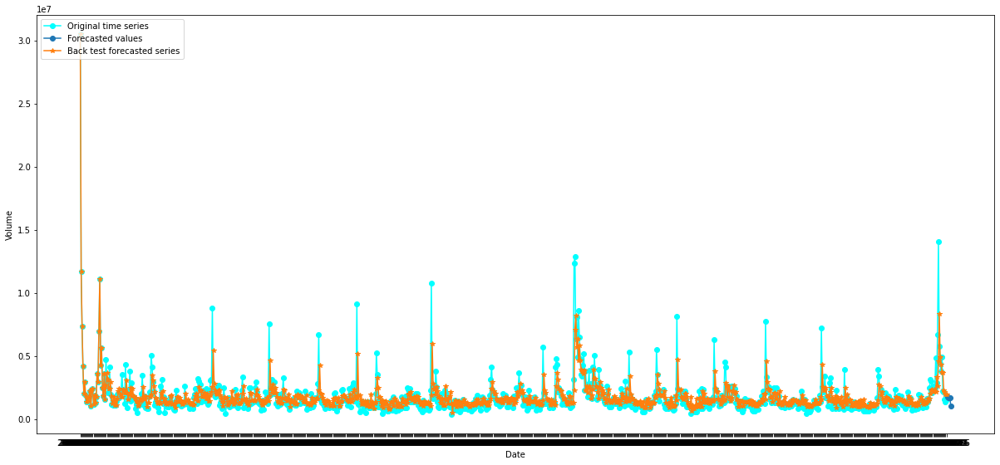

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


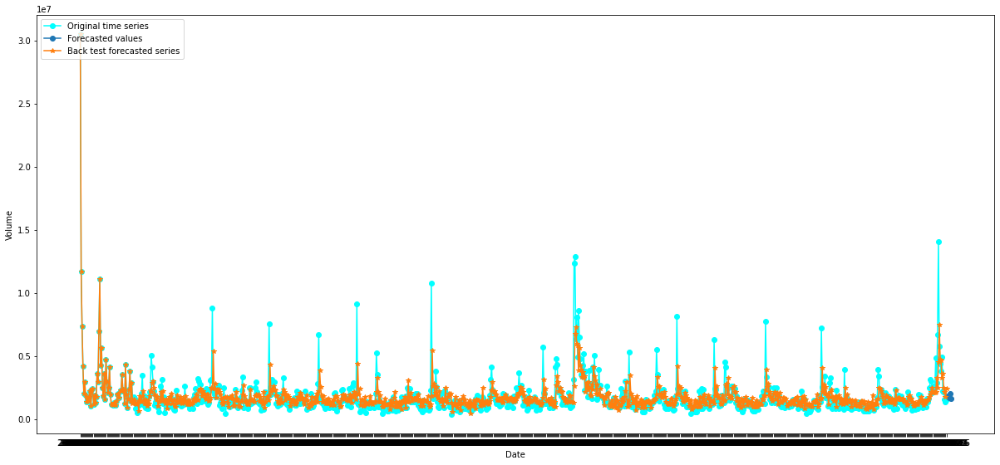

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


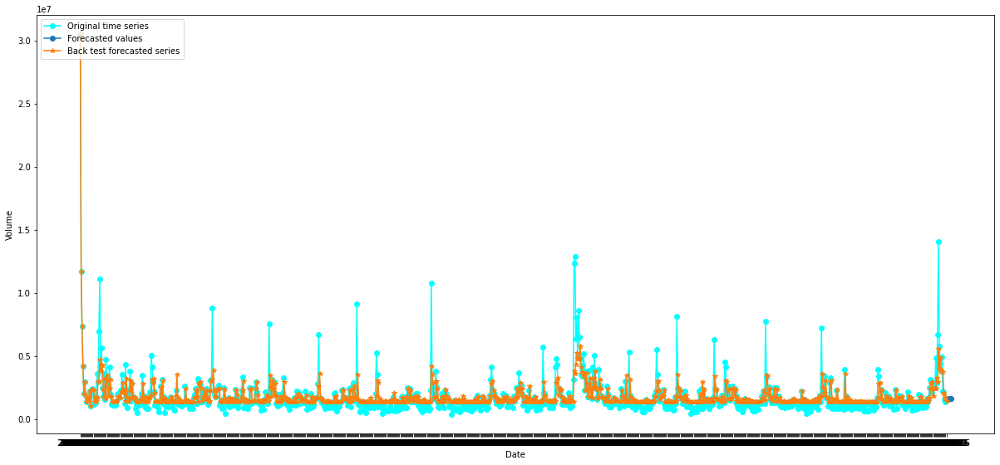

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


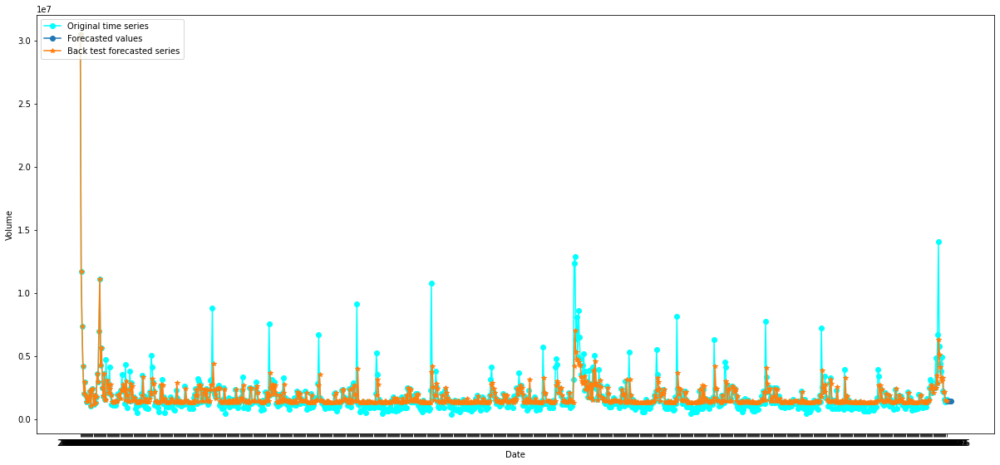

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


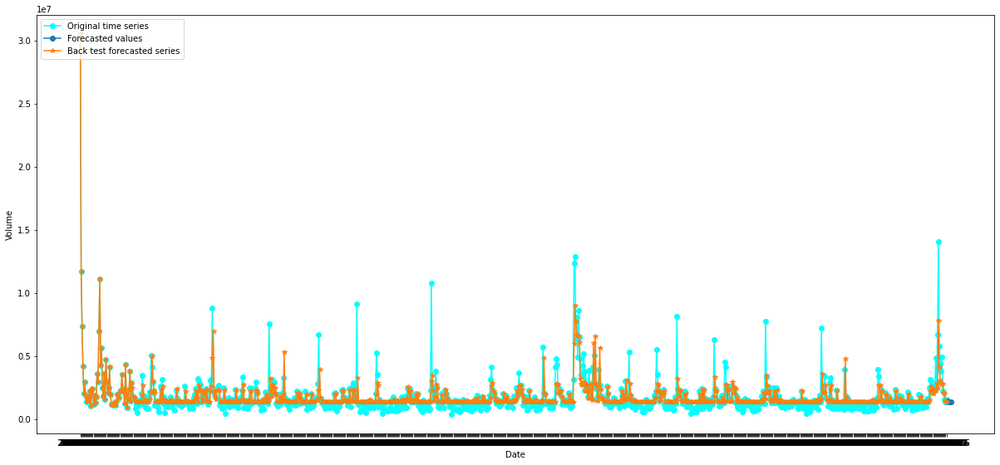

Working on  TSLA.csv  dataset
Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.187e+05, tolerance: 9.391e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


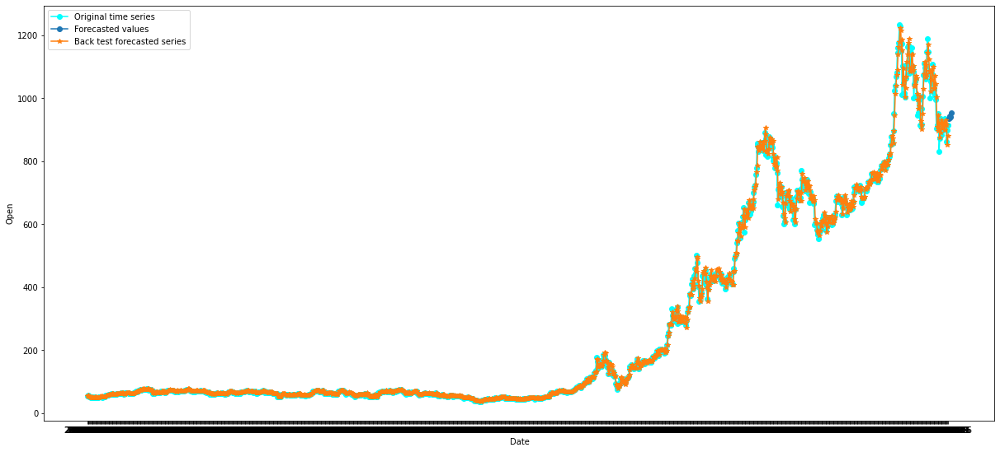

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.126e+05, tolerance: 9.221e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


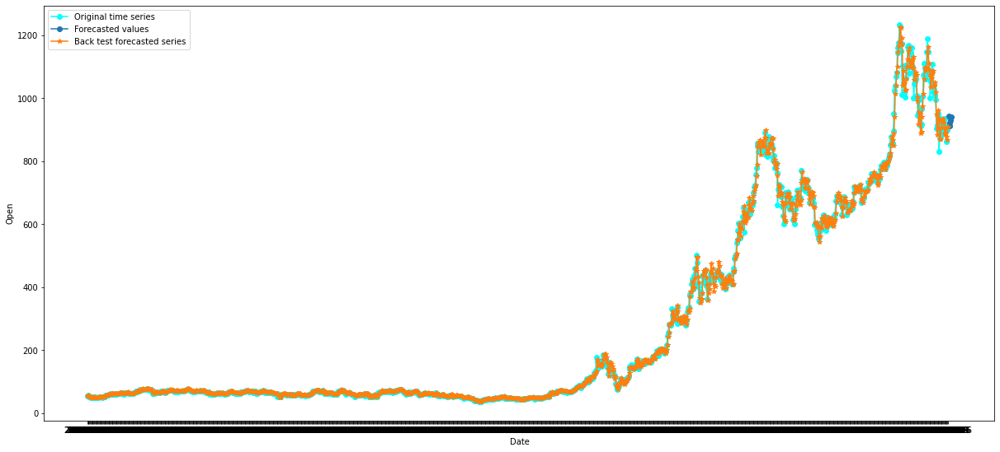

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Open ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.190e+05, tolerance: 9.581e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


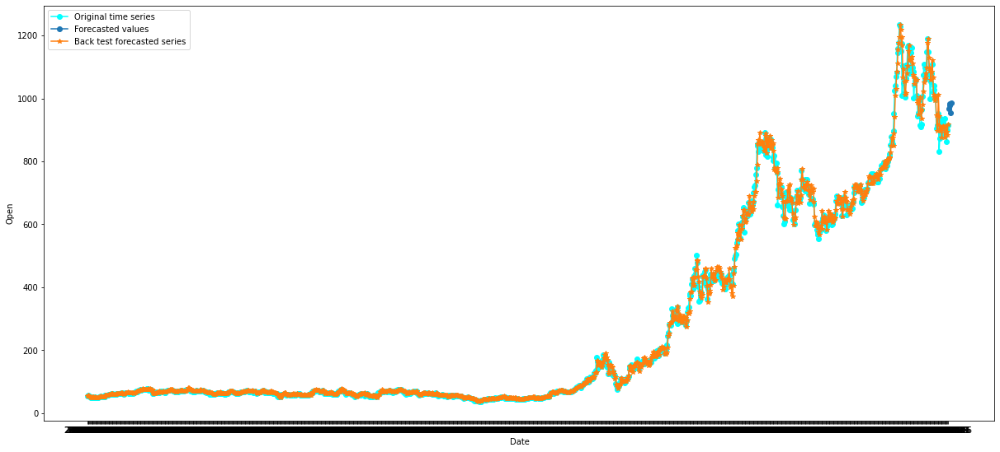

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


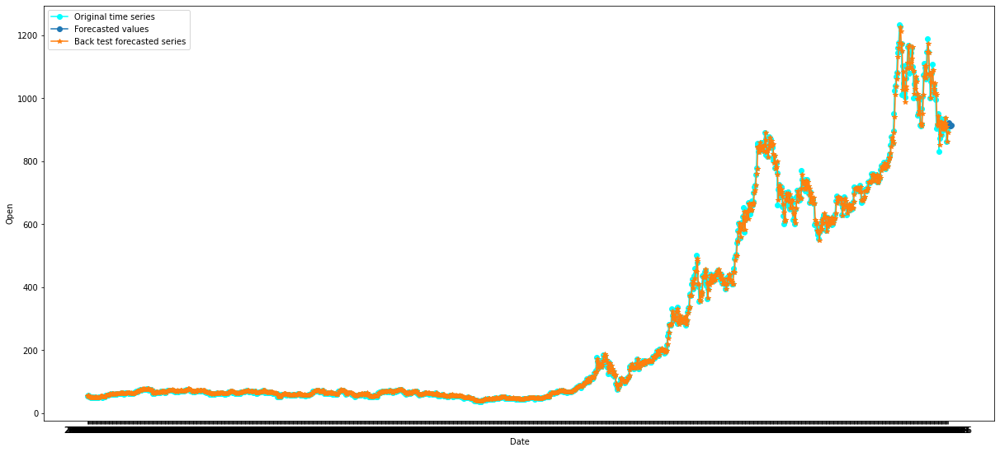

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


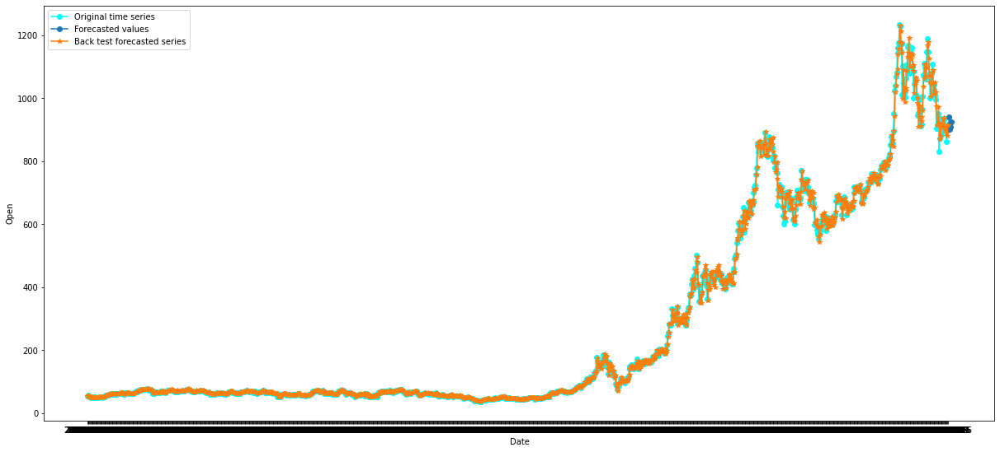

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Open ' series for patterns:
 **************************************************


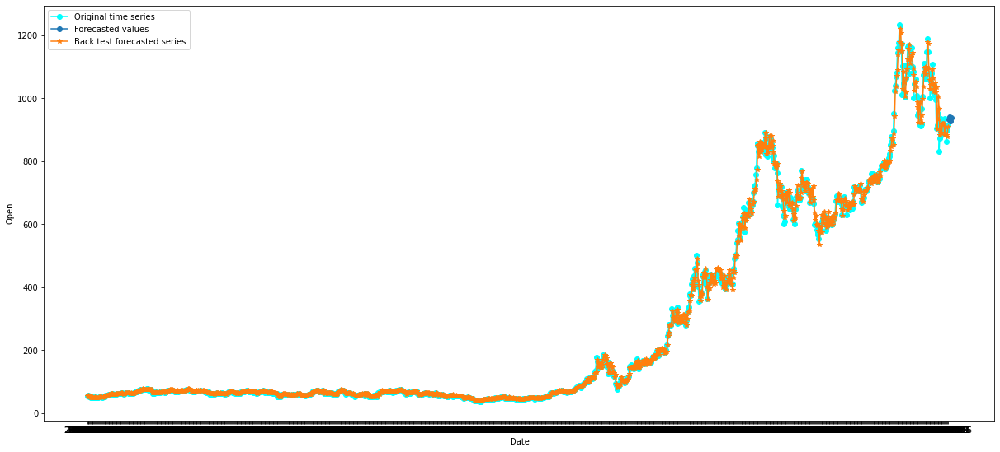

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


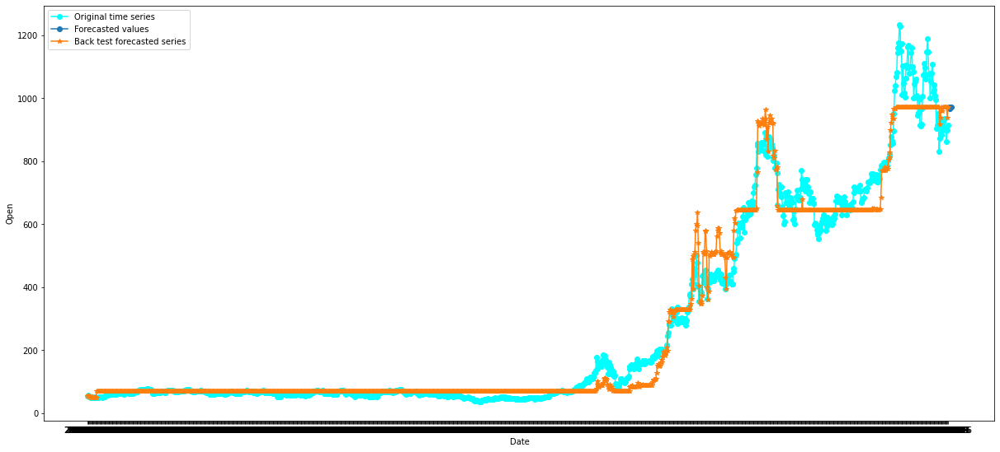

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


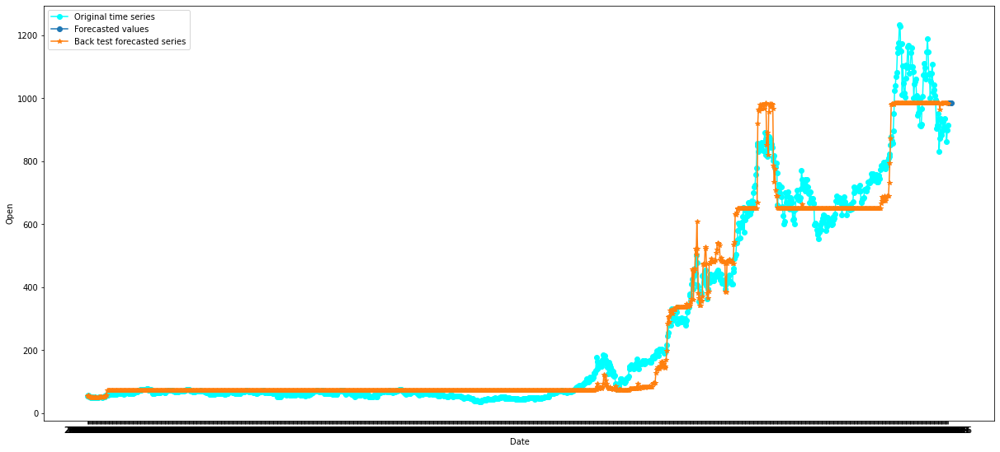

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Open ' series for patterns:
 **************************************************


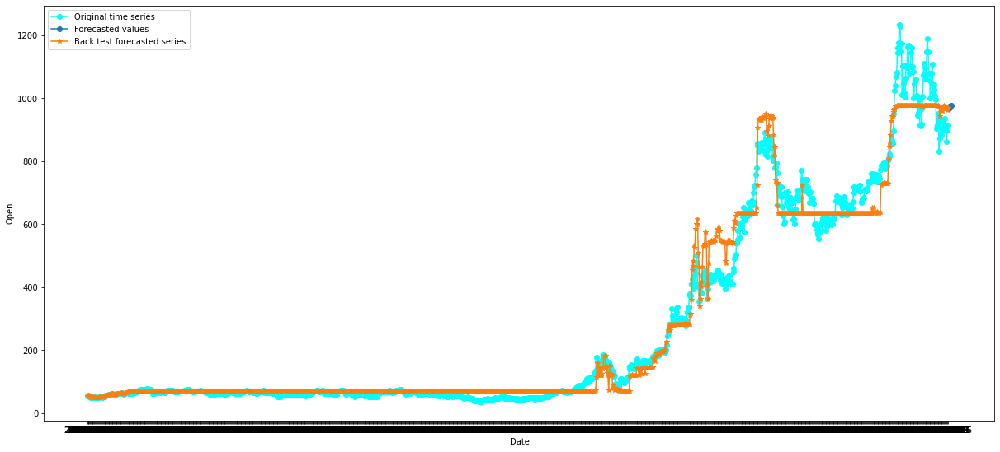

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.044e+05, tolerance: 9.764e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


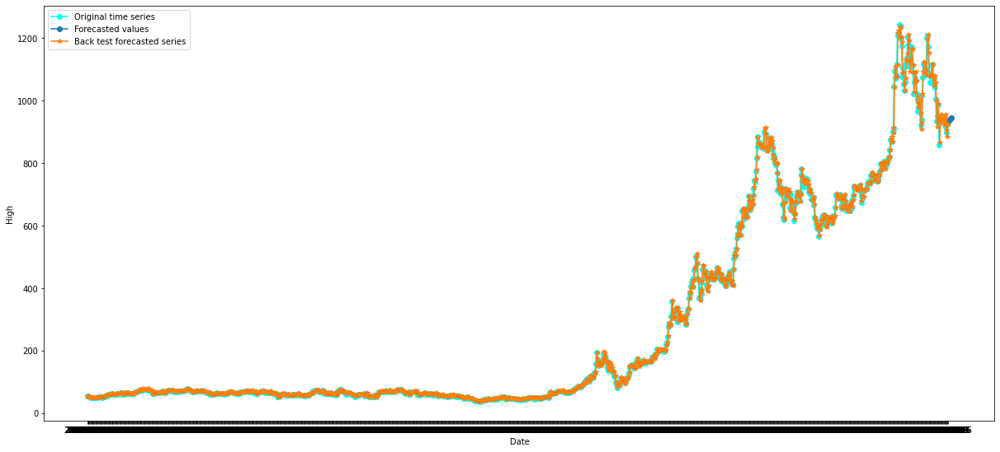

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.039e+05, tolerance: 1.016e+04
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


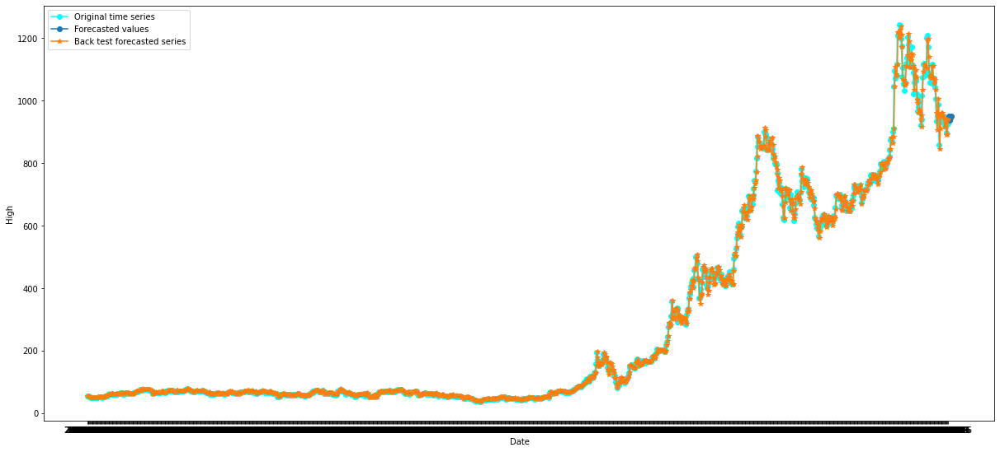

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' High ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.635e+04, tolerance: 9.855e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


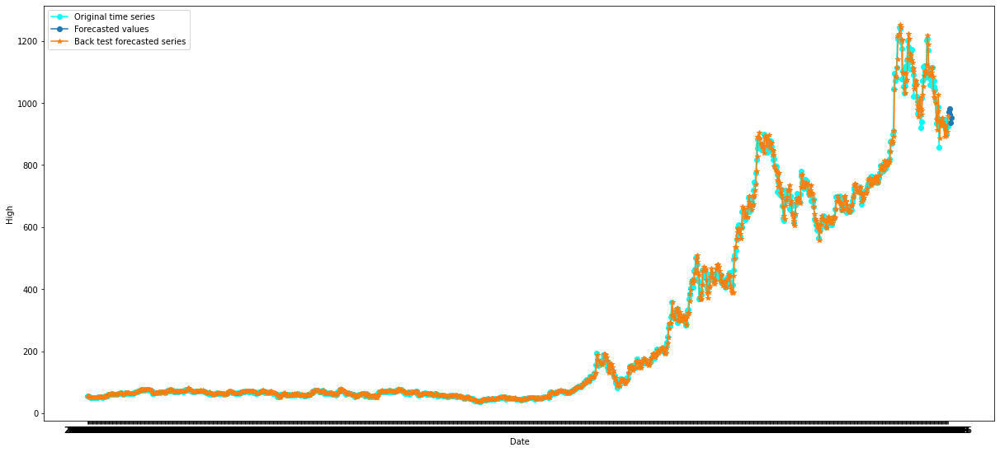

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


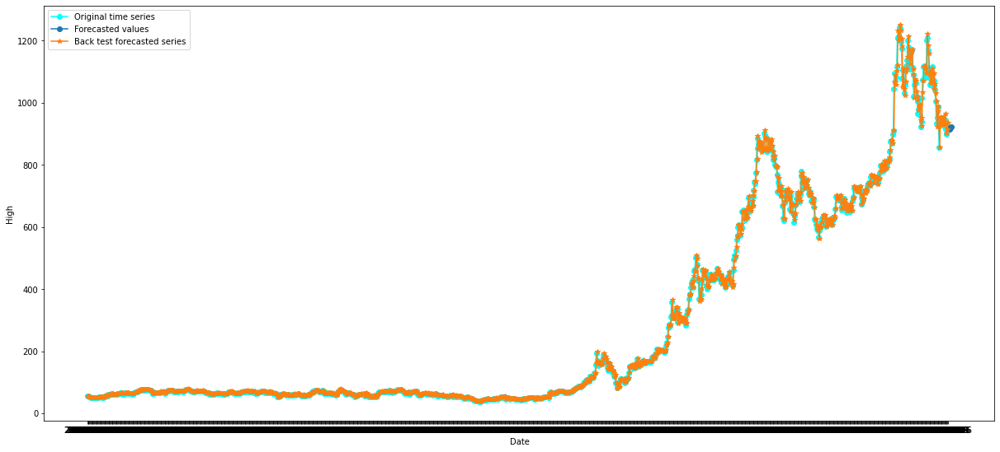

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


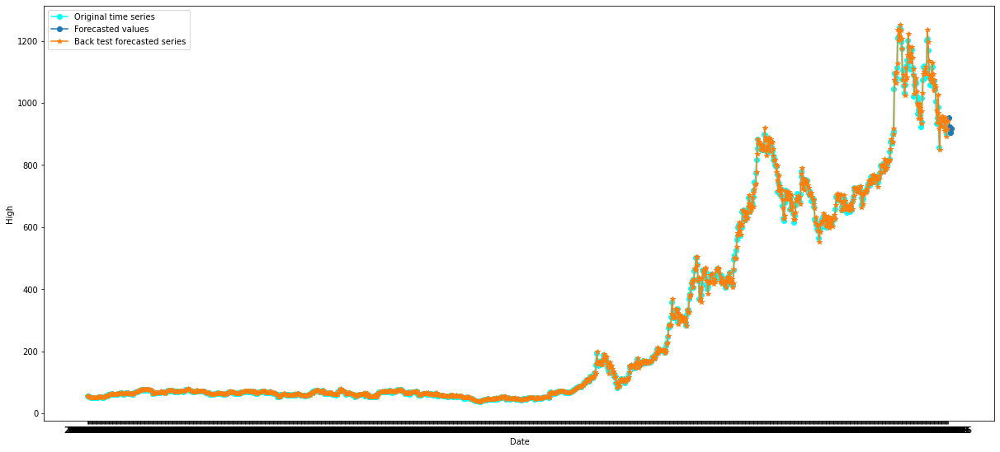

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' High ' series for patterns:
 **************************************************


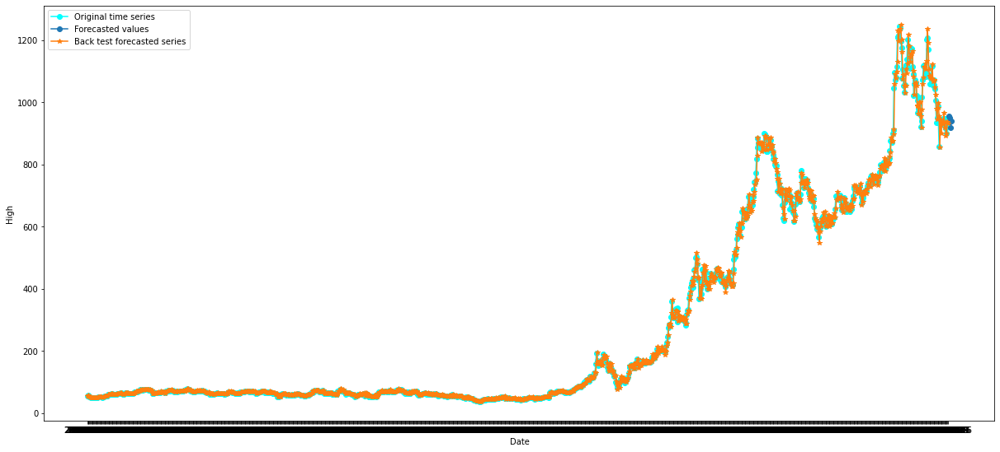

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


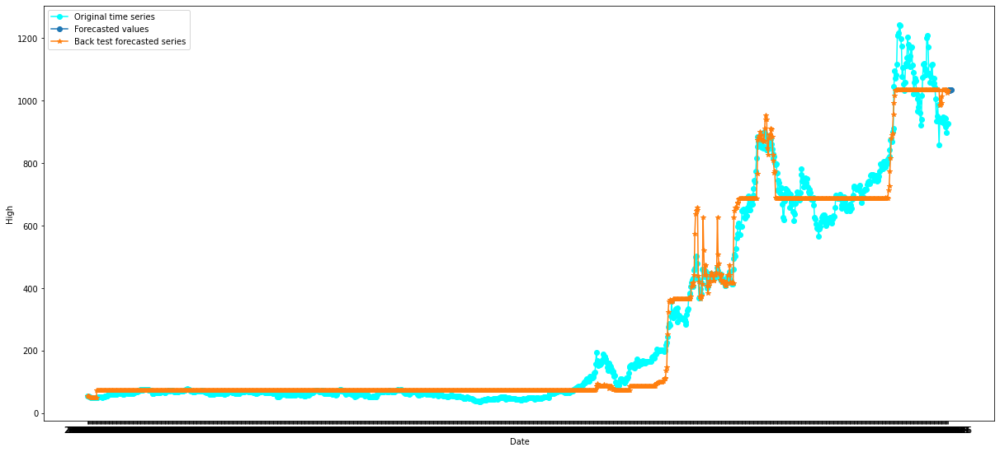

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


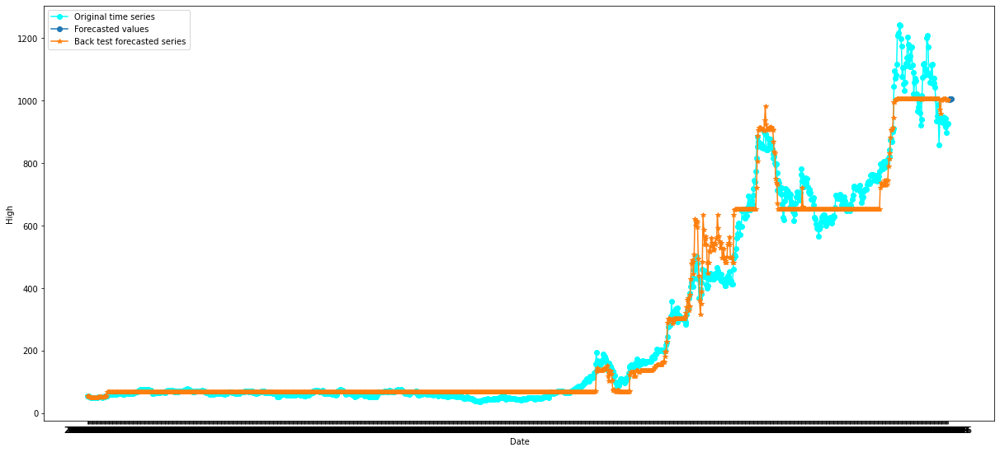

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' High ' series for patterns:
 **************************************************


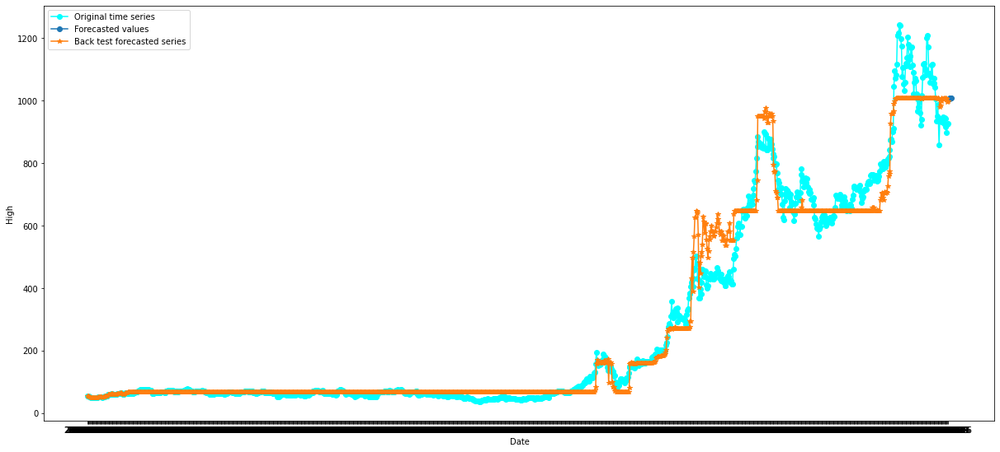

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.034e+05, tolerance: 8.935e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


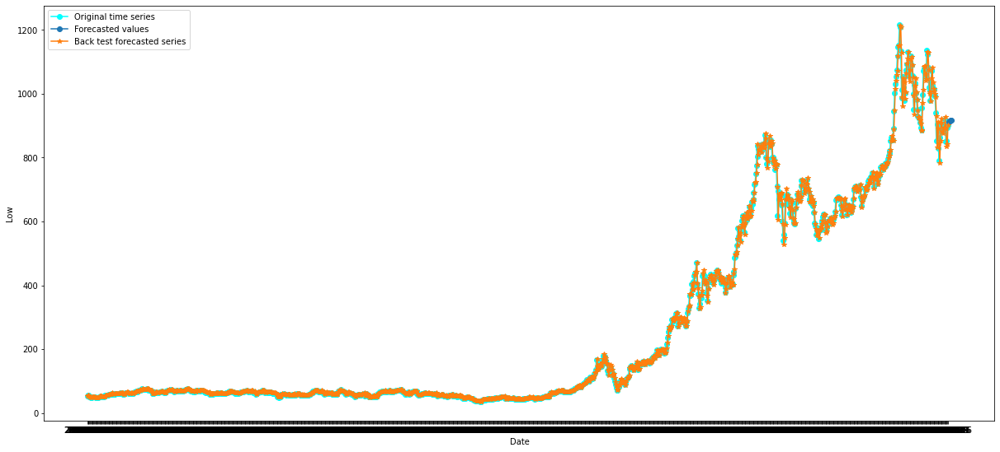

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.935e+04, tolerance: 8.761e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


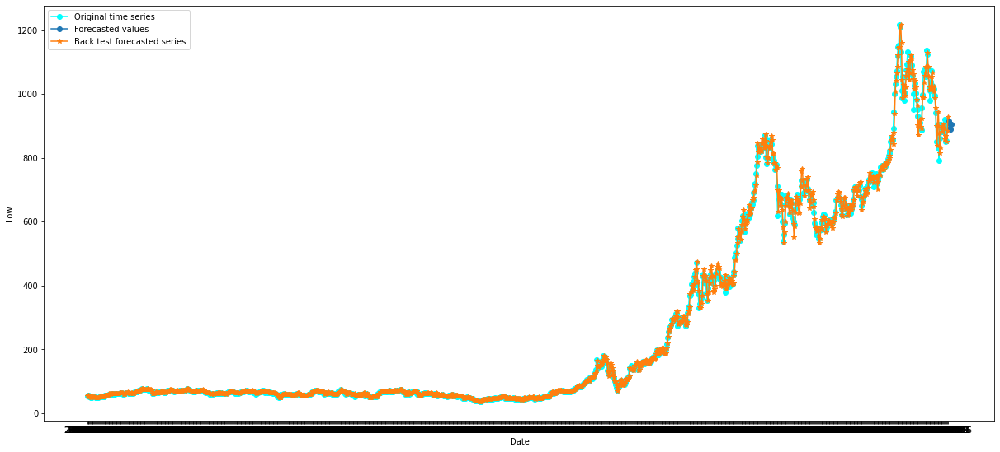

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Low ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.723e+04, tolerance: 8.679e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


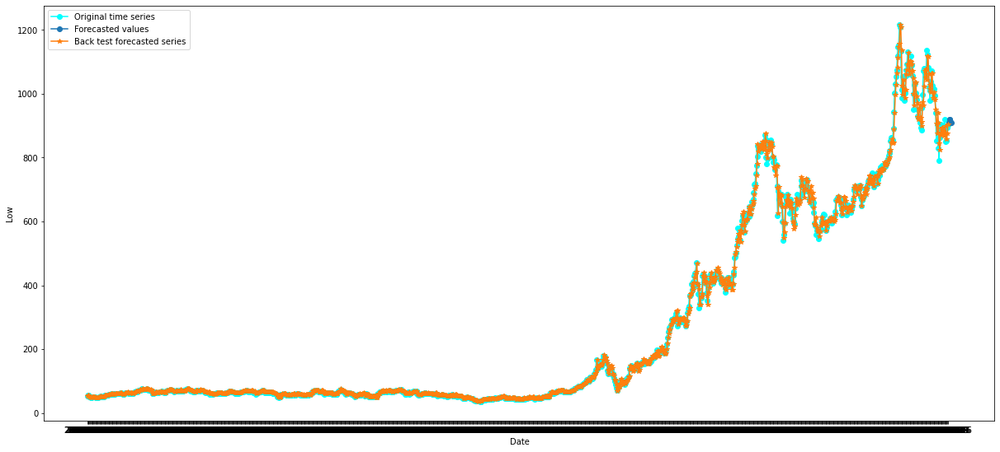

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


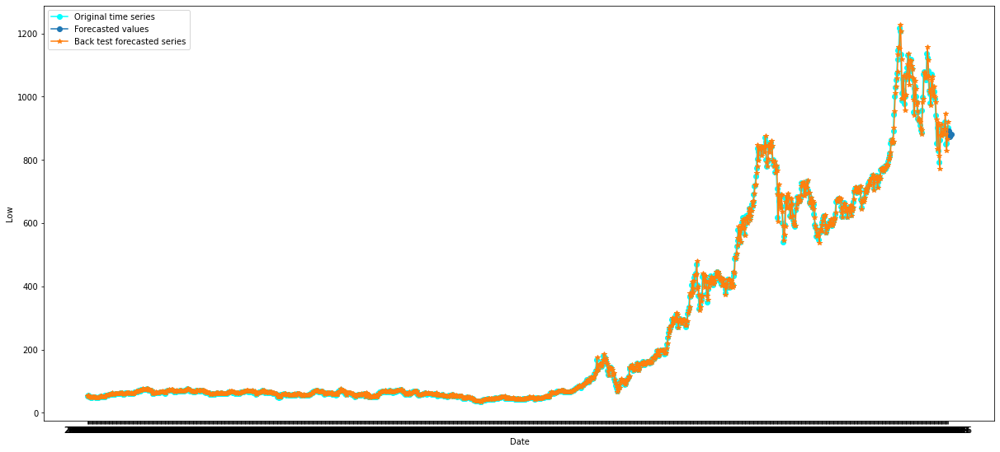

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


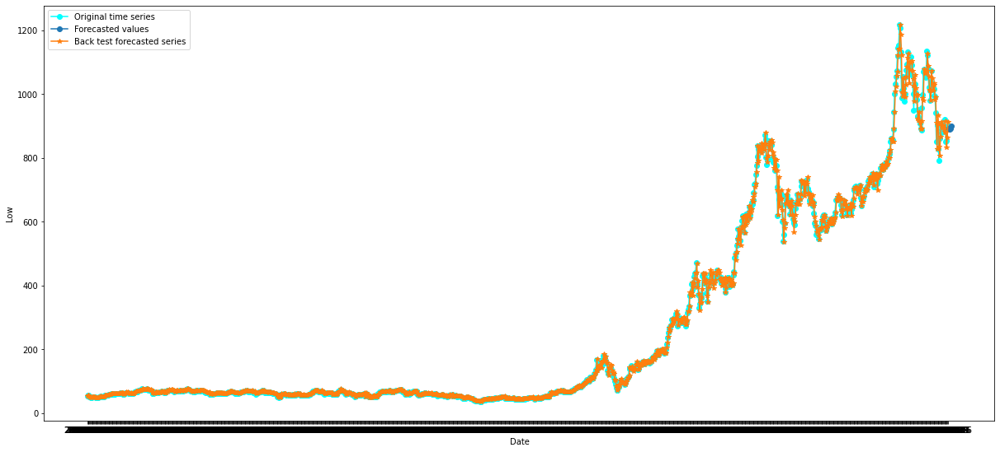

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Low ' series for patterns:
 **************************************************


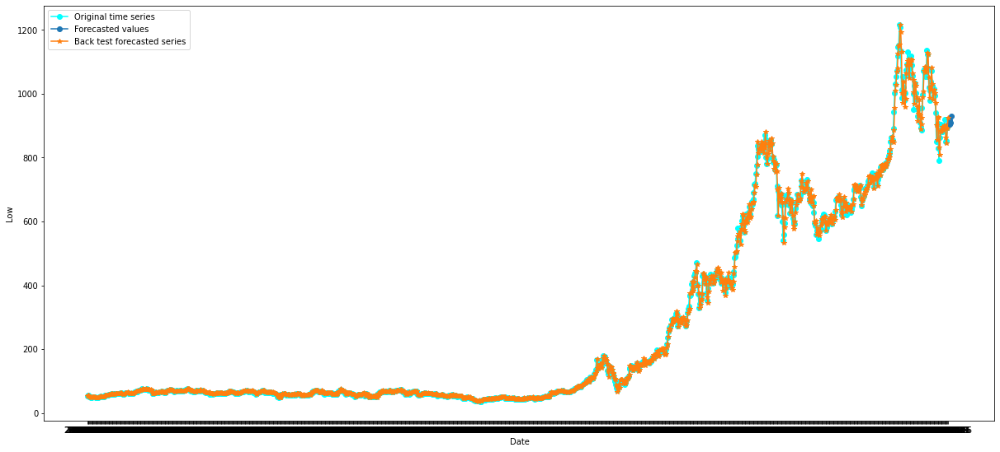

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


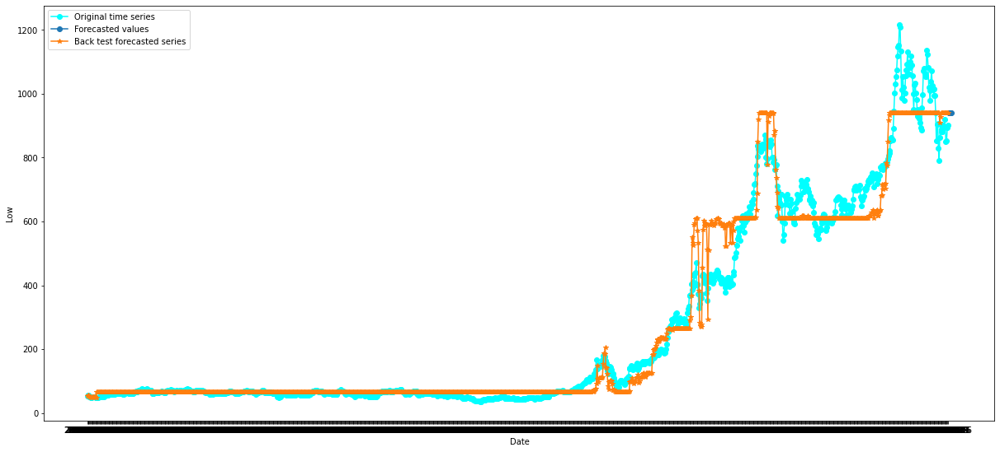

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


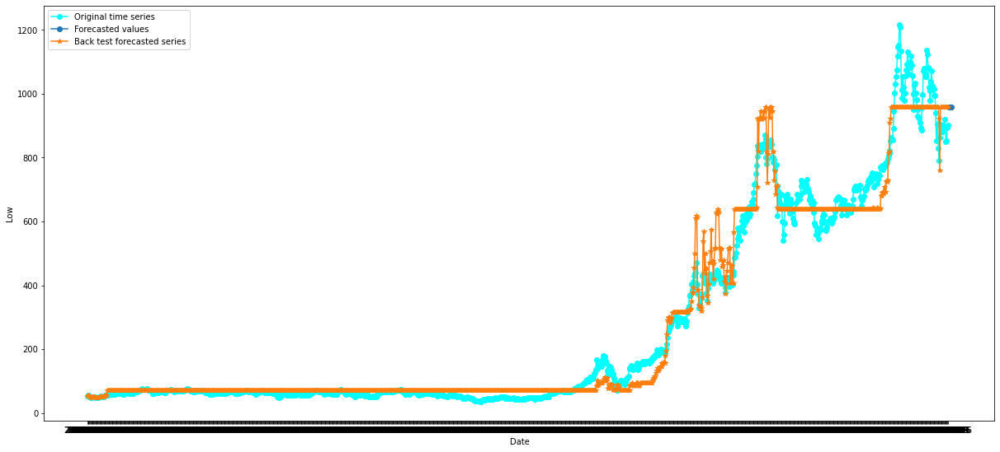

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Low ' series for patterns:
 **************************************************


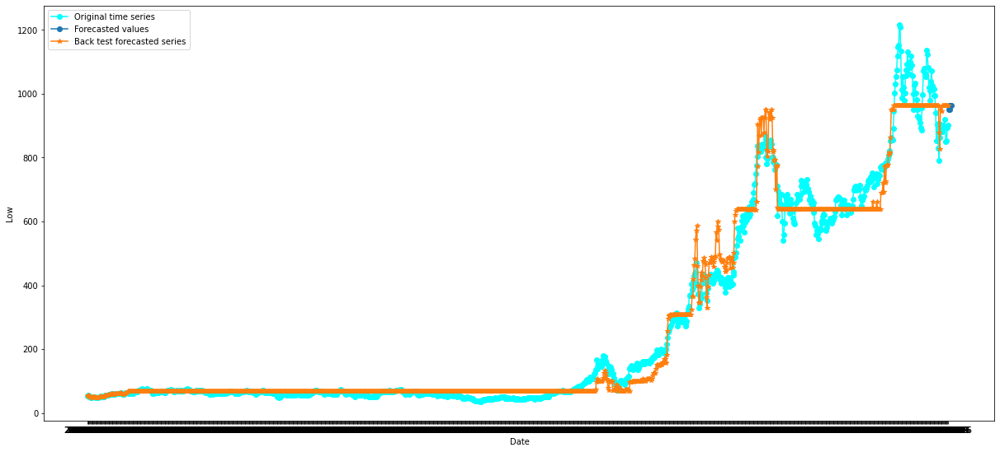

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.355e+05, tolerance: 9.698e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


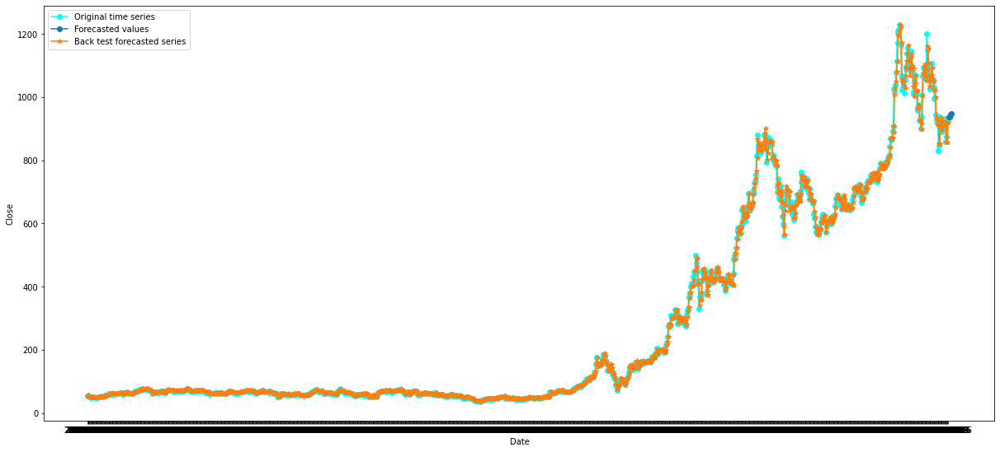

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.324e+05, tolerance: 9.166e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


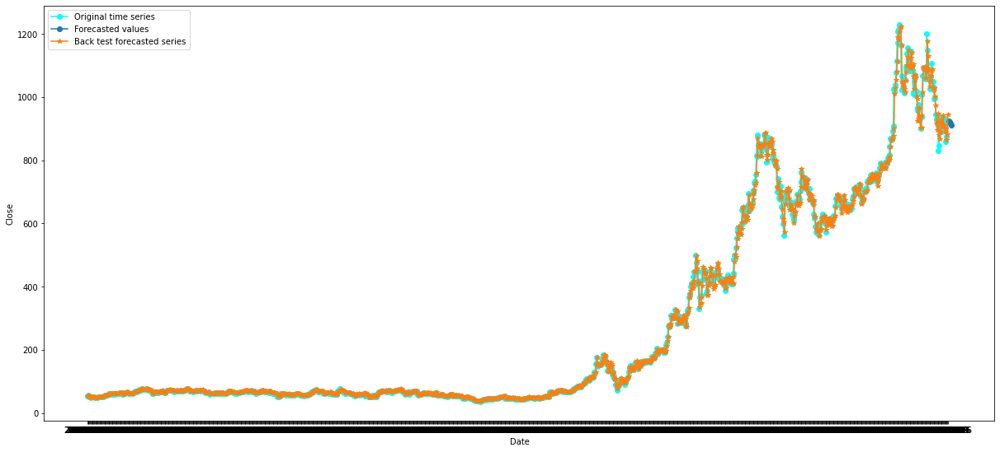

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.145e+05, tolerance: 9.423e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


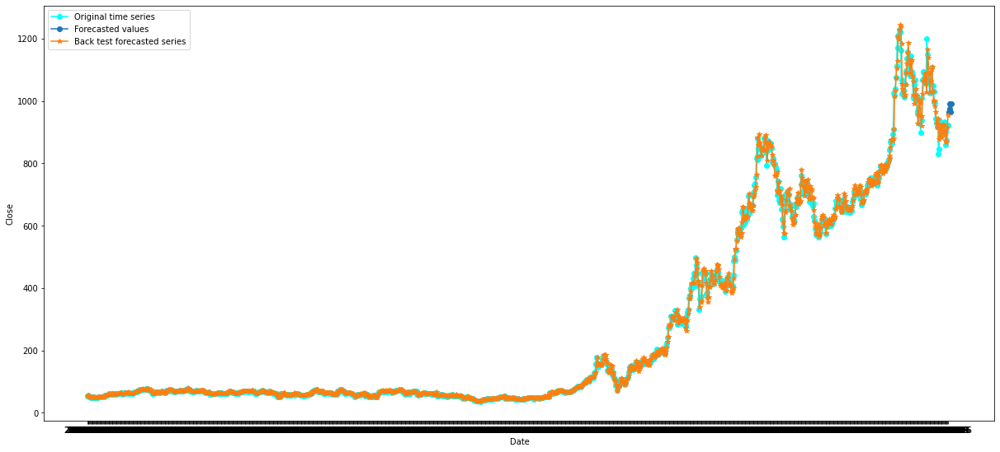

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


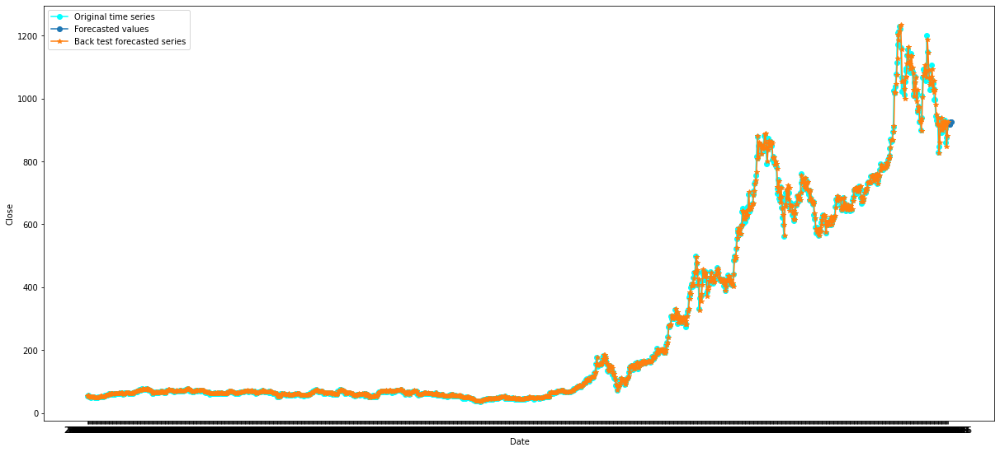

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


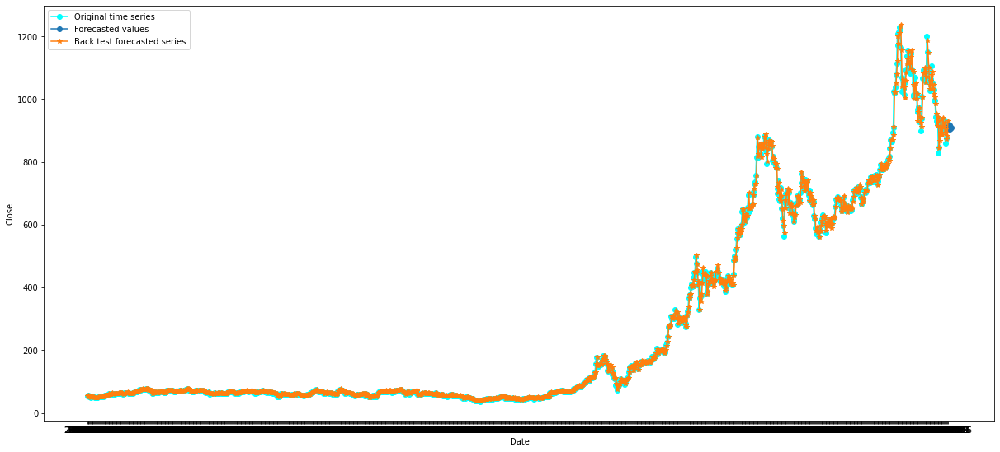

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Close ' series for patterns:
 **************************************************


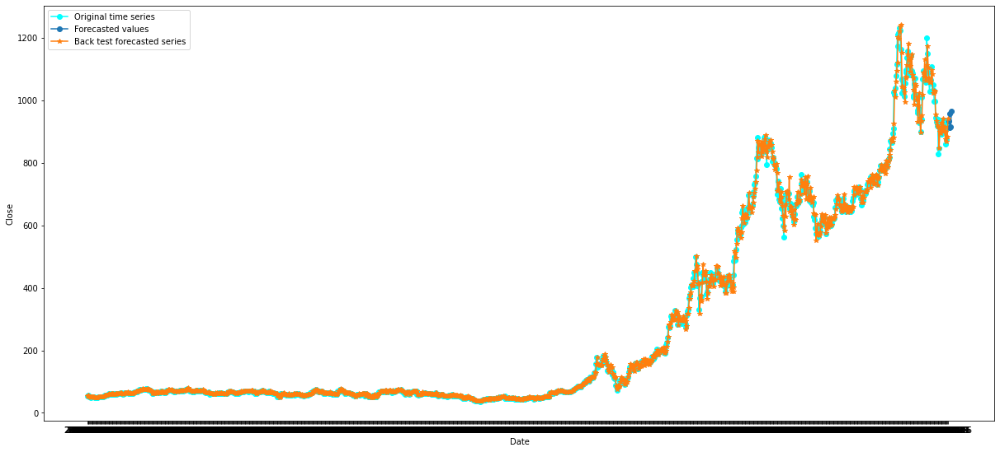

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


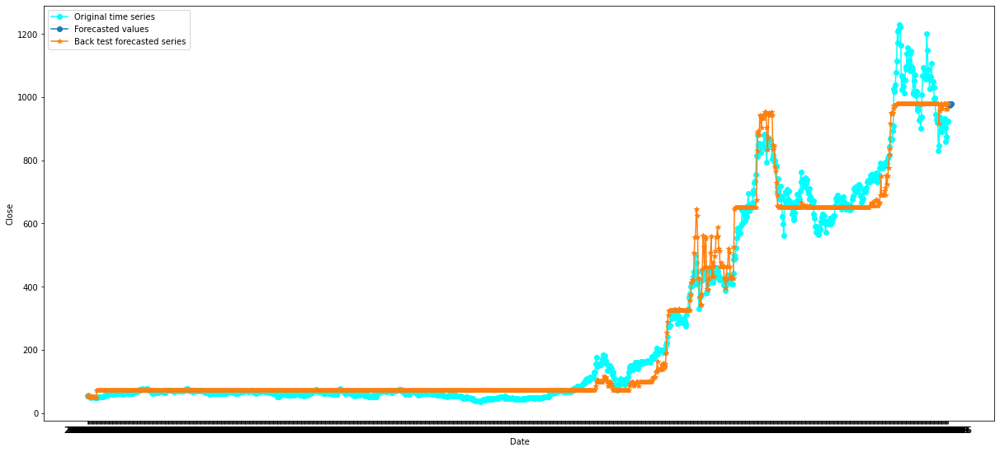

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


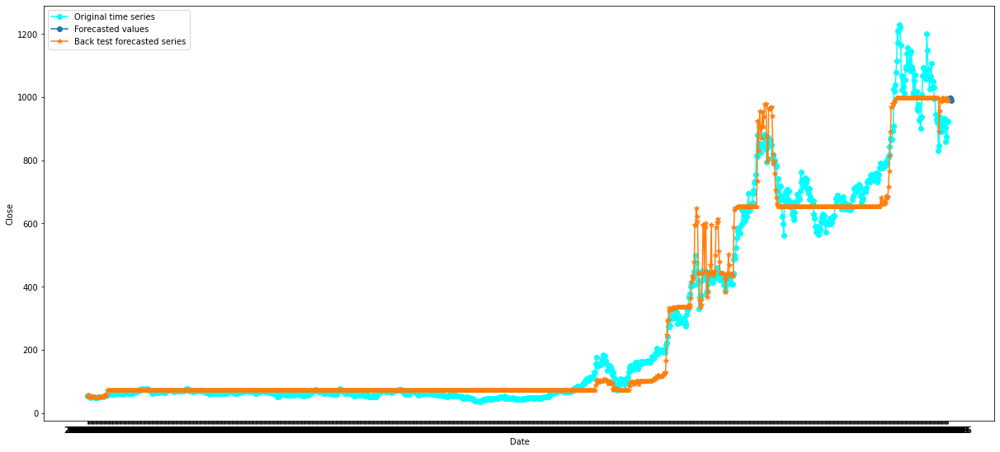

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Close ' series for patterns:
 **************************************************


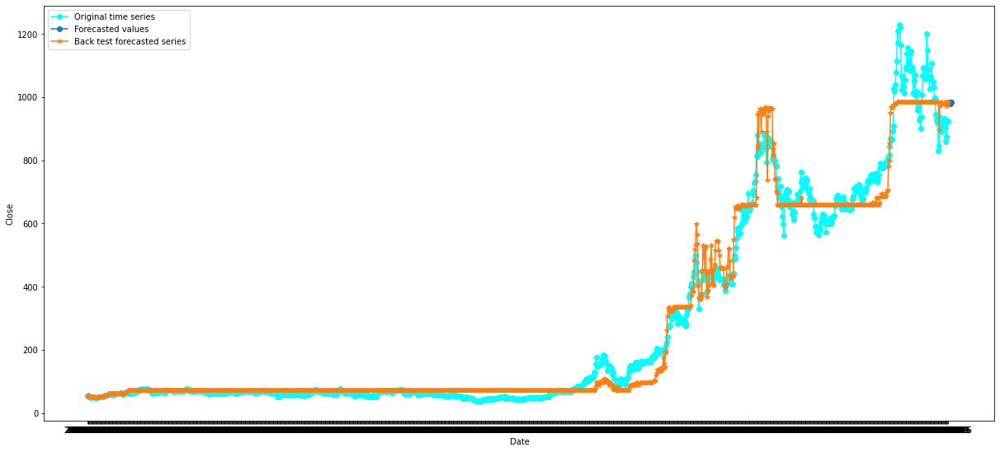

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.378e+05, tolerance: 9.546e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


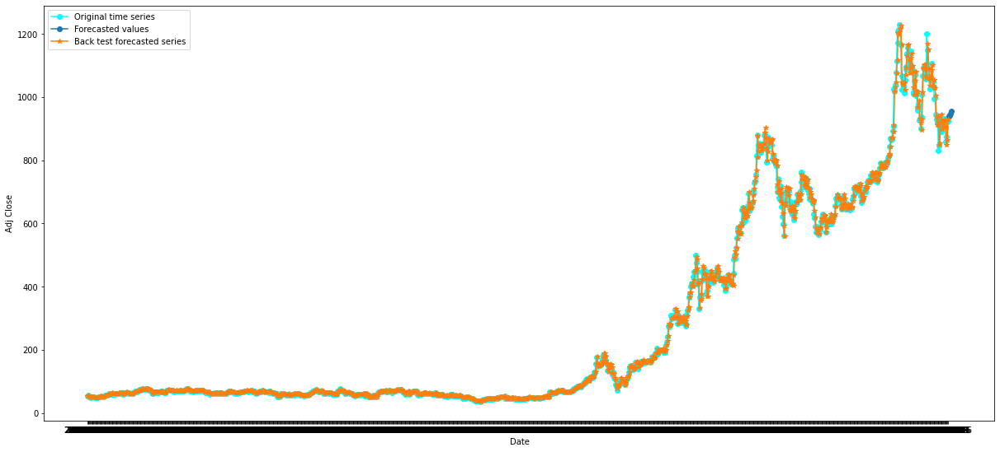

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.304e+05, tolerance: 9.179e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


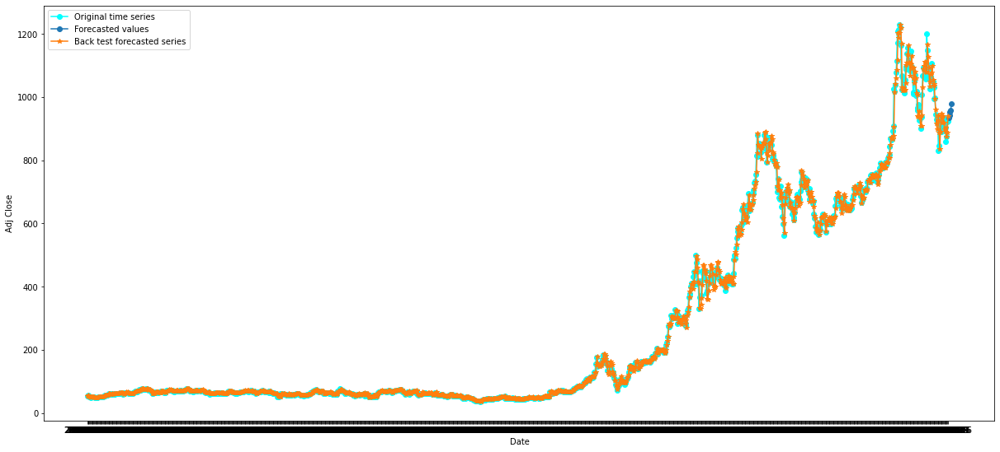

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Adj Close ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.221e+05, tolerance: 9.159e+03
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


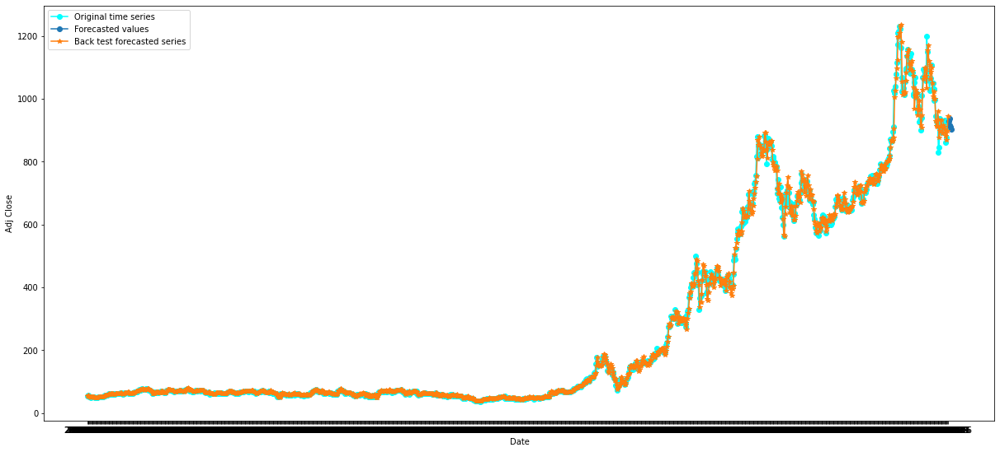

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


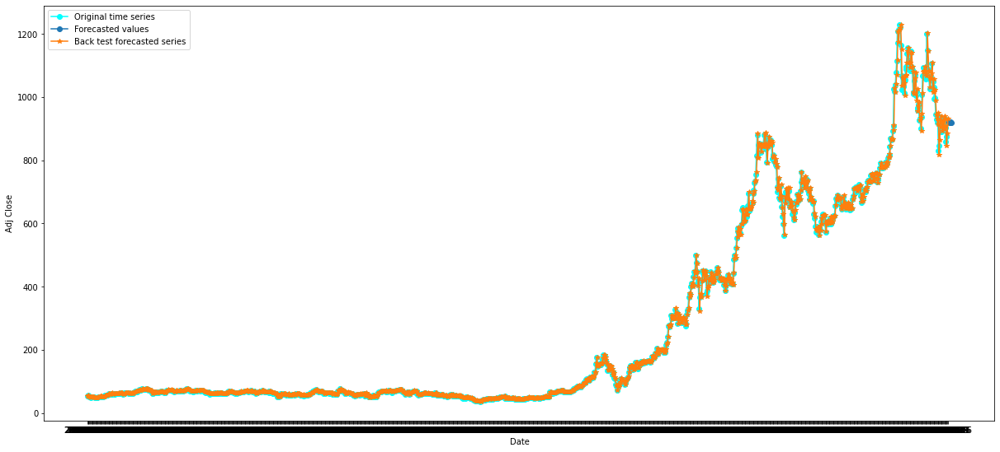

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


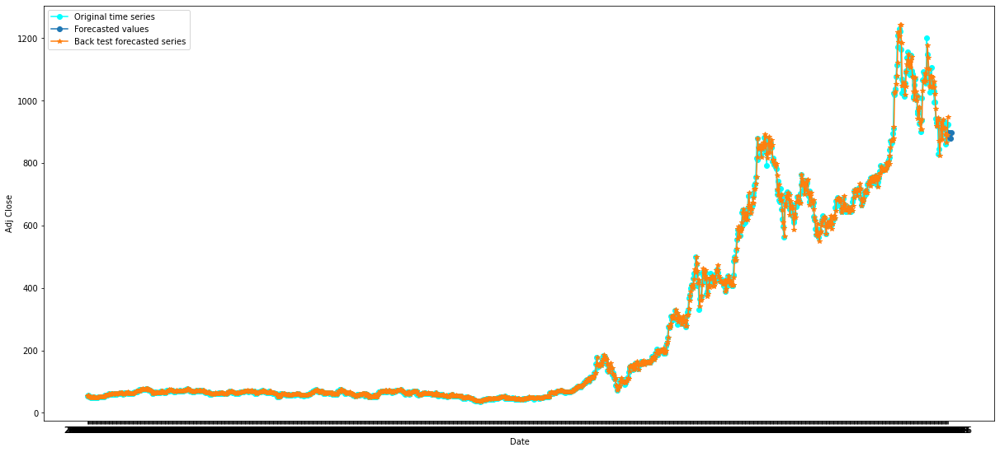

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Adj Close ' series for patterns:
 **************************************************


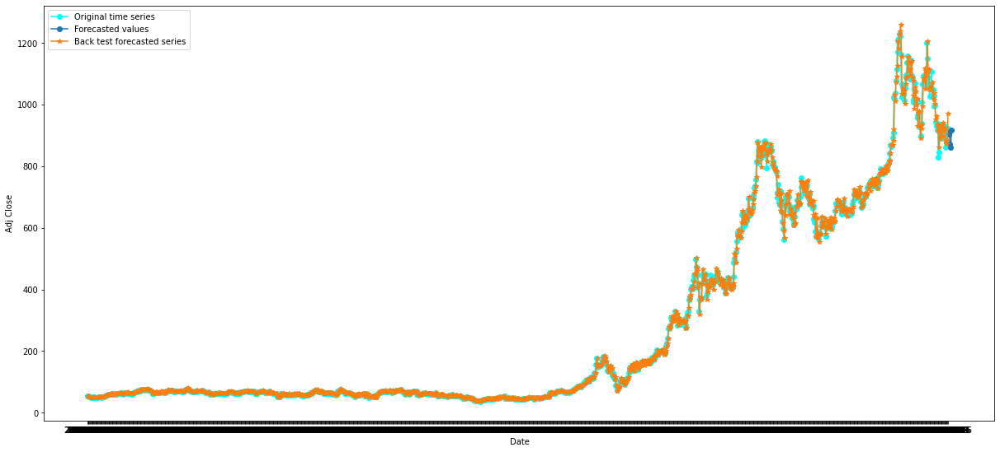

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


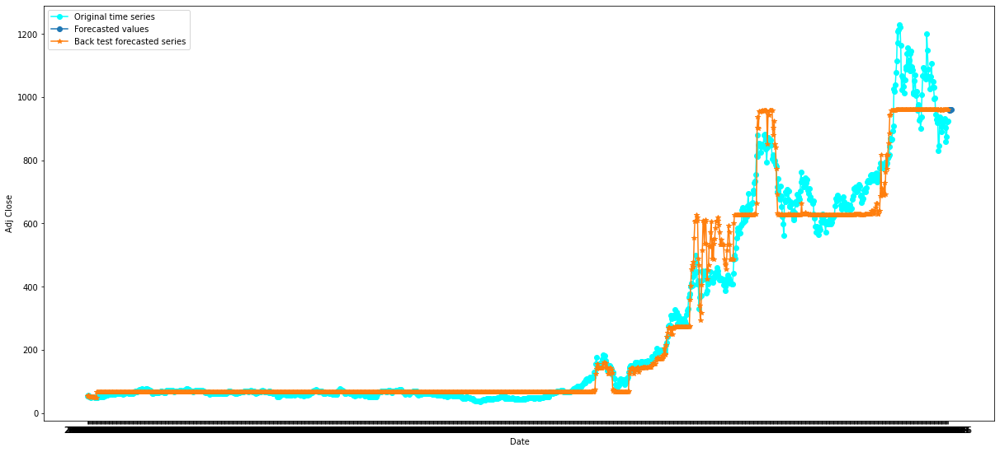

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


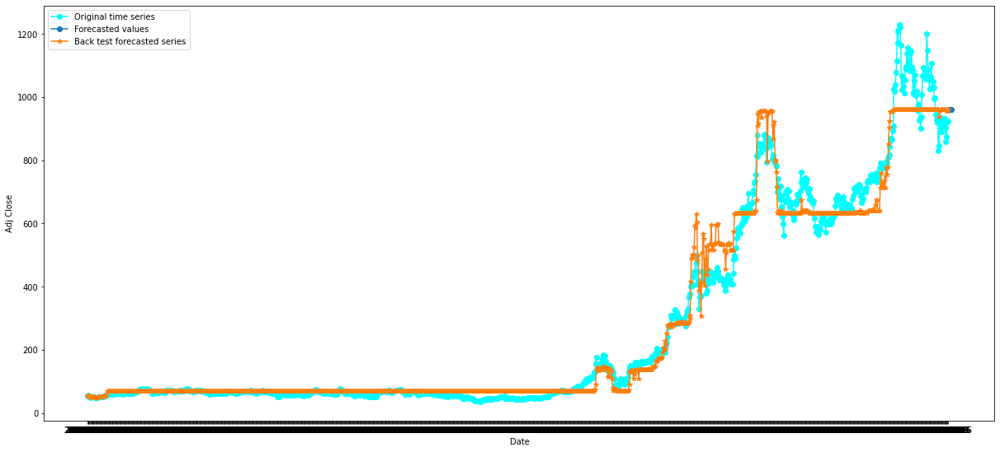

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Adj Close ' series for patterns:
 **************************************************


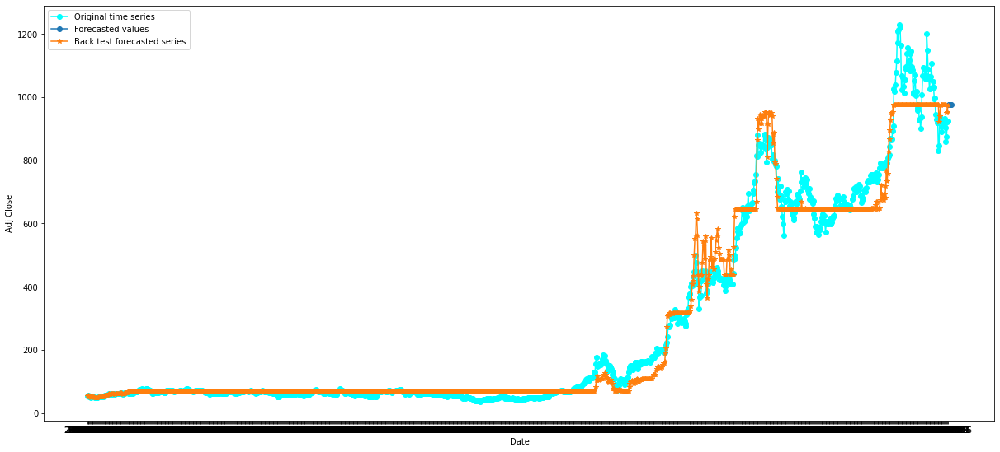

Finding and modelling the  15 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.280e+15, tolerance: 8.945e+13
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


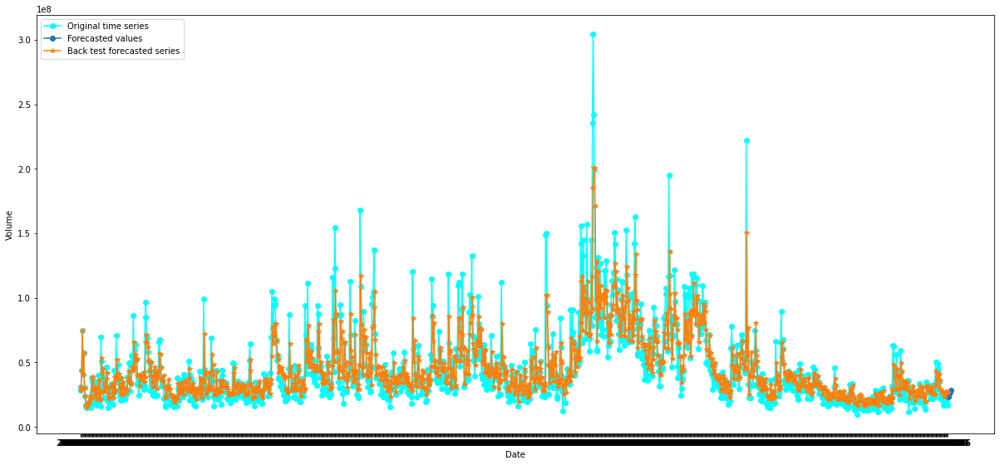

Finding and modelling the  30 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.325e+14, tolerance: 9.093e+13
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


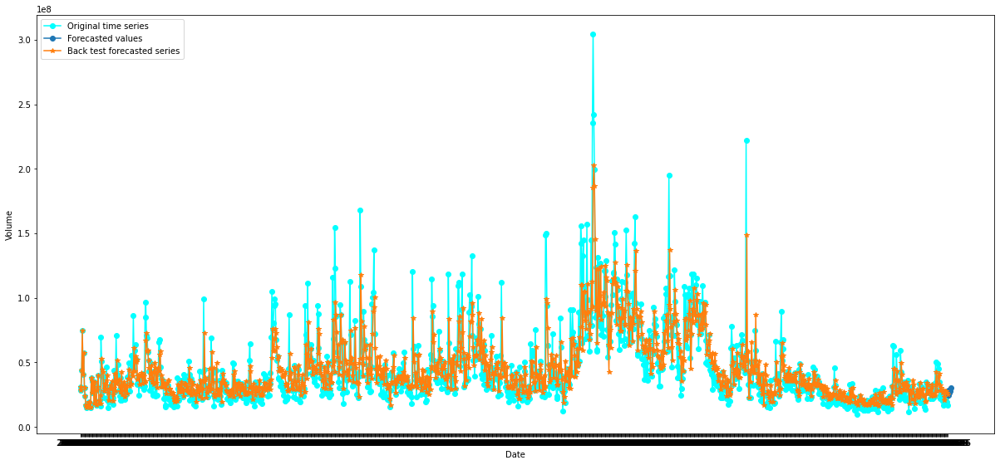

Finding and modelling the  60 -sized pattern in the series using  ElasticNet()
Looking into ' Volume ' series for patterns:
 **************************************************


/home/devendra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.337e+14, tolerance: 8.040e+13
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


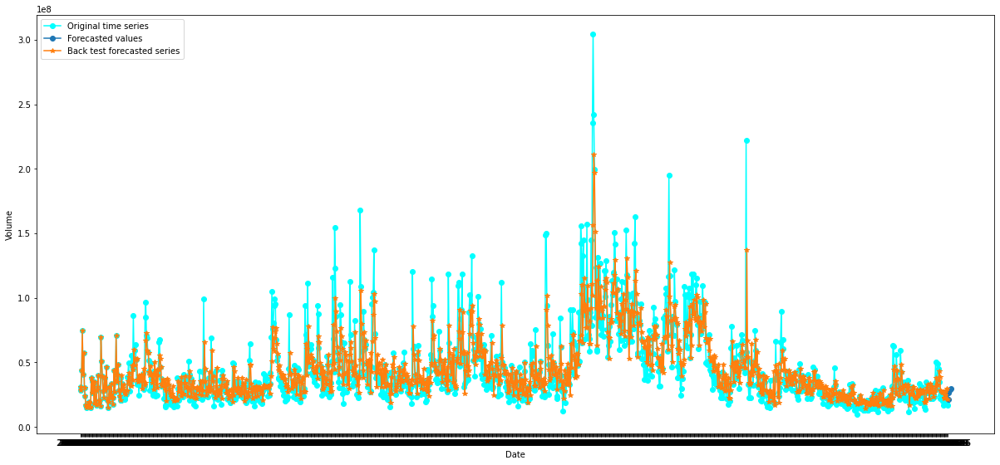

Finding and modelling the  15 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


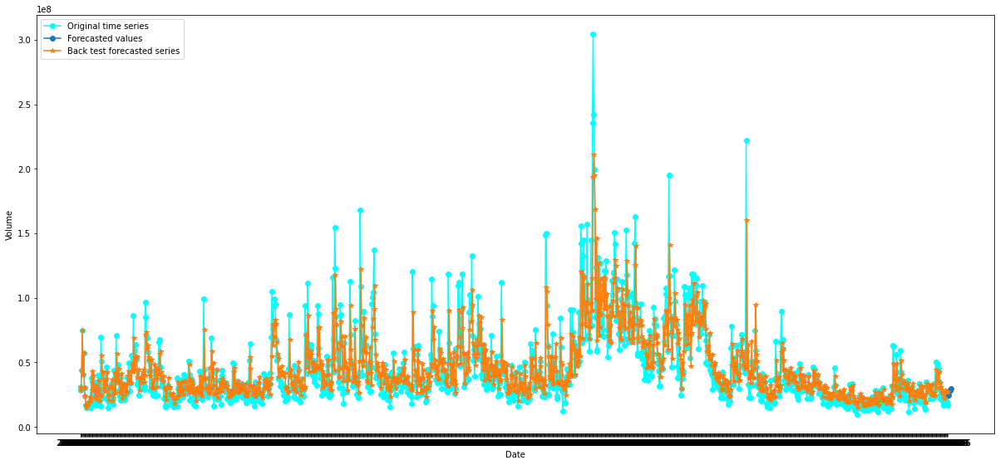

Finding and modelling the  30 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


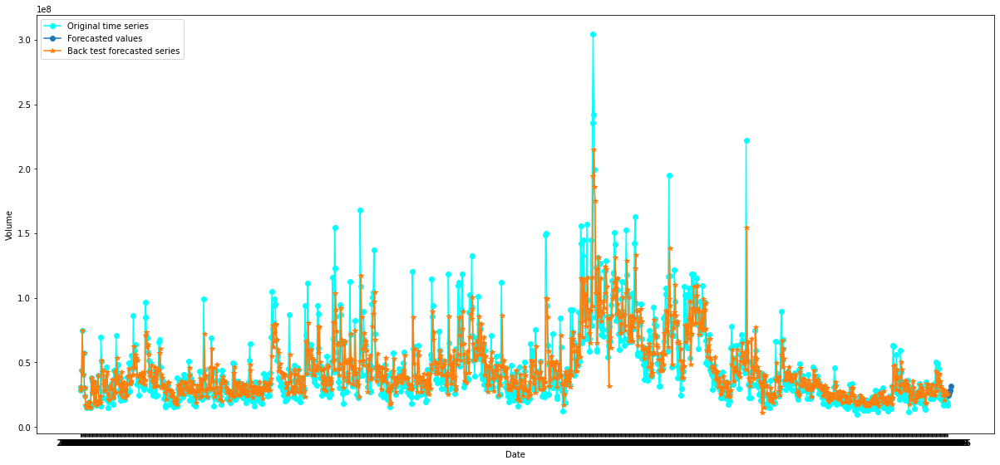

Finding and modelling the  60 -sized pattern in the series using  LinearRegression()
Looking into ' Volume ' series for patterns:
 **************************************************


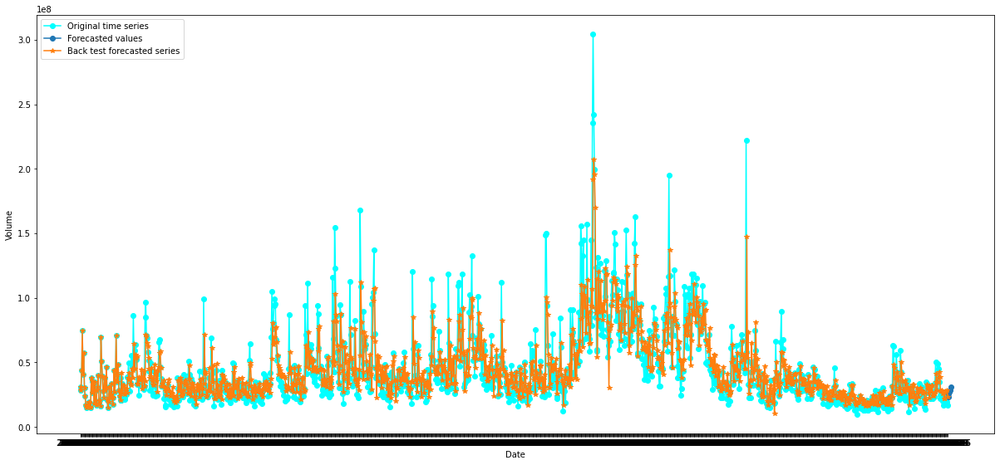

Finding and modelling the  15 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


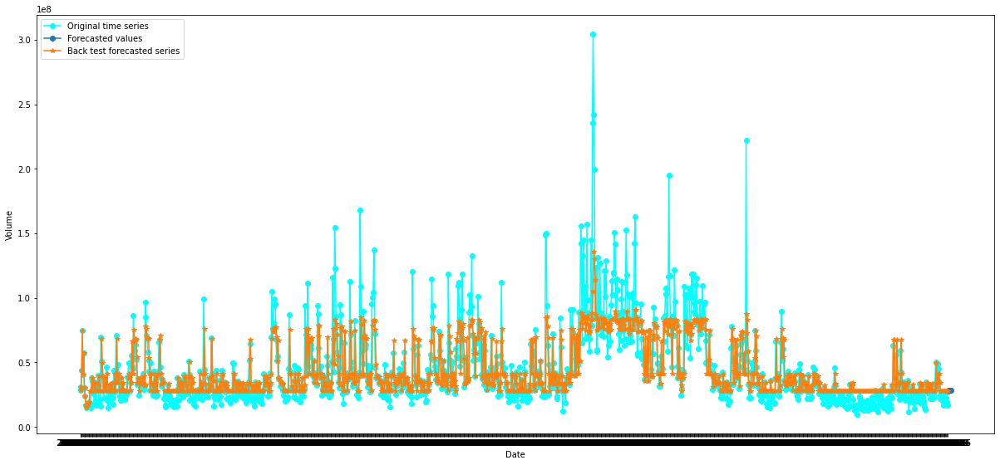

Finding and modelling the  30 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


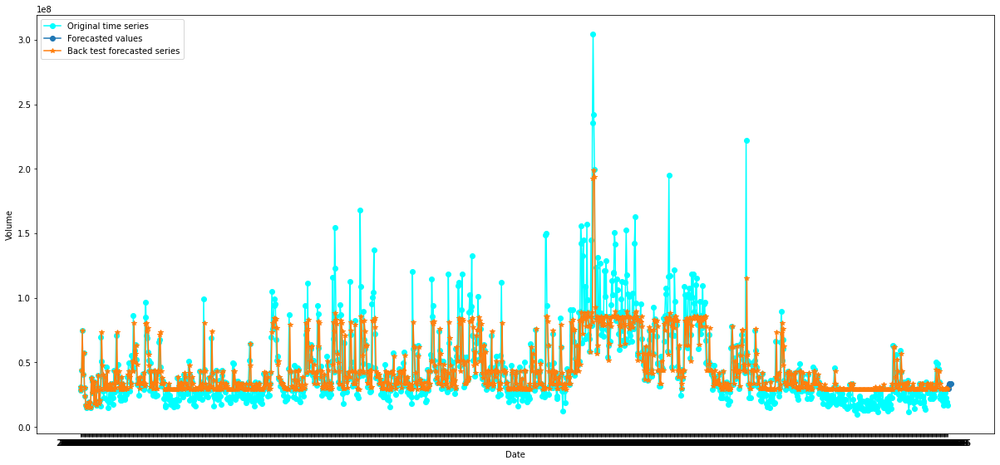

Finding and modelling the  60 -sized pattern in the series using  RandomForestRegressor(max_depth=2, random_state=0)
Looking into ' Volume ' series for patterns:
 **************************************************


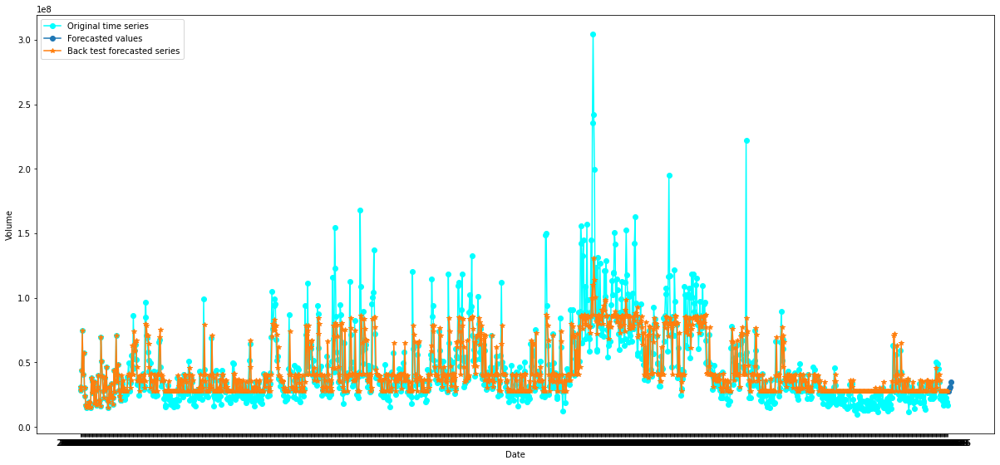

,Date,Open,High,Low,Close,Adj Close,Volume,15_day_model_for_Open_via_linear_model.ElasticNet,30_day_model_for_Open_via_linear_model.ElasticNet,60_day_model_for_Open_via_linear_model.ElasticNet,...,15_day_model_for_Volume_via_LinearRegression,30_day_model_for_Volume_via_LinearRegression,60_day_model_for_Volume_via_LinearRegression,15_day_model_for_Volume_via_RandomForestRegressor,30_day_model_for_Volume_via_RandomForestRegressor,60_day_model_for_Volume_via_RandomForestRegressor,Year,Month,day_of_month,company
0,2017-02-17,31.869070,32.153702,31.812143,31.897533,26.483664,36882306,31.869070,31.869070,31.869070,...,36882306.0,36882306.0,36882306.0,36882306.0,36882306.0,36882306.0,2017,2,17,Pfizer
1,2017-02-21,31.850096,32.068310,31.764706,31.897533,26.483664,25391598,31.850096,31.850096,31.850096,...,25391598.0,25391598.0,25391598.0,25391598.0,25391598.0,25391598.0,2017,2,21,Pfizer
2,2017-02-22,31.850096,32.020874,31.546490,31.869070,26.460030,28676494,31.850096,31.850096,31.850096,...,28676494.0,28676494.0,28676494.0,28676494.0,28676494.0,28676494.0,2017,2,22,Pfizer
3,2017-02-23,31.973434,32.371918,31.859583,32.314991,26.830271,32122863,31.973434,31.973434,31.973434,...,32122863.0,32122863.0,32122863.0,32122863.0,32122863.0,32122863.0,2017,2,23,Pfizer
4,2017-02-24,32.419353,32.590134,32.248577,32.504745,26.987816,26046448,32.419353,32.419353,32.419353,...,26046448.0,26046448.0,26046448.0,26046448.0,26046448.0,26046448.0,2017,2,24,Pfizer


In [10]:
# Modeling the pattern using various models

nof = 5 # Number of forecastes (Exta-polation) in forward direction
noa_list = [15,30,60] # list of number of values in series taken as attributes to model the trend 

#List of the models
prediction_model_list = [linear_model.ElasticNet(), LinearRegression(), RandomForestRegressor(max_depth=2, random_state=0)]
# list of the model names
prediction_model_names=["linear_model.ElasticNet", "LinearRegression", "RandomForestRegressor"]

#List which will contain the new columns generated by the back-testing of the models 
column_names_generated = []
# Names of the datafiles along with the address
datafiles = ["PFE.csv","SPOT.csv","TSLA.csv"]
# names of the company names corresponding to the data files
company_names = ["Pfizer", "Spotify", "Tesla"]

# Temporary list which will assist in concatenation of the processed dataframes corresponding to each data file 
dataframes =[]

# An iterator to access the name of the company in the loop
index = 0

for file in datafiles:
    df = pd.read_csv(file)
    print("Working on ",file, " dataset")
    
    for col in df.columns.to_list():
        if col == "Date":
            pass    
        else:
            for k in range(len(prediction_model_list)): # iterating on the model for forecasting
                
                prediction_model = prediction_model_list[k]
                
                for l in range(len(noa_list)): # iterating on the number of attributes
                    
                    noa = noa_list[l]
                    # some verbos
                    print("Finding and modelling the ",noa,"-sized pattern in the series using ",prediction_model)
                    print("Looking into '",col,"' series for patterns:\n","*"*50)
                    
                    # name for the new column which will be inserted in the dataframe
                    column_name = str(noa)+"_day_model_for_"+col+"_via_"+prediction_model_names[k]
                    column_names_generated.append(column_name)
                    data = df[[col,"Date"]].dropna(axis = 0)
                    date_list = data["Date"].to_list()
                    
                    # training the model
                    forcasted, trained_model = train_and_forecast(data[col].to_list(), prediction_model, number_of_forecast = nof, number_of_attributes = noa)
                    # using the trained model to back_test
                    back_forecast = back_test(data[col].to_list(), trained_model, noa)
                    
                    # inserting the new backtested values on the datafram
                    df[column_name] = back_forecast 
                    ori_date_list = date_list.copy()
                    
                    # Ploting the backtest generated values on the actual values of the attribute
                    U = data[col].to_list()
                    forca_date = []
                    d = 0
                    for i in forcasted:
                        d = d+1
                        date_temp = dateutil.parser.parse(date_list[-1]).date()
                        date_temp = date_temp + timedelta(days = d)
                        date_temp = date_temp.strftime('%y-%m-%d')
                        forca_date.append(date_temp)

                    fig = plt.figure(figsize =(16, 7))
                    ax = fig.add_axes([0,0,1,1])


                    ax.plot(date_list, U,'-o',color='cyan', label = "Original time series")
                    ax.plot(forca_date, forcasted,'-o', label = "Forecasted values")
                    ax.plot(ori_date_list, back_forecast,'-*', label = "Back test forecasted series")
                    ax.legend(loc="upper left")

                    ax.set_ylabel(col)
                    ax.set_xlabel("Date")
                    ax.set_xticks(date_list)
                    ax.set_xticklabels(date_list)

                    plt.show()
                    # end of the plot
                    
    # Generating the day, month  and year as new columns
    df["Date"] = df["Date"].apply(lambda x : dateutil.parser.parse(x).date())
    df["Year"] = df["Date"].apply(lambda x: x.year)
    df["Month"] = df["Date"].apply(lambda x: x.month)
    df["day_of_month"] = df["Date"].apply(lambda x: x.day)
    df["company"] = company_names[index]
    index = index+1
    dataframes.append(df)
    
# Mearging the processed dataframes generated by the datafiles
df=pd.concat(dataframes)
df.head()

In [11]:
# Initialisation for the dashboard
pn.extension('tabulator', sizing_mode = "stretch_width")
hv.extension("boken")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [12]:
def environment():
    try:
        get_ipython()
        return "notebook"
    except:
        return "server"
environment()

'notebook'

In [13]:
idf = df.interactive()

In [14]:
# Initializing the widgets
year = pn.widgets.IntSlider(name='Year', start=2018, end=2022, step=1)
month = pn.widgets.IntSlider(name='Month', start=1, end=12, step=1)

company = pn.widgets.ToggleGroup(
    name='COMP',
    options=['Tesla', 'Pfizer', 'Spotify'], 
    value=['Tesla', 'Pfizer', 'Spotify'],
    button_type='success')

yaxis =pn.widgets.Select(
    name='Y axis', 
    options=["Open","High","Low","Close","Adj Close","Volume"]+column_names_generated,
    button_type='success'
)



In [15]:
# creating pipeline to give data to dashboard dynamically
ipipeline = (
    idf[
        (idf.Year == year) &
        (idf.Month == month) &
        (idf.company.isin(company))
    ]
    .groupby(['company',"day_of_month"])[yaxis].mean()
    .to_frame()
    .reset_index()
    
    .reset_index(drop=True)
)
ipipeline.head()

In [16]:
if environment()=="server":
   theme="fast"
else:
   theme="simple"

In [17]:
itable = ipipeline.pipe(pn.widgets.Tabulator, pagination='remote', page_size=8, theme=theme)
itable

In [18]:
# making the color profile for the dashboard
PALETTE = ["#ff6f69", "#ffcc5c", "#88d8b0", ]
pn.Row(
    pn.layout.HSpacer(height=50, background=PALETTE[0]),
    pn.layout.HSpacer(height=50, background=PALETTE[1]),
    pn.layout.HSpacer(height=50, background=PALETTE[2]),
)


Row(sizing_mode='stretch_width')
    [0] HSpacer(background='#ff6f69', height=50)
    [1] HSpacer(background='#ffcc5c', height=50)
    [2] HSpacer(background='#88d8b0', height=50)


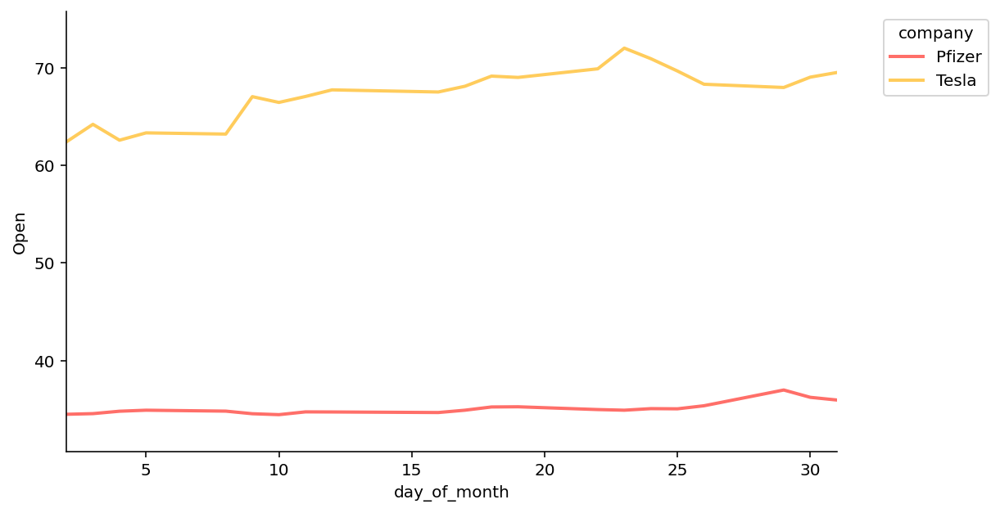

In [19]:
ihvplot = ipipeline.hvplot(x='day_of_month', y=yaxis, by='company', color=PALETTE, line_width=4, height=400)

ihvplot

In [20]:
# Show the dashboad
template = pn.template.FastListTemplate(
    title='Interactive Dashboard for stocks', 
    sidebar=[year, month, 'Company', company, 'Stock Attributes' , yaxis],
    main=[ihvplot.panel(), itable.panel()],
    accent_base_color="#88d8b0",
    header_background="#88d8b0",
)
template.show()

Launching server at http://localhost:46579
